In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys 
sys.path.append("/n/home12/binxuwang/Github/DiffusionReasoning")
from tensorboard_utils import extract_all_runs, extract_tensorboard_data_from_run, extract_last_step_summary

In [3]:
import os
import numpy as np
import pandas as pd
import torch
from os.path import join
import pickle as pkl
import seaborn as sns
import matplotlib.pyplot as plt
from tqdm.autonotebook import trange, tqdm

/tmp/ipykernel_1068753/464873755.py:9: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import trange, tqdm


### Paths

In [4]:
tabdir = "/n/home12/binxuwang/Github/DiffusionReasoning/Tables"
figdir = "/n/home12/binxuwang/Github/DiffusionReasoning/Figures_newrule"

GPT_exproot = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/GPT2_raven"
DiT_exproot = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiT/results"
SSM_exproot = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/Mamba_raven"
EDM_exproot = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/mini_edm/exps"

In [5]:
figroot = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning"
GPTfigdir = join(figroot, "GPT2_raven")
EDMfigdir = join(figroot, "EDM_raven")
DiTfigdir = join(figroot, "DiT_raven")
SSMfigdir = join(figroot, "SSM_raven")

In [6]:
import pandas as pd

# Set the maximum column width to 100 characters
pd.set_option('display.max_colwidth', 100)

In [6]:
!mkdir  /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/GPT2_raven
!mkdir  /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/EDM_raven
!mkdir  /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/DiT_raven
!mkdir  /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/SSM_raven

mkdir: cannot create directory ‘/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/GPT2_raven’: File exists
mkdir: cannot create directory ‘/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/EDM_raven’: File exists
mkdir: cannot create directory ‘/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/DiT_raven’: File exists
mkdir: cannot create directory ‘/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Figures/DiffusionReasoning/SSM_raven’: File exists


### Rule learning dynamics function

Function to parse the experiment string

In [18]:
import re
def extract_and_convert(string):
    # Pattern to match the "0_16" part and convert to float 0.16
    match1 = re.search(r'stream(\d+)_(\d+)', string)
    if match1:
        num1 = int(match1.group(1))
        num2 = int(match1.group(2))
        result = float(f"{num1}.{num2}")
        return result
    
    # Pattern to match the "16M" part and convert to integer 16
    match2 = re.search(r'stream(\d+)M', string)
    if match2:
        result = int(match2.group(1))
        return result
    
    return None

Functions to load the samples and eval stats, plot the data

In [7]:
def sweep_collect_eval_data(expname, exproot, prefix=None):
    assert os.path.exists(join(exproot, expname, "samples")), expname  
    # print(sorted(os.listdir(join(exproot, expname, "samples"))))
    print(f"Extracted data from {join(exproot, expname, 'samples')}")
    print(f"example file:", os.listdir(join(exproot, expname, 'samples'))[0])
    # for files with names like 'sample_rule_eval_995000.pt' find the one with largest number
    epoch_nums = sorted([int(f.split(prefix)[-1].split(".pt")[0]) for f in os.listdir(join(exproot, expname,'samples')) if prefix in f])
    eval_col = {}
    for epoch_num in tqdm(epoch_nums):
        samples_eval = torch.load(join(exproot, expname, 'samples', f"{prefix}{epoch_num}.pt"))
        eval_col[epoch_num] = samples_eval
    return eval_col

In [8]:
def extract_rule_list_from_eval_col(eval_col, is_abinit = False):
    epoch_list = sorted(list(eval_col.keys()))
    rule_list_all = []
    consistency_all = []
    for epoch in eval_col.keys():
        if is_abinit:
            rule_list_all.append(eval_col[epoch]['rule_col_list_abinit'])
            consistency_all.append((eval_col[epoch]['C3_list_abinit'], eval_col[epoch]['C2_list_abinit']))
        else:
            rule_list_all.append(eval_col[epoch]['rule_col_list'])
            consistency_all.append((eval_col[epoch]['C3_list'], eval_col[epoch]['C2_list']))
    rule_list_all = np.array(rule_list_all, dtype=object)
    consistency_all = np.array(consistency_all, dtype=object)
    print(rule_list_all.shape, consistency_all.shape)
    return epoch_list, rule_list_all, consistency_all


def extract_rule_list_from_eval_col_Diffusion(eval_col, ):
    print("diffusion model, just fetch ab init generation")
    epoch_list = sorted(list(eval_col.keys()))
    rule_list_all = []
    consistency_all = []
    for epoch in eval_col.keys():
        rule_list_all.append(eval_col[epoch]['rule_col'])
        consistency_all.append((eval_col[epoch]['c3_list'], eval_col[epoch]['c2_list']))

    rule_list_all = np.array(rule_list_all, dtype=object)
    consistency_all = np.array(consistency_all, dtype=object)
    print(rule_list_all.shape, consistency_all.shape)
    return epoch_list, rule_list_all, consistency_all

In [9]:
def format_rule_list_to_mat(rule_list_all, consistency_all):
    """Format the collected rule_list_all and consistency_all into rule_cnt_mat, cons3_rule_cnt_mat, cons2_rule_cnt_mat.
    for plotting purposes.

    Args:
        rule_list_all: np.array, dtype object, shape=(num_epoch, num_sample, 3). 
        consistency_all: np.array, dtype object, shape=(num_epoch, 2, num_sample). 
                    where the 2nd dimension is the consistency of C3 and C2 rules corrspondingly. 

    Returns:
        rule_cnt_mat: np.array, shape=(num_epoch, 40). 
        cons3_rule_cnt_mat: np.array, shape=(num_epoch, 40). 
        cons2_rule_cnt_mat: np.array, shape=(num_epoch, 40).
    """
    epoch_num = rule_list_all.shape[0]
    rule_pool_all = []
    for i in range(epoch_num): # trange
        rule_pool = np.concatenate(list(rule_list_all[i,:,:].flatten())).astype(int)
        rule_pool_all.append(rule_pool)
    # plot the number of rules == rule_i for each generation
    rule_cnt_mat = np.zeros((epoch_num, 40))
    for i in range(epoch_num): # trange
        rule_pool = rule_pool_all[i]
        rule_uniq, counts = np.unique(rule_pool, return_counts=True)
        rule_cnt_mat[i, rule_uniq] = counts

    cons3_rule_pool_all = []
    cons2_rule_pool_all = []
    for i in range(epoch_num): # trange
        rule_pool = np.concatenate(list(consistency_all[i,0,:].flatten())).astype(int)
        cons3_rule_pool_all.append(rule_pool)
        rule_pool = np.concatenate(list(consistency_all[i,1,:].flatten())).astype(int)
        cons2_rule_pool_all.append(rule_pool)

    cons3_rule_cnt_mat = np.zeros((epoch_num, 40))
    cons2_rule_cnt_mat = np.zeros((epoch_num, 40))
    for i in range(epoch_num): # trange
        rule_pool = cons3_rule_pool_all[i]
        rule_uniq, counts = np.unique(rule_pool, return_counts=True)
        cons3_rule_cnt_mat[i, rule_uniq] = counts
        rule_pool = cons2_rule_pool_all[i]
        rule_uniq, counts = np.unique(rule_pool, return_counts=True)
        cons2_rule_cnt_mat[i, rule_uniq] = counts
    return rule_cnt_mat, cons3_rule_cnt_mat, cons2_rule_cnt_mat

In [10]:
from rule_new_utils import rule_table, relation_dict, attribute_dict
from circuit_toolkit.plot_utils import saveallforms
def visualize_indiv_rule_dynam(epoch_list, rule_mat, conv_wid=10, heldout_id=[1, 16, 20, 34, 37],
                               titlestr="Valid rule count separated by rule type", ylabel="Count", axs=None):
    # remove top and right spines from plot with plt
    plt.rcParams.update({'font.size': 12})
    if axs is None:
        figh, axs = plt.subplots(4, 10, figsize=(30, 12.5), sharex=True, sharey=True)
    else:
        figh = axs[0,0].get_figure()
    axs_f = axs.flatten()
    for i in range(40):
        ax = axs_f[i]
        # smooth the curve
        smooth_rule_cnt = np.convolve(rule_mat[:,i], np.ones(conv_wid)/conv_wid, mode='same')
        ax.plot(epoch_list, smooth_rule_cnt, alpha=0.7, )
        ax.set_title(f"R{i}: {rule_table[i]}")
        # change the font color of title to red
        if i in heldout_id:
            ax.title.set_color('red')
        if i >= 30:
            ax.set_xlabel("generation")
        if i % 10 == 0:
            ax.set_ylabel(ylabel)
    figh.suptitle(titlestr, fontsize=20)
    figh.tight_layout()
    figh.show()
    return figh, axs

In [11]:
def visualize_train_heldout_rule(epoch_list, plot_mat, heldout_id, 
                                 normalizer=None, titlestr="", 
                                 reflevel=None):#conv_wid=10, axs=None):
    heldout_mask = np.zeros((40,)).astype(bool)
    heldout_mask[heldout_id] = True
    if normalizer is not None:
        plot_mat = plot_mat / normalizer
    figh, axs = plt.subplots(1, 2, figsize=(11, 5), sharey=True)
    plt.subplot(1, 2, 1)
    plt.plot(epoch_list, plot_mat[:, ~heldout_mask], alpha=0.4)
    plt.plot(epoch_list, plot_mat[:, ~heldout_mask].mean(axis=1), color='black', linewidth=2)
    if reflevel is not None:
        plt.axhline(y=reflevel, color='r', linestyle='--')
    plt.subplot(1, 2, 2)
    plt.plot(epoch_list, plot_mat[:, heldout_mask], alpha=0.4)
    plt.plot(epoch_list, plot_mat[:, heldout_mask].mean(axis=1), color='black', linewidth=2)
    if reflevel is not None:
        plt.axhline(y=reflevel, color='r', linestyle='--')
    plt.suptitle(titlestr) # "Accuracy of C3 for each rule type"
    plt.show()
    return figh
    

## GPT2

### Synopsis across training runs

In [20]:
GPT_exproot = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/GPT2_raven"
tb_data_col = extract_all_runs(GPT_exproot)

Extracted data from GPT2_medium_RAVEN_uncond_heldout0_stream16M-20240704-041344/tensorboard_logs
Extracted data from GPT2_medium_RAVEN_cond_all-20240702-032839/tensorboard_logs
Extracted data from GPT2_base_RAVEN_uncond_heldout0-20240630-023945/tensorboard_logs
Extracted data from GPT2_medium_RAVEN_uncond_all_stream16M-20240704-025623/tensorboard_logs
Extracted data from GPT2_medium_RAVEN_cond_heldout0-20240701-231350/tensorboard_logs
Extracted data from GPT2_base_RAVEN_cond_heldout0-20240701-225339/tensorboard_logs
Extracted data from GPT2_medium_RAVEN_cond_all_stream16M-20240704-030228/tensorboard_logs
Extracted data from GPT2_medium_RAVEN_uncond_all-20240702-032428/tensorboard_logs
Extracted data from GPT2CmbEmb_base_RAVEN_uncond_heldout0-20240701-154321/tensorboard_logs
Extracted data from GPT2_medium_RAVEN_uncond_heldout0-20240701-133418/tensorboard_logs


In [21]:
def simplify_runname(run_name):
    return run_name.replace("/tensorboard_logs", "").split("-2024")[0].replace("_RAVEN", "")

result_syndf = extract_last_step_summary(tb_data_col, simplify_runname)
result_syndf

tag,Loss/train,Train/Avg_Loss,Val/AnyValid,Val/AnyValid_abinit,Val/Avg_Loss,Val/C2,Val/C2_abinit,Val/C3,Val/C3_abinit,lr,full_name,step,step/epoch
run_name,,,,,,,,,,,,,
GPT2_medium_uncond_heldout0_stream16M,3.196153,3.244510,0.962333,0.375000,3.288064,0.2110,0.138500,0.7890,0.040500,0.0,GPT2_medium_RAVEN_uncond_heldout0_stream16M-20240704-041344/tensorboard_logs,250000,249999
GPT2_medium_cond_all,0.475036,0.482606,0.960500,0.684833,13.489779,0.1380,0.326500,0.8620,0.333000,0.0,GPT2_medium_RAVEN_cond_all-20240702-032839/tensorboard_logs,246899,99
GPT2_base_uncond_heldout0,1.238913,1.439255,0.911000,0.486003,9.440474,0.3700,0.145996,0.6300,0.178223,0.0,GPT2_base_RAVEN_uncond_heldout0-20240630-023945/tensorboard_logs,216099,99
GPT2_medium_uncond_all_stream16M,3.208654,3.200251,0.977000,0.379333,3.139211,0.0895,0.162500,0.9105,0.038500,0.0,GPT2_medium_RAVEN_uncond_all_stream16M-20240704-025623/tensorboard_logs,250000,249999
GPT2_medium_cond_heldout0,0.425383,0.427759,0.929333,0.634500,14.729448,0.2615,0.288000,0.7385,0.299000,0.0,GPT2_medium_RAVEN_cond_heldout0-20240701-231350/tensorboard_logs,216099,99
GPT2_base_cond_heldout0,1.239679,1.258030,0.935333,0.595333,9.661391,0.2305,0.272500,0.7695,0.251500,0.0,GPT2_base_RAVEN_cond_heldout0-20240701-225339/tensorboard_logs,216099,99
GPT2_medium_cond_all_stream16M,2.841955,3.115757,0.976333,0.388000,3.071602,0.0845,0.211000,0.9155,0.063000,0.0,GPT2_medium_RAVEN_cond_all_stream16M-20240704-030228/tensorboard_logs,250000,249999
GPT2_medium_uncond_all,0.638258,0.631115,0.931333,0.502930,13.334393,0.2565,0.174316,0.7435,0.196777,0.0,GPT2_medium_RAVEN_uncond_all-20240702-032428/tensorboard_logs,246899,99
GPT2CmbEmb_base_uncond_heldout0,1.481050,1.551615,0.909167,0.435710,9.333219,0.3810,0.129883,0.6190,0.131836,0.0,GPT2CmbEmb_base_RAVEN_uncond_heldout0-20240701-154321/tensorboard_logs,216099,99


In [22]:
result_syndf.to_csv(join(tabdir, "GPT2_raven_tensorboard_data.csv"))
pkl.dump(tb_data_col, open(join(tabdir, "GPT2_raven_tensorboard_raw_data.pkl"), "wb"))

In [23]:
result_syndf = pd.read_csv(join(tabdir, "GPT2_raven_tensorboard_data.csv"), index_col=0)
tb_data_col = pkl.load(open(join(tabdir, "GPT2_raven_tensorboard_raw_data.pkl"), "rb"))

In [24]:
# add experiment tags from the run_name lambda _heldout0 in the run_name
result_syndf["heldout"] = result_syndf.index.map(lambda x: "_heldout0" in x)
result_syndf["stream16M"] = result_syndf.index.map(lambda x: "stream16M" in x)
result_syndf["uncond"] = result_syndf.index.map(lambda x: "uncond" in x)
result_syndf["scale"] = result_syndf.index.map(lambda x: 2 if 'medium' in x else 1 if 'base' in x else 0)
# sort the index according to the experiment tags
result_syndf_sorted = result_syndf.sort_values(by=["uncond", "stream16M", "heldout", "scale"], ascending=False)

In [25]:
result_syndf_sorted

,Loss/train,Train/Avg_Loss,Val/AnyValid,Val/AnyValid_abinit,Val/Avg_Loss,Val/C2,Val/C2_abinit,Val/C3,Val/C3_abinit,lr,full_name,step,step/epoch,heldout,stream16M,uncond,scale
run_name,,,,,,,,,,,,,,,,,
GPT2_medium_uncond_heldout0_stream16M,3.196153,3.244510,0.962333,0.375000,3.288064,0.2110,0.138500,0.7890,0.040500,0.0,GPT2_medium_RAVEN_uncond_heldout0_stream16M-20240704-041344/tensorboard_logs,250000,249999,True,True,True,2
GPT2_medium_uncond_all_stream16M,3.208654,3.200251,0.977000,0.379333,3.139211,0.0895,0.162500,0.9105,0.038500,0.0,GPT2_medium_RAVEN_uncond_all_stream16M-20240704-025623/tensorboard_logs,250000,249999,False,True,True,2
GPT2_medium_uncond_heldout0,0.524553,0.523315,0.912500,0.504232,14.620523,0.3710,0.177246,0.6290,0.190430,0.0,GPT2_medium_RAVEN_uncond_heldout0-20240701-133418/tensorboard_logs,216099,99,True,False,True,2
GPT2_base_uncond_heldout0,1.238913,1.439255,0.911000,0.486003,9.440474,0.3700,0.145996,0.6300,0.178223,0.0,GPT2_base_RAVEN_uncond_heldout0-20240630-023945/tensorboard_logs,216099,99,True,False,True,1
GPT2CmbEmb_base_uncond_heldout0,1.481050,1.551615,0.909167,0.435710,9.333219,0.3810,0.129883,0.6190,0.131836,0.0,GPT2CmbEmb_base_RAVEN_uncond_heldout0-20240701-154321/tensorboard_logs,216099,99,True,False,True,1
GPT2_medium_uncond_all,0.638258,0.631115,0.931333,0.502930,13.334393,0.2565,0.174316,0.7435,0.196777,0.0,GPT2_medium_RAVEN_uncond_all-20240702-032428/tensorboard_logs,246899,99,False,False,True,2
GPT2_medium_cond_all_stream16M,2.841955,3.115757,0.976333,0.388000,3.071602,0.0845,0.211000,0.9155,0.063000,0.0,GPT2_medium_RAVEN_cond_all_stream16M-20240704-030228/tensorboard_logs,250000,249999,False,True,False,2
GPT2_medium_cond_heldout0,0.425383,0.427759,0.929333,0.634500,14.729448,0.2615,0.288000,0.7385,0.299000,0.0,GPT2_medium_RAVEN_cond_heldout0-20240701-231350/tensorboard_logs,216099,99,True,False,False,2
GPT2_base_cond_heldout0,1.239679,1.258030,0.935333,0.595333,9.661391,0.2305,0.272500,0.7695,0.251500,0.0,GPT2_base_RAVEN_cond_heldout0-20240701-225339/tensorboard_logs,216099,99,True,False,False,1


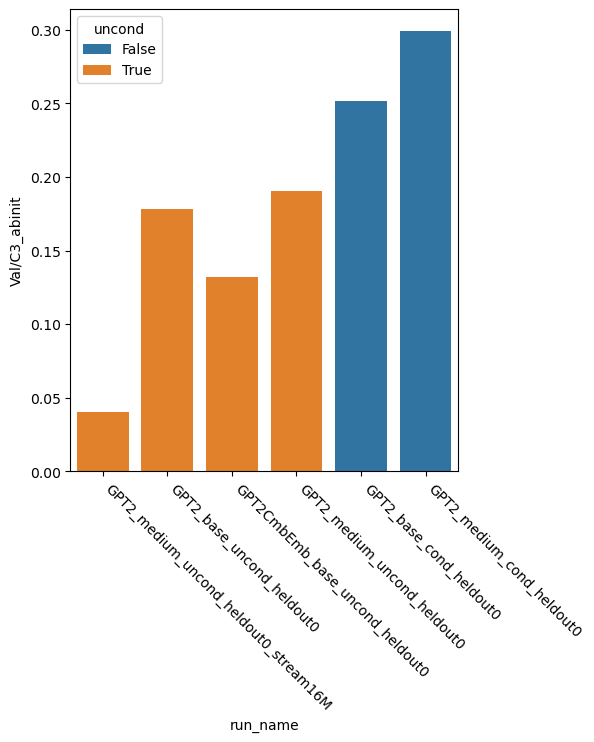

In [70]:
result_syndf_sorted = result_syndf.sort_values(by=["uncond", "heldout", "stream16M", "scale", ], ascending=[False, False, False, True])
figh = plt.figure(figsize=(5, 6))
sns.barplot(data=result_syndf_sorted[result_syndf_sorted.heldout==True], x="run_name", y="Val/C3_abinit", hue="uncond")
# result_syndf.plot.bar(x="run_name", y="Val/C3_abinit", hue="heldout")
plt.xticks(rotation=-45, ha='left')
plt.show()

/tmp/ipykernel_568105/3556649860.py:10: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=60, ha='right')
/tmp/ipykernel_568105/3556649860.py:10: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=60, ha='right')
/tmp/ipykernel_568105/3556649860.py:10: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=60, ha='right')
/tmp/ipykernel_568105/3556649860.py:10: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=60, ha='right')
/tmp/ipykernel_568105/3556649860.py:10: UserWarning: set

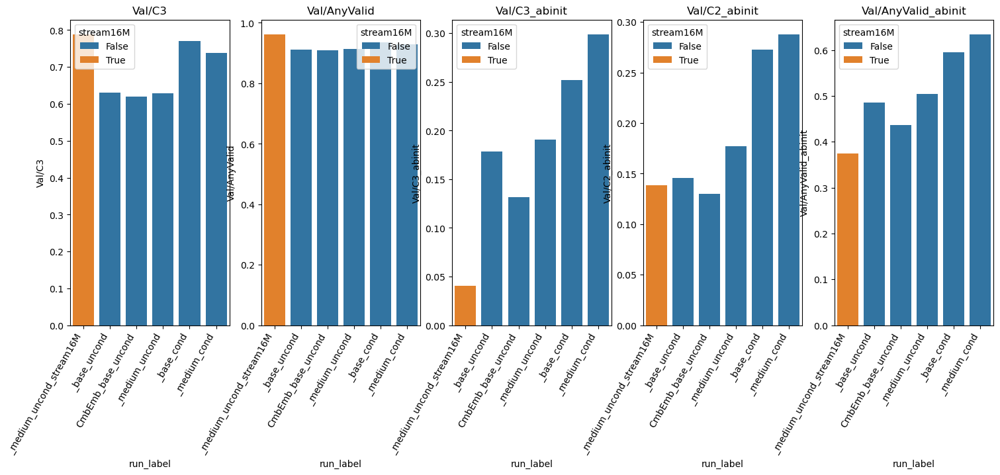

In [111]:
result_syndf_sorted = result_syndf.sort_values(by=["uncond", "heldout", "stream16M", "scale", ], 
                                               ascending=[False, False, False, True])
# create a new column with shortened run names
result_syndf_sorted["run_label"] = result_syndf_sorted.index.map(lambda x: x.replace("_heldout0","").replace("GPT2",""))

figh, axs = plt.subplots(1, 5, figsize=(18, 6), sharex=True)
for ax, metric in zip(axs, ["Val/C3", "Val/AnyValid", "Val/C3_abinit", "Val/C2_abinit", "Val/AnyValid_abinit"]):
    sns.barplot(data=result_syndf_sorted[result_syndf_sorted.heldout==True], x="run_label", y=metric, 
                hue="stream16M", ax=ax)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=60, ha='right')
    ax.set_title(metric)
plt.show()

/tmp/ipykernel_568105/587740213.py:10: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=60, ha='right')
/tmp/ipykernel_568105/587740213.py:10: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=60, ha='right')
/tmp/ipykernel_568105/587740213.py:10: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=60, ha='right')
/tmp/ipykernel_568105/587740213.py:10: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=60, ha='right')
/tmp/ipykernel_568105/587740213.py:10: UserWarning: set_tick

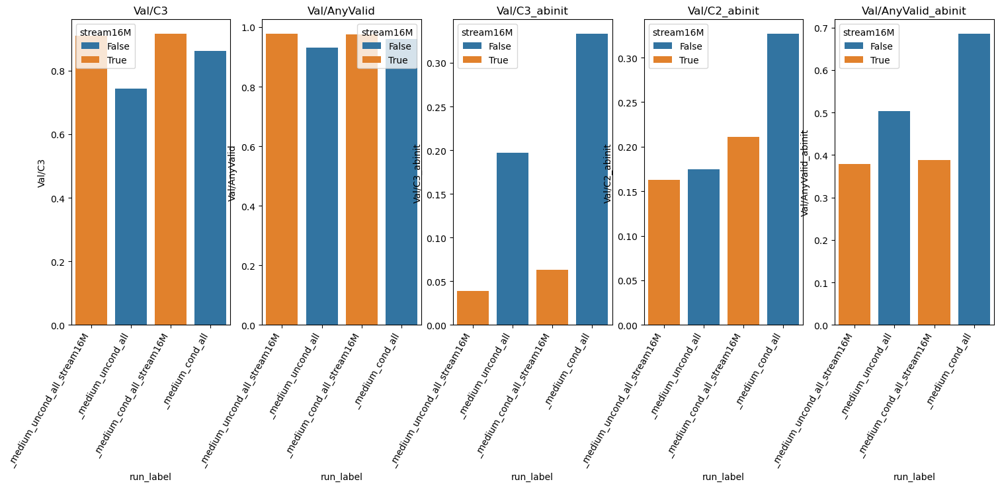

In [110]:
result_syndf_sorted = result_syndf.sort_values(by=["uncond", "heldout", "stream16M", "scale", ], 
                                               ascending=[False, False, False, True])
# create a new column with shortened run names
result_syndf_sorted["run_label"] = result_syndf_sorted.index.map(lambda x: x.replace("_heldout0","").replace("GPT2",""))

figh, axs = plt.subplots(1, 5, figsize=(18, 6), sharex=True)
for ax, metric in zip(axs, ["Val/C3", "Val/AnyValid", "Val/C3_abinit", "Val/C2_abinit", "Val/AnyValid_abinit"]):
    sns.barplot(data=result_syndf_sorted[result_syndf_sorted.heldout==False], 
                x="run_label", y=metric, hue="stream16M", ax=ax)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=60, ha='right')
    ax.set_title(metric)
plt.show()

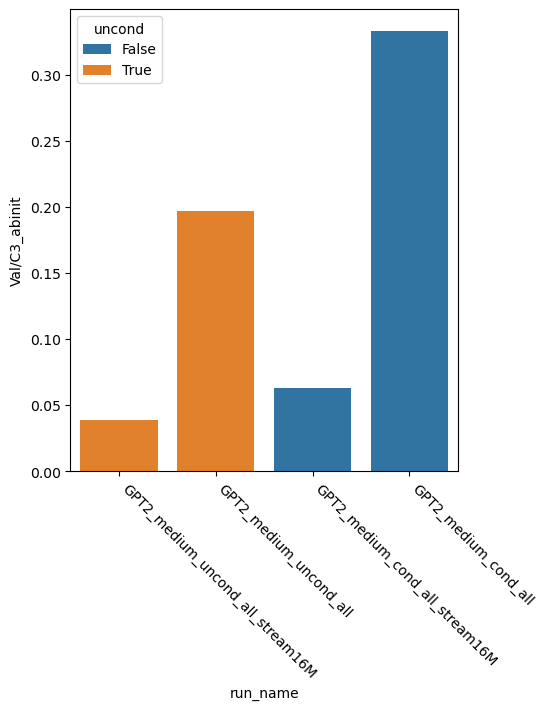

In [71]:
result_syndf_sorted = result_syndf.sort_values(by=["uncond", "heldout", "stream16M", "scale", ], ascending=[False, False, False, True])
figh = plt.figure(figsize=(5, 6))
sns.barplot(data=result_syndf_sorted[result_syndf_sorted.heldout==False], x="run_name", y="Val/C3_abinit", hue="uncond")
# result_syndf.plot.bar(x="run_name", y="Val/C3_abinit", hue="heldout")
plt.xticks(rotation=-45, ha='left')
plt.show()

### General learning dynamics

In [15]:
list(tb_data_col)

['GPT2_medium_RAVEN_uncond_heldout0_stream16M-20240704-041344/tensorboard_logs',
 'GPT2_medium_RAVEN_cond_all-20240702-032839/tensorboard_logs',
 'GPT2_base_RAVEN_uncond_heldout0-20240630-023945/tensorboard_logs',
 'GPT2_medium_RAVEN_uncond_all_stream16M-20240704-025623/tensorboard_logs',
 'GPT2_medium_RAVEN_cond_heldout0-20240701-231350/tensorboard_logs',
 'GPT2_base_RAVEN_cond_heldout0-20240701-225339/tensorboard_logs',
 'GPT2_medium_RAVEN_cond_all_stream16M-20240704-030228/tensorboard_logs',
 'GPT2_medium_RAVEN_uncond_all-20240702-032428/tensorboard_logs',
 'GPT2CmbEmb_base_RAVEN_uncond_heldout0-20240701-154321/tensorboard_logs',
 'GPT2_medium_RAVEN_uncond_heldout0-20240701-133418/tensorboard_logs']

GPT2_medium_RAVEN_uncond_heldout0_stream16M-20240704-041344/tensorboard_logs


/tmp/ipykernel_2171913/402787616.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3


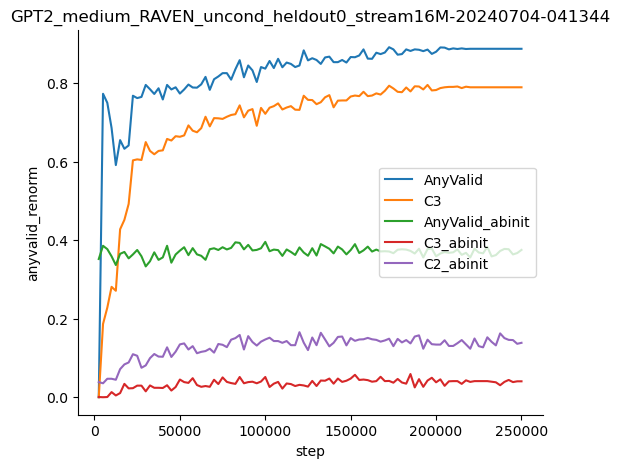

GPT2_medium_RAVEN_cond_all-20240702-032839/tensorboard_logs


/tmp/ipykernel_2171913/402787616.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3


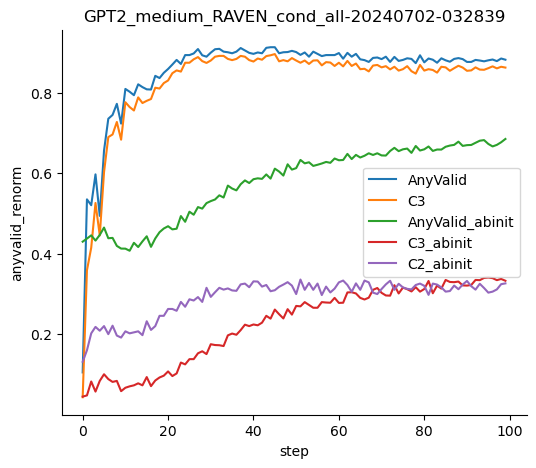

GPT2_base_RAVEN_uncond_heldout0-20240630-023945/tensorboard_logs


/tmp/ipykernel_2171913/402787616.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3


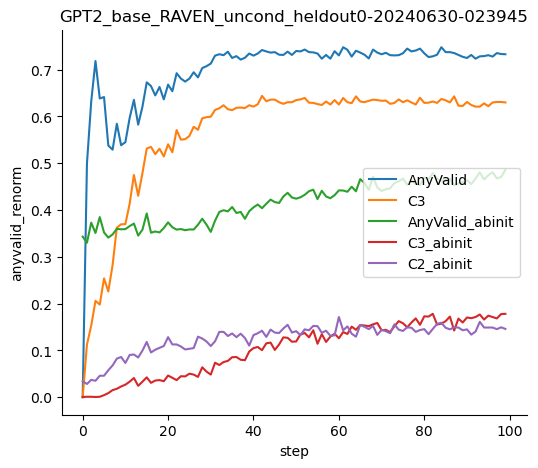

GPT2_medium_RAVEN_uncond_all_stream16M-20240704-025623/tensorboard_logs


/tmp/ipykernel_2171913/402787616.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3


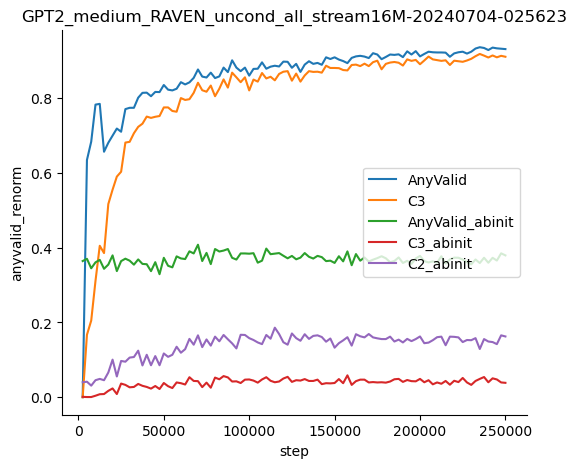

GPT2_medium_RAVEN_cond_heldout0-20240701-231350/tensorboard_logs


/tmp/ipykernel_2171913/402787616.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3


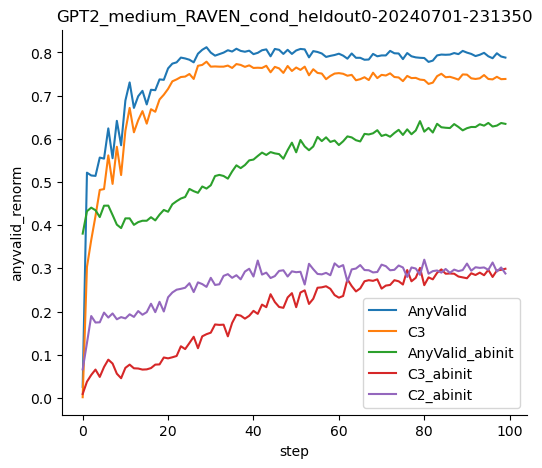

GPT2_base_RAVEN_cond_heldout0-20240701-225339/tensorboard_logs


/tmp/ipykernel_2171913/402787616.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3


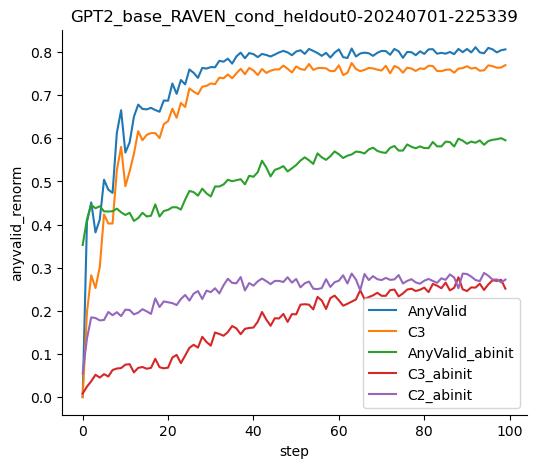

GPT2_medium_RAVEN_cond_all_stream16M-20240704-030228/tensorboard_logs


/tmp/ipykernel_2171913/402787616.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3


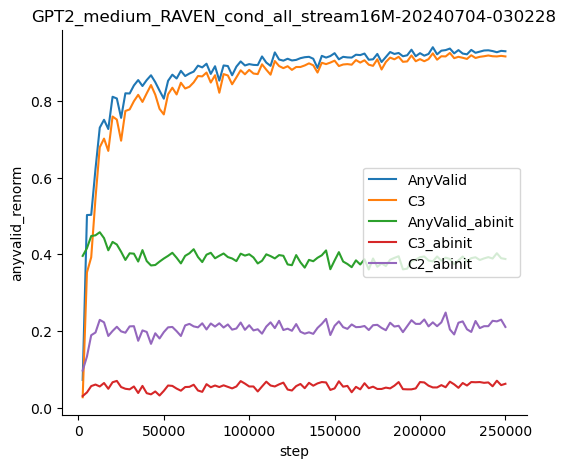

GPT2_medium_RAVEN_uncond_all-20240702-032428/tensorboard_logs


/tmp/ipykernel_2171913/402787616.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3


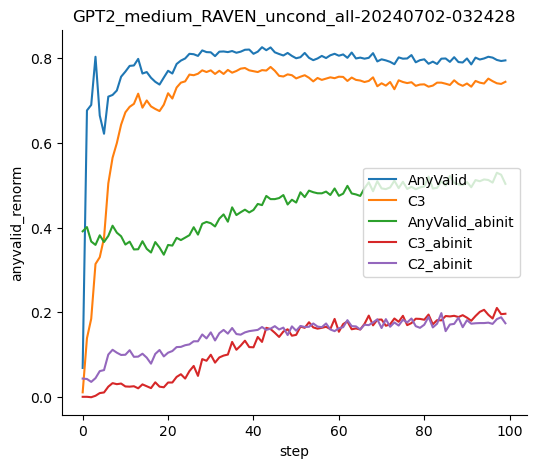

GPT2CmbEmb_base_RAVEN_uncond_heldout0-20240701-154321/tensorboard_logs


/tmp/ipykernel_2171913/402787616.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3


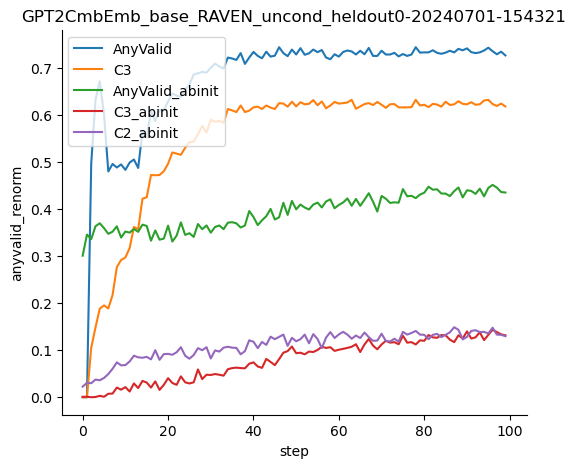

GPT2_medium_RAVEN_uncond_heldout0-20240701-133418/tensorboard_logs


/tmp/ipykernel_2171913/402787616.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3


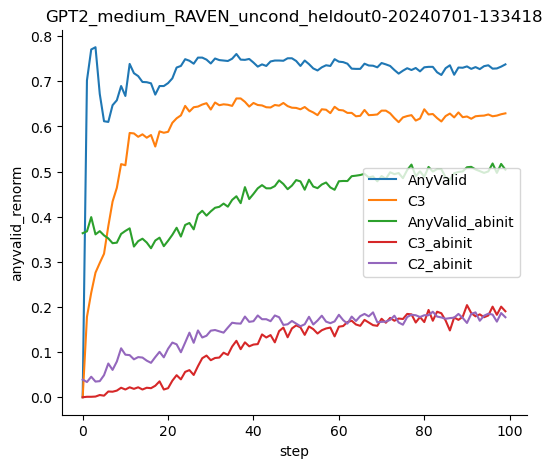

In [27]:
for expfullname in tb_data_col:
    tb_record = tb_data_col[expfullname]
    expname = expfullname.split("/")[0]
    print(expfullname)
    # print(tb_record.keys())
    # print(tb_record['tag'].unique())    
    tb_anyvalid = tb_record[tb_record.tag=='Val/AnyValid']
    tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3
    figh = plt.figure(figsize=(6, 5))
    sns.lineplot(data=tb_anyvalid, x='step', y='anyvalid_renorm', label='AnyValid')
    sns.lineplot(data=tb_record[tb_record.tag=='Val/C3'], x='step', y='value', label='C3')
    # sns.lineplot(data=tb_record[tb_record.tag=='Val/AnyValid'], x='step', y='value', label='AnyValid')
    sns.lineplot(data=tb_record[tb_record.tag=='Val/AnyValid_abinit'], x='step', y='value', label='AnyValid_abinit')
    sns.lineplot(data=tb_record[tb_record.tag=='Val/C3_abinit'], x='step', y='value', label='C3_abinit')
    sns.lineplot(data=tb_record[tb_record.tag=='Val/C2_abinit'], x='step', y='value', label='C2_abinit')
    plt.legend() # ['Val/C3', 'Val/C3_abinit', 'Val/C2_abinit', 'Val/AnyValid_abinit']
    plt.title(expname)
    saveallforms(GPTfigdir, f"{expname}_valid_consist_summary", figh)
    plt.show()
    # raise ValueError
    # plot 
    # plt.plot(tb_record['Val/C3'])
    # filter tag = 'heldout0'

### Individual rule learning dynamics

In [ ]:
for expfullname in tb_data_col.keys():
    print(expfullname)
    expname = expfullname.split("/tensorboard_logs")[0]
    prefix = "eval_step" if "stream" in expname else "eval_epoch"
    eval_col = sweep_collect_eval_data(expname, GPT_exproot, prefix=prefix)
    epoch_list, rule_list_all, consistency_all = extract_rule_list_from_eval_col(eval_col, is_abinit=True)
    rule_cnt_mat, cons3_rule_cnt_mat, cons2_rule_cnt_mat = format_rule_list_to_mat(rule_list_all, consistency_all)
    eval_sample_num = rule_list_all.shape[1]
    print(expname)
    if "heldout0" in expname:
        heldout_id = [1, 16, 20, 34, 37]  
    else:
        heldout_id = []

    figh, axs = visualize_indiv_rule_dynam(epoch_list, rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                            titlestr=f"{expname}\nValid rule count separated by rule type")
    saveallforms(GPTfigdir, f"{expname}_indiv_rule_validity", figh)

    figh, axs = visualize_indiv_rule_dynam(epoch_list, cons3_rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                                        titlestr=f"{expname}\nConsistency 3 (blue) and 2 (orange) rule count", )
    figh, axs = visualize_indiv_rule_dynam(epoch_list, cons2_rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                                        titlestr=f"{expname}\nConsistency 3 (blue) and 2 (orange) rule count", axs=axs)
    saveallforms(GPTfigdir, f"{expname}_indiv_rule_consistency", figh)
    
    figh = visualize_train_heldout_rule(epoch_list, rule_cnt_mat, heldout_id, 
                                normalizer=eval_sample_num * 3, reflevel=1 / 40,
                                titlestr=f"{expname}\nValid rule fraction")
    saveallforms(GPTfigdir, f"{expname}_train_held_rule_validity", figh)

    figh = visualize_train_heldout_rule(epoch_list, cons3_rule_cnt_mat, heldout_id, 
                                normalizer=eval_sample_num, reflevel=1 / 40,
                                titlestr=f"{expname}\nC3 sample fraction")
    saveallforms(GPTfigdir, f"{expname}_train_held_rule_consistency", figh)

In [56]:
expname = "GPT2_medium_RAVEN_uncond_heldout0-20240701-133418"
eval_col = sweep_collect_eval_data(expname, GPT_exproot, prefix="eval_epoch")

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/GPT2_raven/GPT2_medium_RAVEN_uncond_heldout0-20240701-133418/samples
example file: eval_epoch9.pt


100%|██████████| 100/100 [00:07<00:00, 14.20it/s]


In [57]:
expname = "GPT2_medium_RAVEN_uncond_heldout0_stream16M-20240704-041344"
eval_col = sweep_collect_eval_data(expname, GPT_exproot, prefix="eval_step")

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/GPT2_raven/GPT2_medium_RAVEN_uncond_heldout0_stream16M-20240704-041344/samples
example file: eval_step99999.pt


100%|██████████| 100/100 [00:04<00:00, 24.17it/s]


In [18]:
expname = "GPT2_medium_RAVEN_uncond_all_stream16M-20240704-025623"
expname = "GPT2_medium_RAVEN_cond_all_stream16M-20240704-030228"
eval_col = sweep_collect_eval_data(expname, GPT_exproot, prefix="eval_step")

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/GPT2_raven/GPT2_medium_RAVEN_cond_all_stream16M-20240704-030228/samples
example file: eval_step99999.pt


  0%|          | 0/100 [00:00<?, ?it/s]

In [ ]:
epoch_list, rule_list_all, consistency_all = extract_rule_list_from_eval_col(eval_col, is_abinit=True)
rule_cnt_mat, cons3_rule_cnt_mat, cons2_rule_cnt_mat = format_rule_list_to_mat(rule_list_all, consistency_all)
print(expname)
if "heldout0" in expname:
    heldout_id = [1, 16, 20, 34, 37]  
else:
    heldout_id = []

figh, axs = visualize_indiv_rule_dynam(epoch_list, rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                        titlestr=f"{expname}\nValid rule count separated by rule type")
saveallforms(figdir, f"{expname}_indiv_rule_validity", figh)

figh, axs = visualize_indiv_rule_dynam(epoch_list, cons3_rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                                       titlestr=f"{expname}\nConsistency 3 (blue) and 2 (orange) rule count", )
figh, axs = visualize_indiv_rule_dynam(epoch_list, cons2_rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                                       titlestr=f"{expname}\nConsistency 3 (blue) and 2 (orange) rule count", axs=axs)
saveallforms(figdir, f"{expname}_indiv_rule_consistency", figh)

In [20]:
rule_list_all.shape

(100, 2000, 3)

In [65]:
epoch_list, rule_list_all_cont, consistency_all_cont = extract_rule_list_from_eval_col(eval_col, is_abinit=False)

(100, 2000, 3) (100, 2, 2000)


In [70]:
# compute the accuracy of each type of rules
# find the mask for each type of rule prompt 

In [81]:
epoch_num = rule_list_all_cont.shape[0]
rule_num = 40
acc_cnt_table = np.zeros((epoch_num, rule_num))
accuracy_table = np.zeros((epoch_num, rule_num))
mis_cnt_table = np.zeros((epoch_num, rule_num, rule_num))
for epochi in range(epoch_num):
    rule_list = rule_list_all_cont[epochi]
    consistency_list = consistency_all_cont[epochi]
    for rulei in range(rule_num):
        rule_mask = (rule_list[:,0]==np.array([rulei])) & (rule_list[:,1]==np.array([rulei]))
        C3_rules = consistency_list[0][rule_mask]
        C3_rules_flatten = sum(list(C3_rules), [])
        C3_cont_cnt = len(C3_rules_flatten)
        accuracy_table[epochi, rulei] = C3_cont_cnt / sum(rule_mask)
        acc_cnt_table[epochi, rulei] = C3_cont_cnt
        # raise NotImplementedError
        # for rulej in range(rule_num):
        #     mis_cnt_table[epochi, rulei, rulej] = (rule_list[rule_mask][:,:,0]==np.array([rulej])).sum()

# (rule_list_all_cont[:,:,1]==np.array([1])).sum()

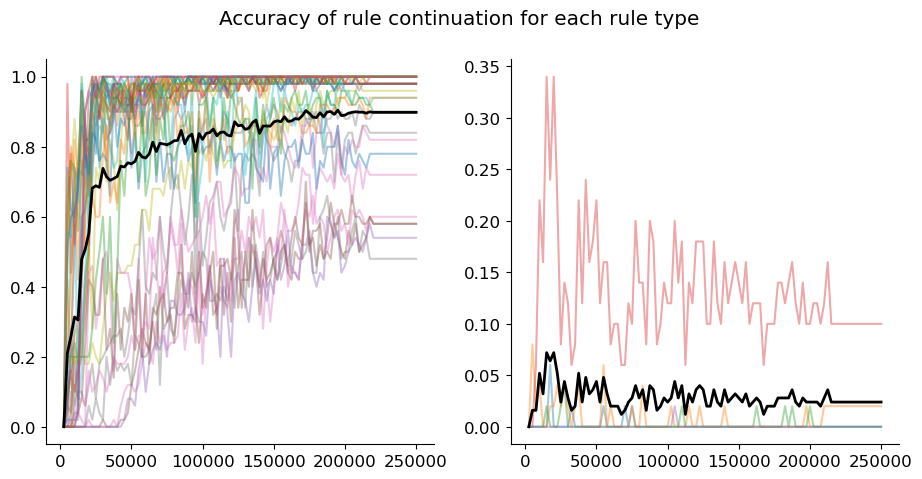

In [88]:
heldout_mask = np.zeros((40,)).astype(bool)
heldout_mask[heldout_id] = True
plt.subplots(1, 2, figsize=(11, 5))
plt.subplot(1, 2, 1)
plt.plot(epoch_list, accuracy_table[:, ~heldout_mask], alpha=0.4)
plt.plot(epoch_list, accuracy_table[:, ~heldout_mask].mean(axis=1), color='black', linewidth=2)
plt.subplot(1, 2, 2)
plt.plot(epoch_list, accuracy_table[:, heldout_mask], alpha=0.4)
plt.plot(epoch_list, accuracy_table[:, heldout_mask].mean(axis=1), color='black', linewidth=2)
plt.suptitle("Accuracy of inpainting / continuation for each rule type")
plt.show()

### Scratch space

In [ ]:
expname = "GPT2_medium_RAVEN_uncond_heldout0_stream16M-20240704-041344"
assert os.path.exists(join(GPT_exproot, expname, "samples")), expname  
print(sorted(os.listdir(join(GPT_exproot, expname, "samples"))))
# for files with names like 'sample_rule_eval_995000.pt' find the one with largest number
epoch_nums = sorted([int(f.split("eval_step")[-1].split(".pt")[0]) for f in os.listdir(join(GPT_exproot, expname,'samples'))])
eval_col = {}
for epoch_num in tqdm(epoch_nums):
    samples_eval = torch.load(join(GPT_exproot, expname, 'samples', f"eval_step{epoch_num}.pt"))
    eval_col[epoch_num] = samples_eval

['eval_step102499.pt', 'eval_step104999.pt', 'eval_step107499.pt', 'eval_step109999.pt', 'eval_step112499.pt', 'eval_step114999.pt', 'eval_step117499.pt', 'eval_step119999.pt', 'eval_step122499.pt', 'eval_step12499.pt', 'eval_step124999.pt', 'eval_step127499.pt', 'eval_step129999.pt', 'eval_step132499.pt', 'eval_step134999.pt', 'eval_step137499.pt', 'eval_step139999.pt', 'eval_step142499.pt', 'eval_step144999.pt', 'eval_step147499.pt', 'eval_step14999.pt', 'eval_step149999.pt', 'eval_step152499.pt', 'eval_step154999.pt', 'eval_step157499.pt', 'eval_step159999.pt', 'eval_step162499.pt', 'eval_step164999.pt', 'eval_step167499.pt', 'eval_step169999.pt', 'eval_step172499.pt', 'eval_step17499.pt', 'eval_step174999.pt', 'eval_step177499.pt', 'eval_step179999.pt', 'eval_step182499.pt', 'eval_step184999.pt', 'eval_step187499.pt', 'eval_step189999.pt', 'eval_step192499.pt', 'eval_step194999.pt', 'eval_step197499.pt', 'eval_step19999.pt', 'eval_step199999.pt', 'eval_step202499.pt', 'eval_step204

100%|██████████| 100/100 [00:12<00:00,  7.98it/s]


In [ ]:
expname = "GPT2_medium_RAVEN_uncond_heldout0-20240701-133418"
assert os.path.exists(join(GPT_exproot, expname, "samples")), expname  
# for files with names like 'sample_rule_eval_995000.pt' find the one with largest number
epoch_nums = sorted([int(f.split("eval_epoch")[-1].split(".pt")[0]) for f in os.listdir(join(GPT_exproot, expname,'samples'))])
eval_col = {}
for epoch_num in tqdm(epoch_nums):
    samples_eval = torch.load(join(GPT_exproot, expname, 'samples', f"eval_epoch{epoch_num}.pt"))
    eval_col[epoch_num] = samples_eval

100%|██████████| 100/100 [00:06<00:00, 15.79it/s]


In [ ]:
is_abinit = False

epoch_list = list(eval_col.keys())
rule_list_all = []
consistency_all = []
for epoch in eval_col.keys():
    if is_abinit:
        rule_list_all.append(eval_col[epoch]['rule_col_list_abinit'])
        consistency_all.append((eval_col[epoch]['C3_list_abinit'], eval_col[epoch]['C2_list_abinit']))
    else:
        rule_list_all.append(eval_col[epoch]['rule_col_list'])
        consistency_all.append((eval_col[epoch]['C3_list'], eval_col[epoch]['C2_list']))
rule_list_all = np.array(rule_list_all, dtype=object)
consistency_all = np.array(consistency_all, dtype=object)
print(rule_list_all.shape, consistency_all.shape)

(100, 2000, 3) (100, 2, 2000)


In [ ]:
tb_data_col['GPT2_medium_RAVEN_cond_heldout0-20240701-231350/tensorboard_logs']

,wall_time,step,tag,value
0,1.719890e+09,5,Loss/train,6.686317
1,1.719890e+09,16,Loss/train,5.268061
2,1.719890e+09,23,Loss/train,5.093456
3,1.719890e+09,56,Loss/train,4.839161
4,1.719890e+09,66,Loss/train,4.902054
...,...,...,...,...
20795,1.719934e+09,95,Val/AnyValid_abinit,0.636667
20796,1.719934e+09,96,Val/AnyValid_abinit,0.628333
20797,1.719935e+09,97,Val/AnyValid_abinit,0.630500
20798,1.719935e+09,98,Val/AnyValid_abinit,0.636500


In [ ]:
tb_data_col['GPT2_medium_RAVEN_cond_heldout0-20240701-231350/tensorboard_logs']["tag"].unique()

array(['Loss/train', 'lr', 'Train/Avg_Loss', 'Val/Avg_Loss', 'Val/C3',
       'Val/C2', 'Val/AnyValid', 'Val/C3_abinit', 'Val/C2_abinit',
       'Val/AnyValid_abinit'], dtype=object)

In [ ]:
# Create an empty dataframe
result_df = []
# Iterate over the runs in tb_data_col
for run_name, run_data in tb_data_col.items():
    # Get the last step for each tag
    last_step_data = run_data.groupby('tag')['step'].max().reset_index()
    # Extract the value at the last step for each tag
    last_step_values = run_data.merge(last_step_data, on=['tag', 'step'], how='inner')
    if simplify_runname is not None:
        last_step_values["run_name"] = simplify_runname(run_name) 
    else:
        last_step_values["run_name"] = run_name
    last_step_values = last_step_values.pivot(index='run_name', columns='tag', values='value')
    # Append the extracted values to the result dataframe
    result_df.append(last_step_values)
result_df = pd.concat(result_df)

## Mamba

In [28]:
tb_data_col_SSM = extract_all_runs(SSM_exproot)

Extracted data from Mamba_base_RAVEN_uncond_heldout0-20240726-003732/tensorboard_logs
Extracted data from mamba_big_RAVEN_uncond_heldout0-20240726-152518/tensorboard_logs
Extracted data from mamba_huge_RAVEN_uncond_all-20240730-004038/tensorboard_logs
Extracted data from mamba_huge_RAVEN_uncond_heldout0-20240729-021515/tensorboard_logs
Extracted data from mamba_big_RAVEN_uncond_heldout0-20240726-153306/tensorboard_logs
Extracted data from mamba_big_RAVEN_uncond_all-20240730-003500/tensorboard_logs
Extracted data from Mamba_base_RAVEN_uncond_heldout0-20240726-004710/tensorboard_logs
Extracted data from mamba_medium_RAVEN_uncond_all-20240729-022153/tensorboard_logs
Extracted data from mamba_medium_RAVEN_uncond_heldout0-20240726-005020/tensorboard_logs
Extracted data from mamba_medium_RAVEN_uncond_heldout0-20240726-153805/tensorboard_logs


In [29]:
def simplify_runname_SSM(run_name):
    return run_name.replace("/tensorboard_logs", "").split("-2024")[0].replace("_RAVEN", "")#.replace("_new", "")

syndf_SSM = extract_last_step_summary(tb_data_col_SSM, simplify_runname_SSM, exclude_runs=())
syndf_SSM

tag,Loss/train,Train/Avg_Loss,Val/AnyValid,Val/AnyValid_abinit,Val/Avg_Loss,Val/C2,Val/C2_abinit,Val/C3,Val/C3_abinit,lr,full_name,step,step/epoch
run_name,,,,,,,,,,,,,
Mamba_base_uncond_heldout0,3.530324,3.783875,0.863333,0.337728,3.540741,0.8945,0.024902,0.1055,0.000977,9.805957e-05,Mamba_base_RAVEN_uncond_heldout0-20240726-003732/tensorboard_logs,4888,0
mamba_big_uncond_heldout0,4.619632,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.700000e-05,mamba_big_RAVEN_uncond_heldout0-20240726-152518/tensorboard_logs,86,86
mamba_huge_uncond_all,0.227859,0.231787,0.922500,0.596680,24.653305,0.3005,0.236816,0.6995,0.225586,3.032820e-06,mamba_huge_RAVEN_uncond_all-20240730-004038/tensorboard_logs,239414,95
mamba_huge_uncond_heldout0,7.127731,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000e-06,mamba_huge_RAVEN_uncond_heldout0-20240729-021515/tensorboard_logs,0,0
mamba_big_uncond_heldout0,0.254182,0.225767,0.889000,0.537272,26.397144,0.4885,0.171387,0.5115,0.174805,0.000000e+00,mamba_big_RAVEN_uncond_heldout0-20240726-153306/tensorboard_logs,216099,99
mamba_big_uncond_all,0.227219,0.231080,0.911667,0.554688,26.789389,0.3585,0.179688,0.6415,0.213379,0.000000e+00,mamba_big_RAVEN_uncond_all-20240730-003500/tensorboard_logs,246899,99
Mamba_base_uncond_heldout0,0.279168,0.276806,0.866500,0.418294,44.025986,0.6140,0.100586,0.3860,0.040527,0.000000e+00,Mamba_base_RAVEN_uncond_heldout0-20240726-004710/tensorboard_logs,216099,99
mamba_medium_uncond_all,0.233620,0.235761,0.895667,0.513509,32.534550,0.4280,0.152832,0.5720,0.125977,0.000000e+00,mamba_medium_RAVEN_uncond_all-20240729-022153/tensorboard_logs,246899,99
mamba_medium_uncond_heldout0,0.293251,0.281547,0.890000,0.487467,22.352768,0.4880,0.146484,0.5120,0.133789,3.402546e-05,mamba_medium_RAVEN_uncond_heldout0-20240726-005020/tensorboard_logs,142604,64


In [30]:
excluded_runs = [
    "Mamba_base_RAVEN_uncond_heldout0-20240726-003732/tensorboard_logs",
    "mamba_big_RAVEN_uncond_heldout0-20240726-152518/tensorboard_logs",
    "mamba_huge_RAVEN_uncond_heldout0-20240729-021515/tensorboard_logs",
    "mamba_medium_RAVEN_uncond_heldout0-20240726-005020/tensorboard_logs",
]

syndf_SSM = extract_last_step_summary(tb_data_col_SSM, simplify_runname_SSM, exclude_runs=excluded_runs)
syndf_SSM

Excluding Mamba_base_RAVEN_uncond_heldout0-20240726-003732/tensorboard_logs
Excluding mamba_big_RAVEN_uncond_heldout0-20240726-152518/tensorboard_logs
Excluding mamba_huge_RAVEN_uncond_heldout0-20240729-021515/tensorboard_logs
Excluding mamba_medium_RAVEN_uncond_heldout0-20240726-005020/tensorboard_logs


tag,Loss/train,Train/Avg_Loss,Val/AnyValid,Val/AnyValid_abinit,Val/Avg_Loss,Val/C2,Val/C2_abinit,Val/C3,Val/C3_abinit,lr,full_name,step,step/epoch
run_name,,,,,,,,,,,,,
mamba_huge_uncond_all,0.227859,0.231787,0.922500,0.596680,24.653305,0.3005,0.236816,0.6995,0.225586,0.000003,mamba_huge_RAVEN_uncond_all-20240730-004038/tensorboard_logs,239414,95
mamba_big_uncond_heldout0,0.254182,0.225767,0.889000,0.537272,26.397144,0.4885,0.171387,0.5115,0.174805,0.000000,mamba_big_RAVEN_uncond_heldout0-20240726-153306/tensorboard_logs,216099,99
mamba_big_uncond_all,0.227219,0.231080,0.911667,0.554688,26.789389,0.3585,0.179688,0.6415,0.213379,0.000000,mamba_big_RAVEN_uncond_all-20240730-003500/tensorboard_logs,246899,99
Mamba_base_uncond_heldout0,0.279168,0.276806,0.866500,0.418294,44.025986,0.6140,0.100586,0.3860,0.040527,0.000000,Mamba_base_RAVEN_uncond_heldout0-20240726-004710/tensorboard_logs,216099,99
mamba_medium_uncond_all,0.233620,0.235761,0.895667,0.513509,32.534550,0.4280,0.152832,0.5720,0.125977,0.000000,mamba_medium_RAVEN_uncond_all-20240729-022153/tensorboard_logs,246899,99
mamba_medium_uncond_heldout0,0.249798,0.229807,0.879167,0.482910,33.249817,0.5525,0.122559,0.4475,0.110840,0.000000,mamba_medium_RAVEN_uncond_heldout0-20240726-153805/tensorboard_logs,216099,99


In [31]:
pkl.dump(tb_data_col_SSM, open(join(tabdir, "SSM_raven_tensorboard_raw_data.pkl"), "wb"))
syndf_SSM.to_csv(join(tabdir, "SSM_raven_tensorboard_data.csv"))

In [32]:
tb_data_col_SSM = pkl.load(open(join(tabdir, "SSM_raven_tensorboard_raw_data.pkl"), "rb"))
syndf_SSM = pd.read_csv(join(tabdir, "SSM_raven_tensorboard_data.csv"), index_col=0)

In [33]:
syndf_SSM

,Loss/train,Train/Avg_Loss,Val/AnyValid,Val/AnyValid_abinit,Val/Avg_Loss,Val/C2,Val/C2_abinit,Val/C3,Val/C3_abinit,lr,full_name,step,step/epoch
run_name,,,,,,,,,,,,,
mamba_huge_uncond_all,0.227859,0.231787,0.922500,0.596680,24.653305,0.3005,0.236816,0.6995,0.225586,0.000003,mamba_huge_RAVEN_uncond_all-20240730-004038/tensorboard_logs,239414,95
mamba_big_uncond_heldout0,0.254182,0.225767,0.889000,0.537272,26.397144,0.4885,0.171387,0.5115,0.174805,0.000000,mamba_big_RAVEN_uncond_heldout0-20240726-153306/tensorboard_logs,216099,99
mamba_big_uncond_all,0.227219,0.231080,0.911667,0.554688,26.789389,0.3585,0.179688,0.6415,0.213379,0.000000,mamba_big_RAVEN_uncond_all-20240730-003500/tensorboard_logs,246899,99
Mamba_base_uncond_heldout0,0.279168,0.276806,0.866500,0.418294,44.025986,0.6140,0.100586,0.3860,0.040527,0.000000,Mamba_base_RAVEN_uncond_heldout0-20240726-004710/tensorboard_logs,216099,99
mamba_medium_uncond_all,0.233620,0.235761,0.895667,0.513509,32.534550,0.4280,0.152832,0.5720,0.125977,0.000000,mamba_medium_RAVEN_uncond_all-20240729-022153/tensorboard_logs,246899,99
mamba_medium_uncond_heldout0,0.249798,0.229807,0.879167,0.482910,33.249817,0.5525,0.122559,0.4475,0.110840,0.000000,mamba_medium_RAVEN_uncond_heldout0-20240726-153805/tensorboard_logs,216099,99


### Synopsis of models

In [ ]:
syndf_SSM["heldout"] = syndf_SSM.index.map(lambda x: "_heldout0" in x)
syndf_SSM["scale"] = syndf_SSM.index.map(lambda x: "x1" if "base" in x else 
                                                   "x2" if "medium" in x else 
                                                   "x3" if "big" in x else 
                                                   "x4" if "huge" in x else 
                                                   None)

#### Effect of SSM Scale of Rule Learning

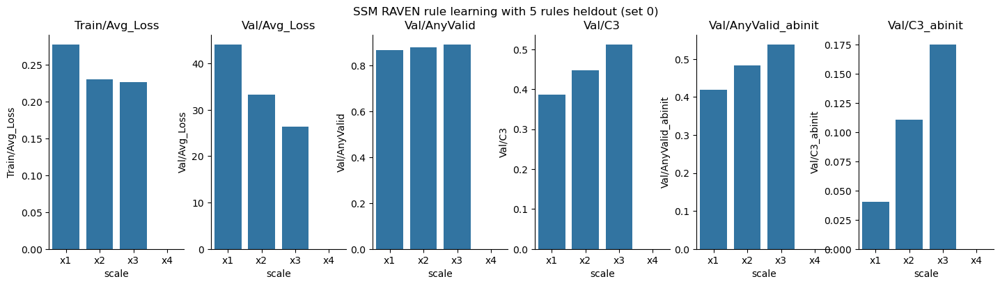

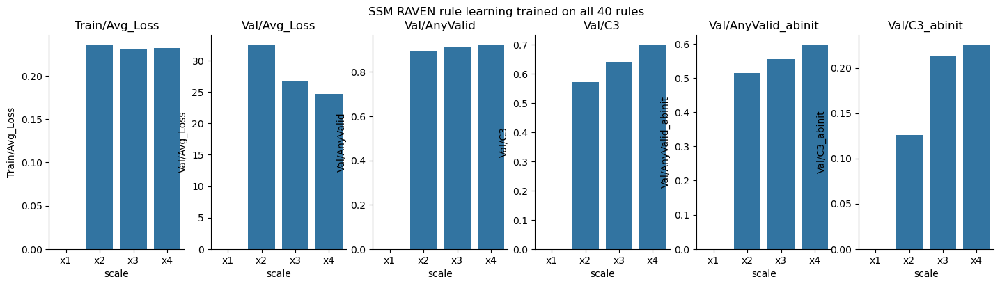

In [ ]:
# plot the results using seaborn
fig, axs = plt.subplots(1, 6, figsize=(17.5, 4), sharex=True, squeeze=False)
for ax, metric in zip(axs[0,:], ['Train/Avg_Loss', 'Val/Avg_Loss', "Val/AnyValid", "Val/C3", "Val/AnyValid_abinit", "Val/C3_abinit",]):
    sns.barplot(data=syndf_SSM[syndf_SSM.heldout==True], x="scale", y=metric, ax=ax, order=["x1", "x2", "x3", "x4"])
    ax.set_title(metric)
fig.suptitle("SSM RAVEN rule learning with 5 rules heldout (set 0)")
fig.show()

fig, axs = plt.subplots(1, 6, figsize=(17.5, 4), sharex=True, squeeze=False)
for ax, metric in zip(axs[0,:], ['Train/Avg_Loss', 'Val/Avg_Loss', "Val/AnyValid", "Val/C3", "Val/AnyValid_abinit", "Val/C3_abinit",]):
    sns.barplot(data=syndf_SSM[syndf_SSM.heldout==False], x="scale", y=metric, ax=ax, order=["x1", "x2", "x3", "x4"])
    ax.set_title(metric)
fig.suptitle("SSM RAVEN rule learning trained on all 40 rules")
fig.show()

mamba_huge_RAVEN_uncond_all-20240730-004038/tensorboard_logs


/tmp/ipykernel_2171913/4050527755.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3


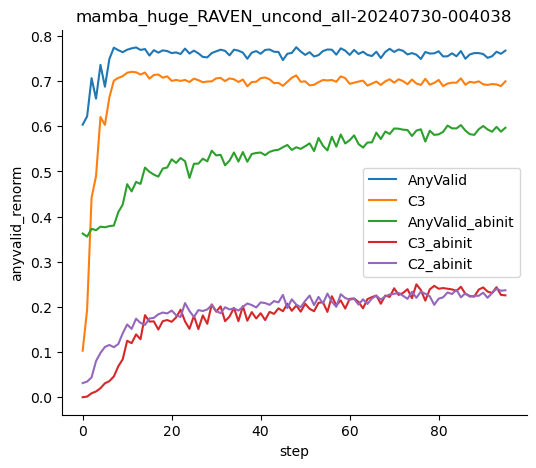

mamba_big_RAVEN_uncond_heldout0-20240726-153306/tensorboard_logs


/tmp/ipykernel_2171913/4050527755.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3


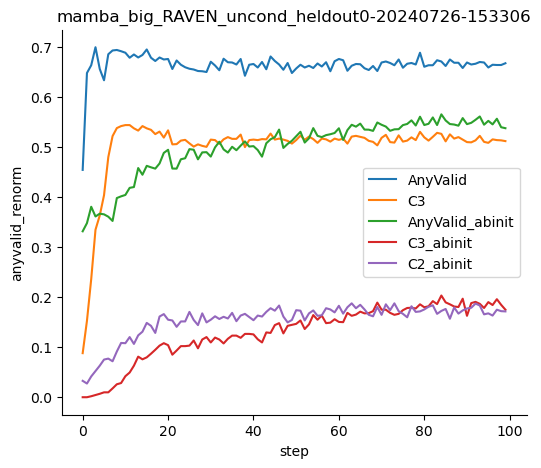

mamba_big_RAVEN_uncond_all-20240730-003500/tensorboard_logs


/tmp/ipykernel_2171913/4050527755.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3


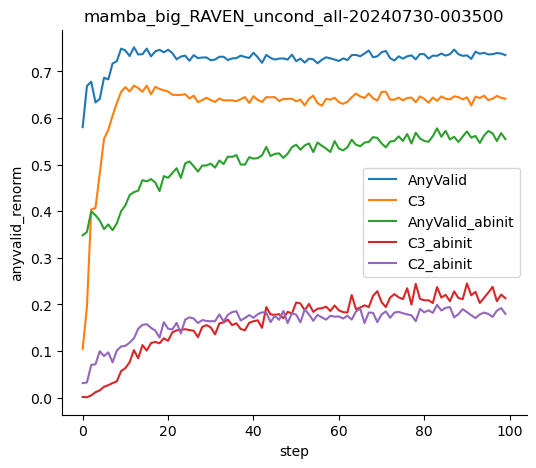

Mamba_base_RAVEN_uncond_heldout0-20240726-004710/tensorboard_logs


/tmp/ipykernel_2171913/4050527755.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3


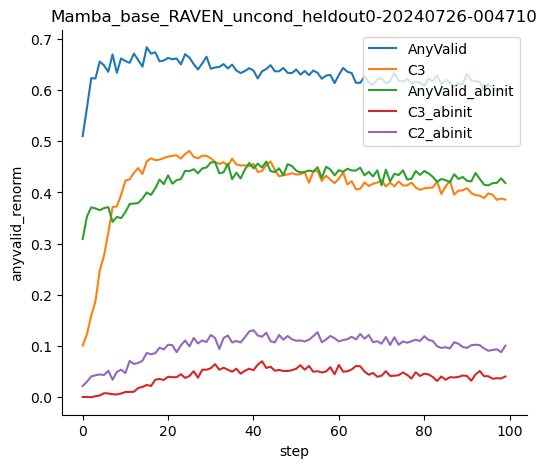

mamba_medium_RAVEN_uncond_all-20240729-022153/tensorboard_logs


/tmp/ipykernel_2171913/4050527755.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3


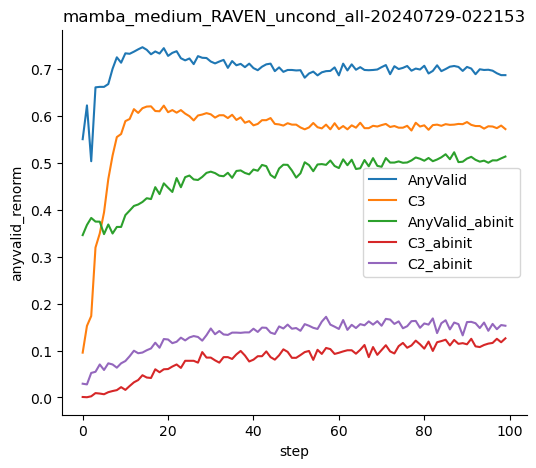

mamba_medium_RAVEN_uncond_heldout0-20240726-153805/tensorboard_logs


/tmp/ipykernel_2171913/4050527755.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3


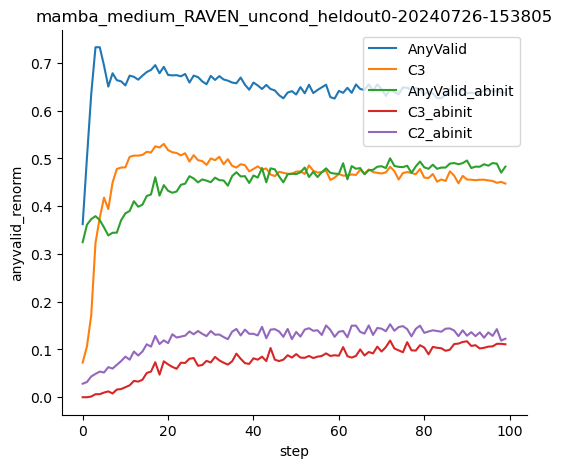

In [36]:
excluded_runs = [
    "Mamba_base_RAVEN_uncond_heldout0-20240726-003732/tensorboard_logs",
    "mamba_big_RAVEN_uncond_heldout0-20240726-152518/tensorboard_logs",
    "mamba_huge_RAVEN_uncond_heldout0-20240729-021515/tensorboard_logs",
    "mamba_medium_RAVEN_uncond_heldout0-20240726-005020/tensorboard_logs",
]
for expfullname in tb_data_col_SSM:
    if expfullname in excluded_runs:
        continue
    tb_record = tb_data_col_SSM[expfullname]
    expname = expfullname.split("/")[0]
    print(expfullname)
    # print(tb_record.keys())
    # print(tb_record['tag'].unique())    
    tb_anyvalid = tb_record[tb_record.tag=='Val/AnyValid']
    tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3
    figh = plt.figure(figsize=(6, 5))
    sns.lineplot(data=tb_anyvalid, x='step', y='anyvalid_renorm', label='AnyValid')
    sns.lineplot(data=tb_record[tb_record.tag=='Val/C3'], x='step', y='value', label='C3')
    # sns.lineplot(data=tb_record[tb_record.tag=='Val/AnyValid'], x='step', y='value', label='AnyValid')
    sns.lineplot(data=tb_record[tb_record.tag=='Val/AnyValid_abinit'], x='step', y='value', label='AnyValid_abinit')
    sns.lineplot(data=tb_record[tb_record.tag=='Val/C3_abinit'], x='step', y='value', label='C3_abinit')
    sns.lineplot(data=tb_record[tb_record.tag=='Val/C2_abinit'], x='step', y='value', label='C2_abinit')
    plt.legend() # ['Val/C3', 'Val/C3_abinit', 'Val/C2_abinit', 'Val/AnyValid_abinit']
    plt.title(expname)
    saveallforms(SSMfigdir, f"{expname}_valid_consist_summary", figh)
    plt.show()

### Load individual epochs and see rule learning dynamics

In [ ]:
excluded_runs = [
    "Mamba_base_RAVEN_uncond_heldout0-20240726-003732/tensorboard_logs",
    "mamba_big_RAVEN_uncond_heldout0-20240726-152518/tensorboard_logs",
    "mamba_huge_RAVEN_uncond_heldout0-20240729-021515/tensorboard_logs",
    "mamba_medium_RAVEN_uncond_heldout0-20240726-005020/tensorboard_logs",
]
expname = "mamba_big_RAVEN_uncond_heldout0-20240726-153306"
for expfullname in tb_data_col_SSM:
    if expfullname in excluded_runs:
        continue
    expname = expfullname.split("/")[0]
    eval_col = sweep_collect_eval_data(expname, SSM_exproot, prefix="eval_epoch")
    epoch_list, rule_list_all, consistency_all = extract_rule_list_from_eval_col(eval_col, is_abinit=True)
    rule_cnt_mat, cons3_rule_cnt_mat, cons2_rule_cnt_mat = format_rule_list_to_mat(rule_list_all, consistency_all)
    eval_sample_num = rule_list_all.shape[1]

    print(expname)
    if "heldout0" in expname:
        heldout_id = [1, 16, 20, 34, 37]  
    else:
        heldout_id = []
    figh, axs = visualize_indiv_rule_dynam(epoch_list, rule_cnt_mat, conv_wid=1, heldout_id=heldout_id,
                            titlestr=f"{expname}\nValid rule count separated by rule type")
    saveallforms(SSMfigdir, f"{expname}_indiv_rule_validity", figh)

    figh, axs = visualize_indiv_rule_dynam(epoch_list, cons3_rule_cnt_mat, conv_wid=1, heldout_id=heldout_id,
                                        titlestr=f"{expname}\nConsistency 3 (blue) and 2 (orange) rule count", )
    figh, axs = visualize_indiv_rule_dynam(epoch_list, cons2_rule_cnt_mat, conv_wid=1, heldout_id=heldout_id,
                                        titlestr=f"{expname}\nConsistency 3 (blue) and 2 (orange) rule count", axs=axs)
    saveallforms(SSMfigdir, f"{expname}_indiv_rule_consistency", figh)

    figh = visualize_train_heldout_rule(epoch_list, rule_cnt_mat, heldout_id, 
                                normalizer=eval_sample_num * 3, reflevel=1 / 40,
                                titlestr=f"{expname}\nValid rule fraction")
    saveallforms(SSMfigdir, f"{expname}_train_held_rule_validity", figh)

    figh = visualize_train_heldout_rule(epoch_list, cons3_rule_cnt_mat, heldout_id, 
                                normalizer=eval_sample_num, reflevel=1 / 40,
                                titlestr=f"{expname}\nC3 sample fraction")
    saveallforms(SSMfigdir, f"{expname}_train_held_rule_consistency", figh)
    # raise ValueError

### Scratch space

In [ ]:
expname = "mamba_big_RAVEN_uncond_heldout0-20240726-153306"
eval_col = sweep_collect_eval_data(expname, SSM_exproot, prefix="eval_epoch")

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/Mamba_raven/mamba_big_RAVEN_uncond_heldout0-20240726-153306/samples
example file: eval_epoch9.pt


  0%|          | 0/100 [00:00<?, ?it/s]

In [ ]:
epoch_list, rule_list_all, consistency_all = extract_rule_list_from_eval_col(eval_col, is_abinit=True)
rule_cnt_mat, cons3_rule_cnt_mat, cons2_rule_cnt_mat = format_rule_list_to_mat(rule_list_all, consistency_all)

(100, 2048, 3) (100, 2, 2048)


mamba_big_RAVEN_uncond_heldout0-20240726-153306


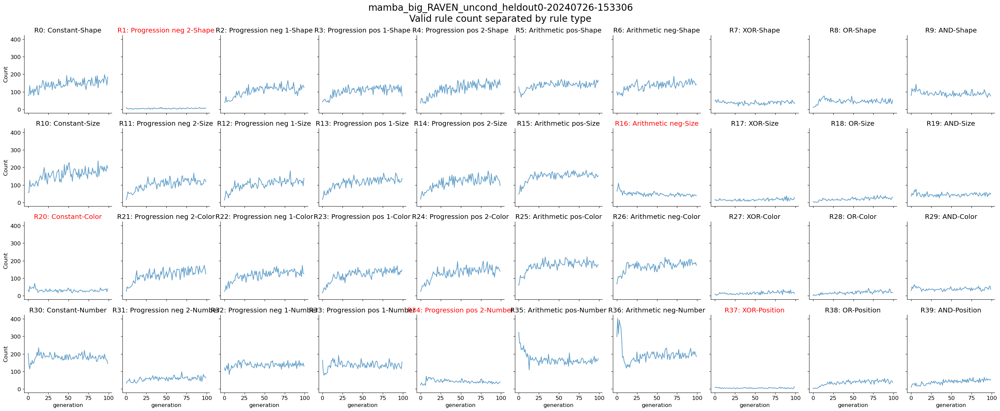

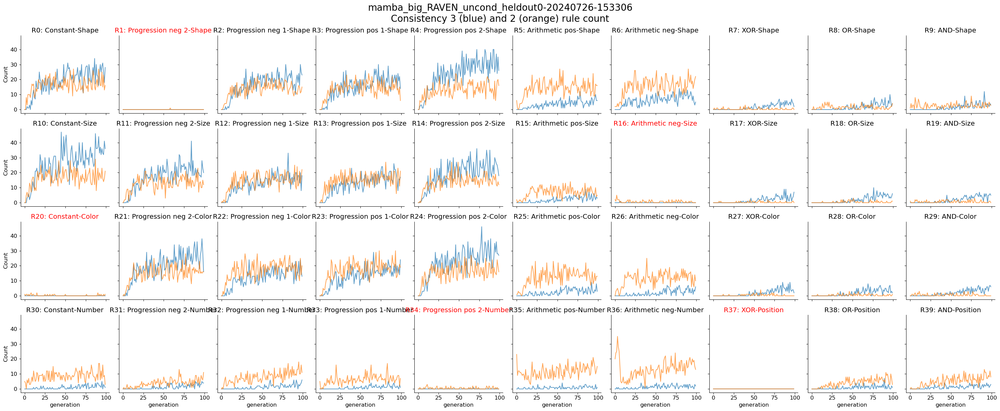

In [ ]:
print(expname)
if "heldout0" in expname:
    heldout_id = [1, 16, 20, 34, 37]  
else:
    heldout_id = []

figh, axs = visualize_indiv_rule_dynam(epoch_list, rule_cnt_mat, conv_wid=1, heldout_id=heldout_id,
                        titlestr=f"{expname}\nValid rule count separated by rule type")
saveallforms(figdir, f"{expname}_indiv_rule_validity", figh)

figh, axs = visualize_indiv_rule_dynam(epoch_list, cons3_rule_cnt_mat, conv_wid=1, heldout_id=heldout_id,
                                       titlestr=f"{expname}\nConsistency 3 (blue) and 2 (orange) rule count", )
figh, axs = visualize_indiv_rule_dynam(epoch_list, cons2_rule_cnt_mat, conv_wid=1, heldout_id=heldout_id,
                                       titlestr=f"{expname}\nConsistency 3 (blue) and 2 (orange) rule count", axs=axs)
saveallforms(figdir, f"{expname}_indiv_rule_consistency", figh)

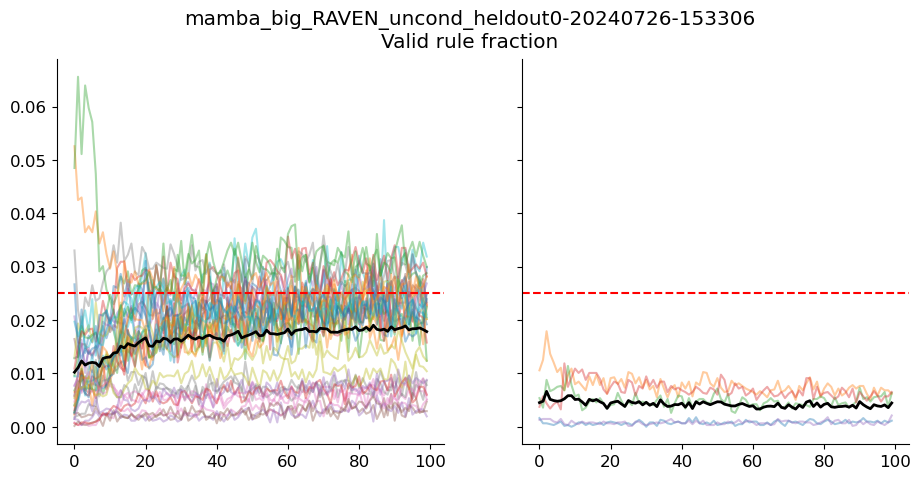

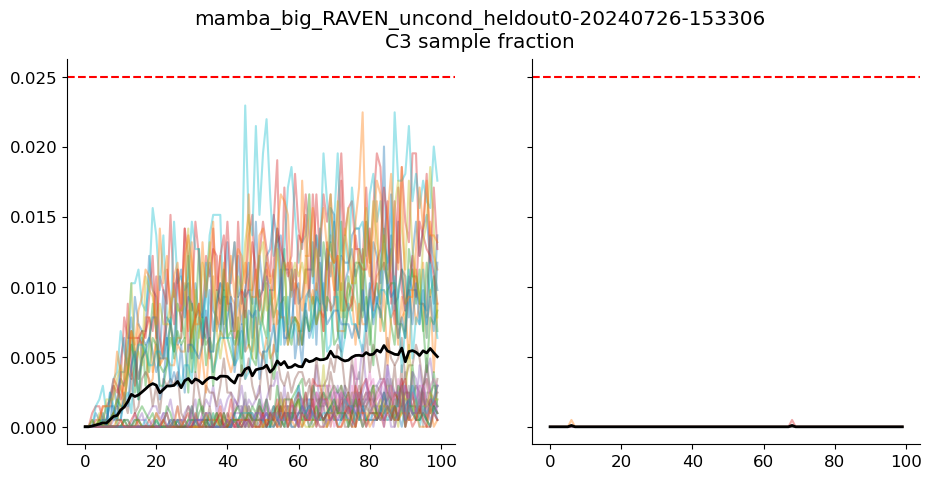

In [ ]:
eval_sample_num = rule_list_all.shape[1]

figh = visualize_train_heldout_rule(epoch_list, rule_cnt_mat, heldout_id, 
                             normalizer=eval_sample_num * 3, reflevel=1 / 40,
                             titlestr=f"{expname}\nValid rule fraction")

figh = visualize_train_heldout_rule(epoch_list, cons3_rule_cnt_mat, heldout_id, 
                            normalizer=eval_sample_num, reflevel=1 / 40,
                            titlestr=f"{expname}\nC3 sample fraction")

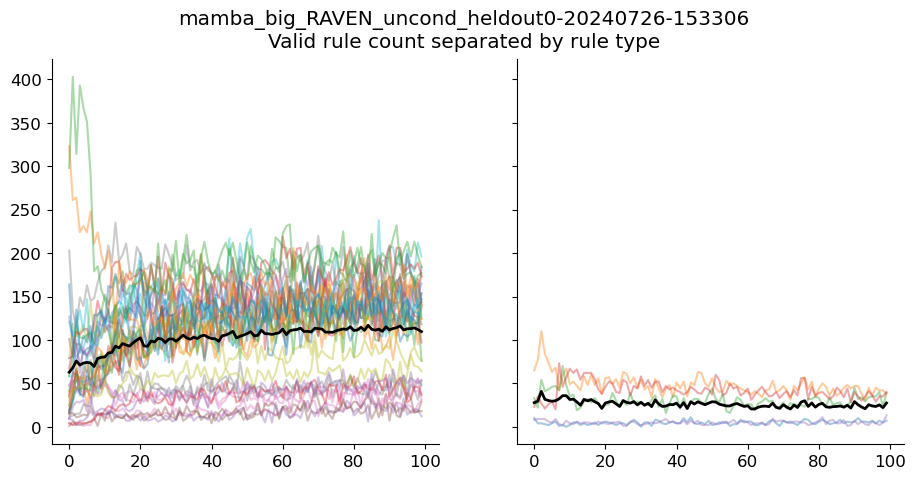

In [ ]:
figh = visualize_train_heldout_rule(epoch_list, rule_cnt_mat, heldout_id, 
        titlestr=f"{expname}\nValid rule count separated by rule type")

## EDM

In [43]:
tb_data_col_EDM = extract_all_runs(EDM_exproot)

Extracted data from WideBlnrX3_new_stream0_16M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs
Extracted data from WideBlnrX3_new_stream0_48M_RAVEN10_abstract_20240705-1908/tensorboard_logs
Extracted data from BigBlnrX3_new_stream0_48M_heldout0_RAVEN10_abstract_20240708-2314/tensorboard_logs
Extracted data from BigBlnrX3_new_stream0_48M_heldout0_RAVEN10_abstract_20240709-1249/tensorboard_logs
Extracted data from BigBlnrX3_new_stream1_6M_RAVEN10_abstract_20240705-1903/tensorboard_logs
Extracted data from BigBlnrX3_new_stream0_16M_heldout0_RAVEN10_abstract_20240708-2052/tensorboard_logs
Extracted data from BigBlnrX3_new_stream16M_RAVEN10_abstract_20240705-0237/tensorboard_logs
Extracted data from WideBlnrX3_new_stream4_8M_heldout0_RAVEN10_abstract_20240708-2207/tensorboard_logs
Extracted data from WideBlnrX3_new_stream16M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs
Extracted data from WideBlnrX3_new_stream4_8M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs

In [ ]:
for key in tb_data_col_EDM.keys():
    print(key)
    if tb_data_col_EDM[key]["step"].max() < 999999:
        print(tb_data_col_EDM[key]["step"].max())
        print("unfinished run") 

In [44]:
def simplify_runname_EDM(run_name):
    return run_name.replace("/tensorboard_logs", "").split("_2024")[0].replace("_RAVEN10_abstract", "")#.replace("_new", "")

syndf_EDM = extract_last_step_summary(tb_data_col_EDM, simplify_runname_EDM, exclude_runs=())
syndf_EDM

tag,Learning Rate,Loss/average,Loss/batch,Rules/anyvalid,Rules/anyvalid_cnt,Rules/c2,Rules/c2_cnt,Rules/c3,Rules/c3_cnt,full_name,step,step/epoch
run_name,,,,,,,,,,,,
WideBlnrX3_new_stream0_16M_heldout0,0.0002,0.643560,0.593999,0.710286,4364.0,0.214355,439.0,0.446777,915.0,WideBlnrX3_new_stream0_16M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs,999999,999999
WideBlnrX3_new_stream0_48M,0.0002,0.638694,0.590333,0.739746,4545.0,0.169922,348.0,0.535645,1097.0,WideBlnrX3_new_stream0_48M_RAVEN10_abstract_20240705-1908/tensorboard_logs,999999,999999
BigBlnrX3_new_stream0_48M_heldout0,0.0002,0.636146,0.614749,0.749023,4602.0,0.129395,265.0,0.600098,1229.0,BigBlnrX3_new_stream0_48M_heldout0_RAVEN10_abstract_20240708-2314/tensorboard_logs,999999,999999
BigBlnrX3_new_stream0_48M_heldout0,0.0002,0.636382,0.616904,0.749512,4605.0,0.145508,298.0,0.596191,1221.0,BigBlnrX3_new_stream0_48M_heldout0_RAVEN10_abstract_20240709-1249/tensorboard_logs,999999,999999
BigBlnrX3_new_stream1_6M,0.0002,0.629097,0.633882,0.745605,4581.0,0.142090,291.0,0.589355,1207.0,BigBlnrX3_new_stream1_6M_RAVEN10_abstract_20240705-1903/tensorboard_logs,999999,999999
BigBlnrX3_new_stream0_16M_heldout0,0.0002,0.708024,0.662795,0.651204,4001.0,0.277832,569.0,0.219238,449.0,BigBlnrX3_new_stream0_16M_heldout0_RAVEN10_abstract_20240708-2052/tensorboard_logs,75200,75000
BigBlnrX3_new_stream16M,0.0002,0.629170,0.621290,0.750814,4613.0,0.132324,271.0,0.600586,1230.0,BigBlnrX3_new_stream16M_RAVEN10_abstract_20240705-0237/tensorboard_logs,999999,999999
WideBlnrX3_new_stream4_8M_heldout0,0.0002,0.647637,0.634478,0.725098,4455.0,0.157227,322.0,0.533691,1093.0,WideBlnrX3_new_stream4_8M_heldout0_RAVEN10_abstract_20240708-2207/tensorboard_logs,999999,999999
WideBlnrX3_new_stream16M_heldout0,0.0002,0.647776,0.636138,0.729492,4482.0,0.162109,332.0,0.538574,1103.0,WideBlnrX3_new_stream16M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs,999999,999999


In [19]:
syndf_EDM.index[syndf_EDM.index.duplicated()]

Index(['BigBlnrX3_stream0_48M_heldout0', 'WideBlnrX3_stream4_8M_heldout0',
       'BigBlnrX3_stream0_48M_heldout0', 'BigBlnrX3_stream0_16M_heldout0',
       'BigBlnrX3_stream0_16M_heldout0', 'WideBlnrX3_stream4_8M_heldout0'],
      dtype='object', name='run_name')

In [45]:
def simplify_runname_EDM(run_name):
    return run_name.replace("/tensorboard_logs", "").split("_2024")[0].replace("_RAVEN10_abstract", "")#.replace("_new", "")

excluded_runs = [
    "BigBlnrX3_new_stream0_16M_heldout0_RAVEN10_abstract_20240708-2052/tensorboard_logs", # 75200
    "WideBlnrX3_new_stream4_8M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs", # 67500
    "BigBlnrX3_new_stream0_48M_heldout0_RAVEN10_abstract_20240708-2052/tensorboard_logs", # 79200
    # "WideBlnrX3_new_stream4_8M_RAVEN10_abstract_20240705-1908/tensorboard_logs",
    ] # 873100

syndf_EDM = extract_last_step_summary(tb_data_col_EDM, simplify_runname_EDM, exclude_runs=excluded_runs)
syndf_EDM

Excluding BigBlnrX3_new_stream0_16M_heldout0_RAVEN10_abstract_20240708-2052/tensorboard_logs
Excluding WideBlnrX3_new_stream4_8M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs
Excluding BigBlnrX3_new_stream0_48M_heldout0_RAVEN10_abstract_20240708-2052/tensorboard_logs


tag,Learning Rate,Loss/average,Loss/batch,Rules/anyvalid,Rules/anyvalid_cnt,Rules/c2,Rules/c2_cnt,Rules/c3,Rules/c3_cnt,full_name,step,step/epoch
run_name,,,,,,,,,,,,
WideBlnrX3_new_stream0_16M_heldout0,0.0002,0.643560,0.593999,0.710286,4364.0,0.214355,439.0,0.446777,915.0,WideBlnrX3_new_stream0_16M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs,999999,999999
WideBlnrX3_new_stream0_48M,0.0002,0.638694,0.590333,0.739746,4545.0,0.169922,348.0,0.535645,1097.0,WideBlnrX3_new_stream0_48M_RAVEN10_abstract_20240705-1908/tensorboard_logs,999999,999999
BigBlnrX3_new_stream0_48M_heldout0,0.0002,0.636146,0.614749,0.749023,4602.0,0.129395,265.0,0.600098,1229.0,BigBlnrX3_new_stream0_48M_heldout0_RAVEN10_abstract_20240708-2314/tensorboard_logs,999999,999999
BigBlnrX3_new_stream0_48M_heldout0,0.0002,0.636382,0.616904,0.749512,4605.0,0.145508,298.0,0.596191,1221.0,BigBlnrX3_new_stream0_48M_heldout0_RAVEN10_abstract_20240709-1249/tensorboard_logs,999999,999999
BigBlnrX3_new_stream1_6M,0.0002,0.629097,0.633882,0.745605,4581.0,0.142090,291.0,0.589355,1207.0,BigBlnrX3_new_stream1_6M_RAVEN10_abstract_20240705-1903/tensorboard_logs,999999,999999
BigBlnrX3_new_stream16M,0.0002,0.629170,0.621290,0.750814,4613.0,0.132324,271.0,0.600586,1230.0,BigBlnrX3_new_stream16M_RAVEN10_abstract_20240705-0237/tensorboard_logs,999999,999999
WideBlnrX3_new_stream4_8M_heldout0,0.0002,0.647637,0.634478,0.725098,4455.0,0.157227,322.0,0.533691,1093.0,WideBlnrX3_new_stream4_8M_heldout0_RAVEN10_abstract_20240708-2207/tensorboard_logs,999999,999999
WideBlnrX3_new_stream16M_heldout0,0.0002,0.647776,0.636138,0.729492,4482.0,0.162109,332.0,0.538574,1103.0,WideBlnrX3_new_stream16M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs,999999,999999
WideBlnrX3_new_stream0_16M,0.0002,0.638031,0.592863,0.748047,4596.0,0.209473,429.0,0.494629,1013.0,WideBlnrX3_new_stream0_16M_RAVEN10_abstract_20240705-1908/tensorboard_logs,999999,999999


In [46]:
tabdir = "/n/home12/binxuwang/Github/DiffusionReasoning/Tables"
syndf_EDM.to_csv(join(tabdir, "EDM_raven_tensorboard_data.csv"))
pkl.dump(tb_data_col_EDM, open(join(tabdir, "EDM_raven_tensorboard_raw_data.pkl"), "wb"))

In [12]:
syndf_EDM = pd.read_csv(join(tabdir, "EDM_raven_tensorboard_data.csv"), index_col=0)
tb_data_col_EDM = pkl.load(open(join(tabdir, "EDM_raven_tensorboard_raw_data.pkl"), "rb"))

### Synopsis of models

In [14]:
syndf_EDM["heldout"] = syndf_EDM.index.map(lambda x: "_heldout0" in x)
syndf_EDM["scale"] = syndf_EDM.index.map(lambda x: 3 if "BigBlnrX3" in x else 2 if "WideBlnrX3" in x else 1)
syndf_EDM["dataset_size"] = syndf_EDM.index.map(extract_and_convert) * 1E6

In [49]:
syndf_EDM_sorted = syndf_EDM.sort_values(by=["heldout", "scale", "dataset_size"], ascending=[False, True, True])
syndf_EDM_sorted

tag,Learning Rate,Loss/average,Loss/batch,Rules/anyvalid,Rules/anyvalid_cnt,Rules/c2,Rules/c2_cnt,Rules/c3,Rules/c3_cnt,full_name,step,step/epoch,heldout,scale,dataset_size
run_name,,,,,,,,,,,,,,,
WideBlnrX3_new_stream0_16M_heldout0,0.0002,0.643560,0.593999,0.710286,4364.0,0.214355,439.0,0.446777,915.0,WideBlnrX3_new_stream0_16M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs,999999,999999,True,2,160000.0
WideBlnrX3_new_stream0_48M_heldout0,0.0002,0.646984,0.625755,0.754232,4634.0,0.165039,338.0,0.552246,1131.0,WideBlnrX3_new_stream0_48M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs,999999,999999,True,2,480000.0
WideBlnrX3_new_stream1_6M_heldout0,0.0002,0.647314,0.643767,0.716960,4405.0,0.155273,318.0,0.525391,1076.0,WideBlnrX3_new_stream1_6M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs,999999,999999,True,2,1600000.0
WideBlnrX3_new_stream4_8M_heldout0,0.0002,0.647637,0.634478,0.725098,4455.0,0.157227,322.0,0.533691,1093.0,WideBlnrX3_new_stream4_8M_heldout0_RAVEN10_abstract_20240708-2207/tensorboard_logs,999999,999999,True,2,4800000.0
WideBlnrX3_new_stream4_8M_heldout0,0.0002,0.646791,0.635782,0.724284,4450.0,0.158203,324.0,0.532227,1090.0,WideBlnrX3_new_stream4_8M_heldout0_RAVEN10_abstract_20240709-1249/tensorboard_logs,999999,999999,True,2,4800000.0
WideBlnrX3_new_stream16M_heldout0,0.0002,0.647776,0.636138,0.729492,4482.0,0.162109,332.0,0.538574,1103.0,WideBlnrX3_new_stream16M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs,999999,999999,True,2,16000000.0
BigBlnrX3_new_stream0_16M_heldout0,0.0002,0.625357,0.557646,0.700684,4305.0,0.240234,492.0,0.405273,830.0,BigBlnrX3_new_stream0_16M_heldout0_RAVEN10_abstract_20240708-2308/tensorboard_logs,999999,999999,True,3,160000.0
BigBlnrX3_new_stream0_16M_heldout0,0.0002,0.624024,0.550257,0.700521,4304.0,0.240234,492.0,0.404785,829.0,BigBlnrX3_new_stream0_16M_heldout0_RAVEN10_abstract_20240709-1249/tensorboard_logs,999999,999999,True,3,160000.0
BigBlnrX3_new_stream0_48M_heldout0,0.0002,0.636146,0.614749,0.749023,4602.0,0.129395,265.0,0.600098,1229.0,BigBlnrX3_new_stream0_48M_heldout0_RAVEN10_abstract_20240708-2314/tensorboard_logs,999999,999999,True,3,480000.0


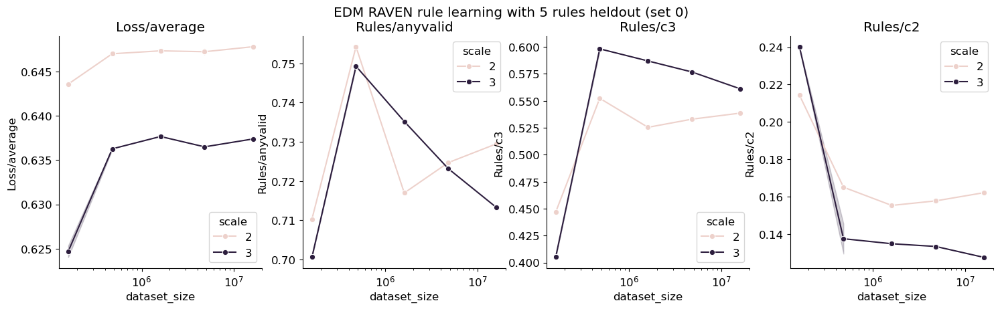

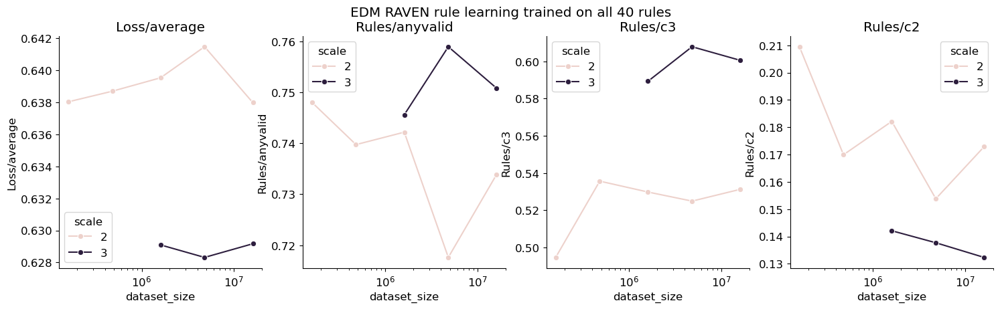

In [58]:
figh, axs = plt.subplots(1, 4, figsize=(18, 4.5), sharex=True, squeeze=False)
for ax, metric in zip(axs[0, :], ["Loss/average", "Rules/anyvalid", "Rules/c3", "Rules/c2",]):
    # sns.barplot(data=syndf_EDM_sorted[syndf_EDM_sorted.heldout==True], x="dataset_size", y=metric, 
    #             hue="scale", ax=ax)
    sns.lineplot(data=syndf_EDM[syndf_EDM.heldout==True], x="dataset_size", y=metric, 
                    hue="scale", ax=ax, marker='o', )
    ax.set_title(metric)
    plt.xscale('log')
plt.suptitle("EDM RAVEN rule learning with 5 rules heldout (set 0)")
plt.show()

figh, axs = plt.subplots(1, 4, figsize=(18, 4.5), sharex=True, squeeze=False)
for ax, metric in zip(axs[0, :], ["Loss/average", "Rules/anyvalid", "Rules/c3", "Rules/c2",]):
    # sns.barplot(data=syndf_EDM_sorted[syndf_EDM_sorted.heldout==True], x="dataset_size", y=metric, 
    #             hue="scale", ax=ax)
    sns.lineplot(data=syndf_EDM[syndf_EDM.heldout==False], x="dataset_size", y=metric, 
                    hue="scale", ax=ax, marker='o', )
    ax.set_title(metric)
    plt.xscale('log')
plt.suptitle("EDM RAVEN rule learning trained on all 40 rules")
plt.show()

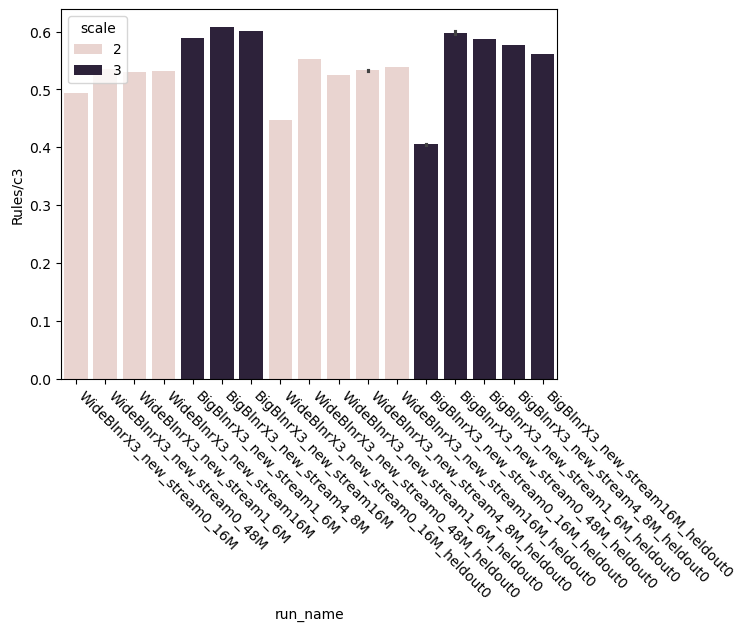

In [68]:
syndf_EDM_sorted = syndf_EDM.sort_values(by=["heldout", "scale", "dataset_size", ], ascending=[True, True, True])
sns.barplot(data=syndf_EDM_sorted, x="run_name", y="Rules/c3", hue="scale")
plt.xticks(rotation=-45, ha='left')
plt.show()

### General learning dynamics

In [15]:
syndf_EDM

,Learning Rate,Loss/average,Loss/batch,Rules/anyvalid,Rules/anyvalid_cnt,Rules/c2,Rules/c2_cnt,Rules/c3,Rules/c3_cnt,full_name,step,step/epoch,heldout,scale,dataset_size
run_name,,,,,,,,,,,,,,,
WideBlnrX3_new_stream0_16M_heldout0,0.0002,0.643560,0.593999,0.710286,4364.0,0.214355,439.0,0.446777,915.0,WideBlnrX3_new_stream0_16M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs,999999,999999,True,2,160000.0
WideBlnrX3_new_stream0_48M,0.0002,0.638694,0.590333,0.739746,4545.0,0.169922,348.0,0.535645,1097.0,WideBlnrX3_new_stream0_48M_RAVEN10_abstract_20240705-1908/tensorboard_logs,999999,999999,False,2,480000.0
BigBlnrX3_new_stream0_48M_heldout0,0.0002,0.636146,0.614749,0.749023,4602.0,0.129395,265.0,0.600098,1229.0,BigBlnrX3_new_stream0_48M_heldout0_RAVEN10_abstract_20240708-2314/tensorboard_logs,999999,999999,True,3,480000.0
BigBlnrX3_new_stream0_48M_heldout0,0.0002,0.636382,0.616904,0.749512,4605.0,0.145508,298.0,0.596191,1221.0,BigBlnrX3_new_stream0_48M_heldout0_RAVEN10_abstract_20240709-1249/tensorboard_logs,999999,999999,True,3,480000.0
BigBlnrX3_new_stream1_6M,0.0002,0.629097,0.633882,0.745605,4581.0,0.142090,291.0,0.589355,1207.0,BigBlnrX3_new_stream1_6M_RAVEN10_abstract_20240705-1903/tensorboard_logs,999999,999999,False,3,1600000.0
BigBlnrX3_new_stream16M,0.0002,0.629170,0.621290,0.750814,4613.0,0.132324,271.0,0.600586,1230.0,BigBlnrX3_new_stream16M_RAVEN10_abstract_20240705-0237/tensorboard_logs,999999,999999,False,3,16000000.0
WideBlnrX3_new_stream4_8M_heldout0,0.0002,0.647637,0.634478,0.725098,4455.0,0.157227,322.0,0.533691,1093.0,WideBlnrX3_new_stream4_8M_heldout0_RAVEN10_abstract_20240708-2207/tensorboard_logs,999999,999999,True,2,4800000.0
WideBlnrX3_new_stream16M_heldout0,0.0002,0.647776,0.636138,0.729492,4482.0,0.162109,332.0,0.538574,1103.0,WideBlnrX3_new_stream16M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs,999999,999999,True,2,16000000.0
WideBlnrX3_new_stream0_16M,0.0002,0.638031,0.592863,0.748047,4596.0,0.209473,429.0,0.494629,1013.0,WideBlnrX3_new_stream0_16M_RAVEN10_abstract_20240705-1908/tensorboard_logs,999999,999999,False,2,160000.0


In [62]:
tb_record.tag.unique()

array(['Loss/average', 'Loss/batch', 'Learning Rate', 'Rules/c3_cnt',
       'Rules/c2_cnt', 'Rules/anyvalid_cnt', 'Rules/c3', 'Rules/c2',
       'Rules/anyvalid'], dtype=object)

WideBlnrX3_new_stream0_16M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs


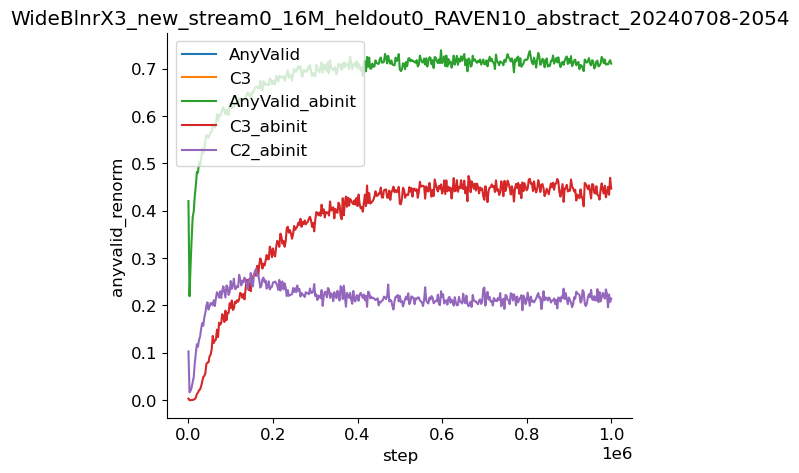

WideBlnrX3_new_stream0_48M_RAVEN10_abstract_20240705-1908/tensorboard_logs


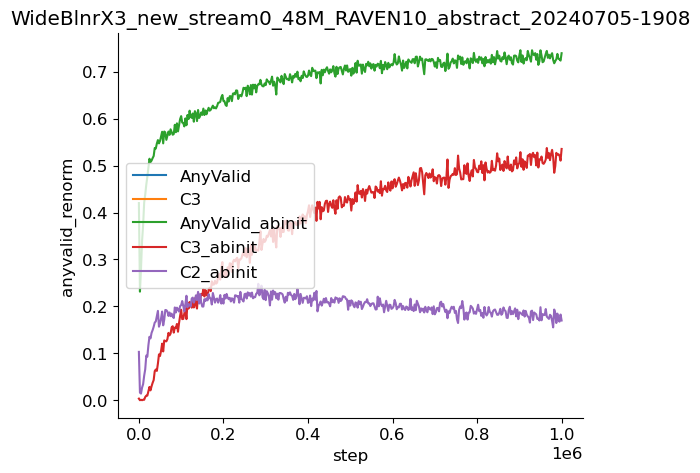

BigBlnrX3_new_stream0_48M_heldout0_RAVEN10_abstract_20240708-2314/tensorboard_logs


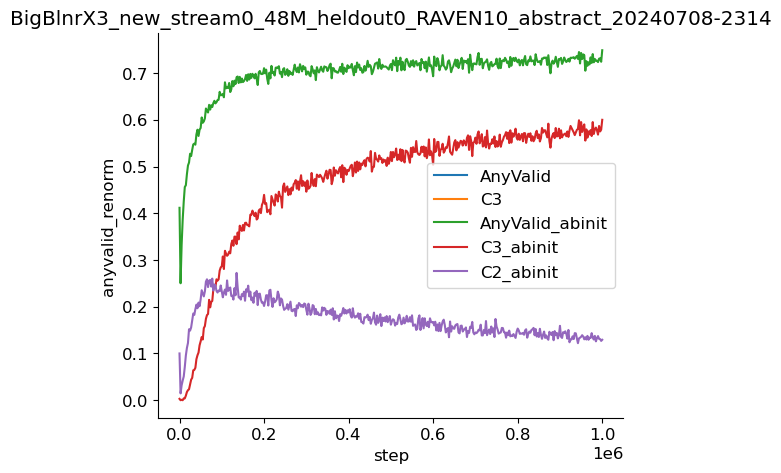

BigBlnrX3_new_stream0_48M_heldout0_RAVEN10_abstract_20240709-1249/tensorboard_logs


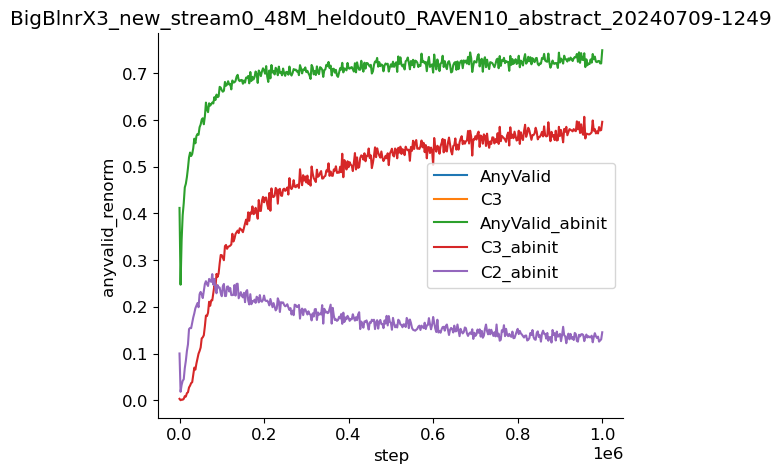

BigBlnrX3_new_stream1_6M_RAVEN10_abstract_20240705-1903/tensorboard_logs


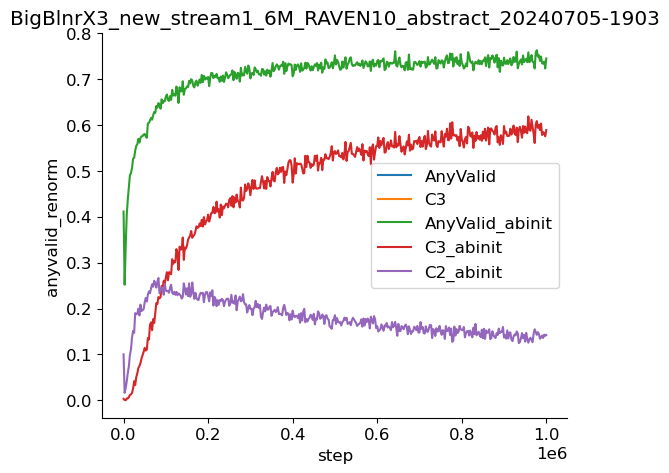

BigBlnrX3_new_stream16M_RAVEN10_abstract_20240705-0237/tensorboard_logs


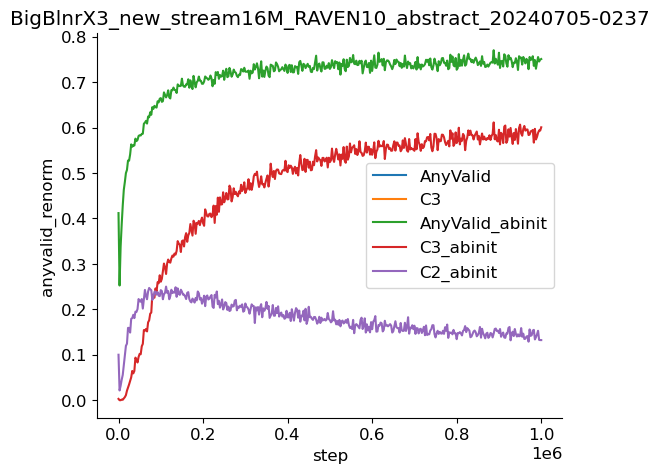

WideBlnrX3_new_stream4_8M_heldout0_RAVEN10_abstract_20240708-2207/tensorboard_logs


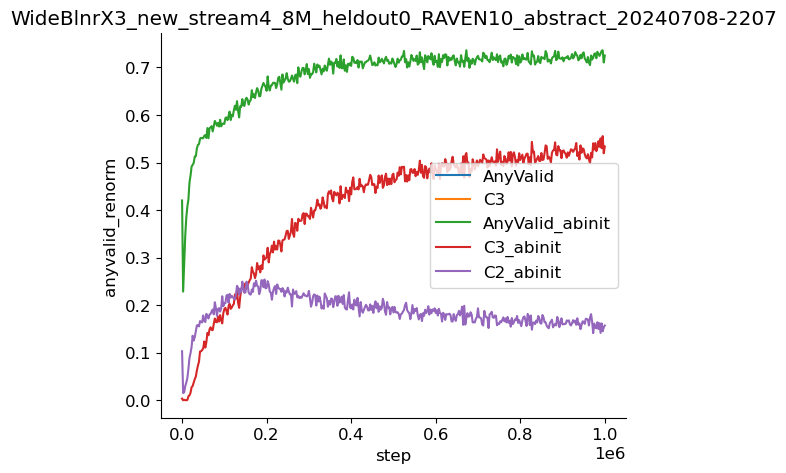

WideBlnrX3_new_stream16M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs


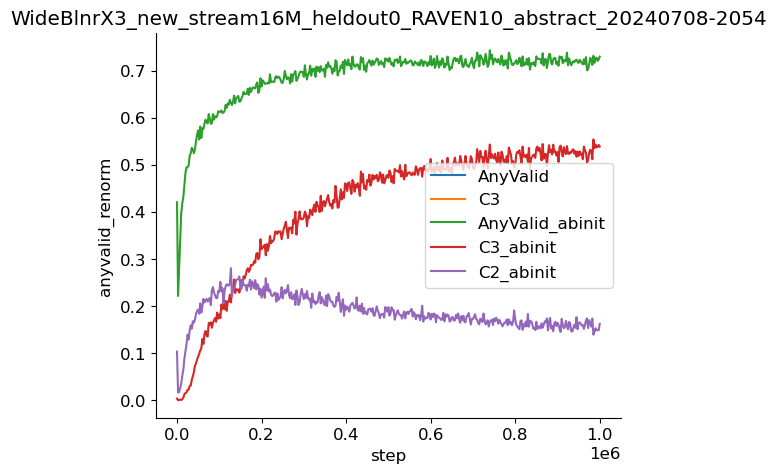

WideBlnrX3_new_stream0_16M_RAVEN10_abstract_20240705-1908/tensorboard_logs


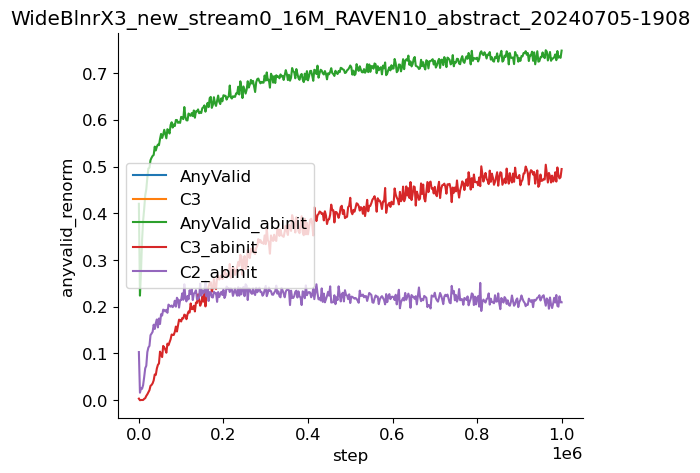

BigBlnrX3_new_stream0_16M_heldout0_RAVEN10_abstract_20240708-2308/tensorboard_logs


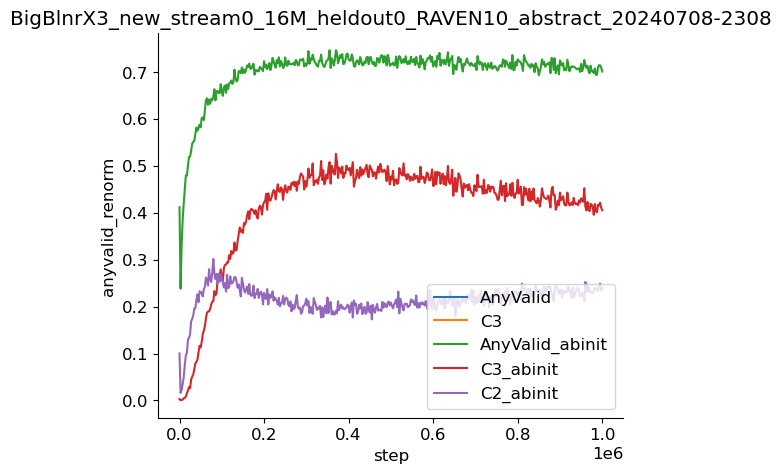

WideBlnrX3_new_stream0_48M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs


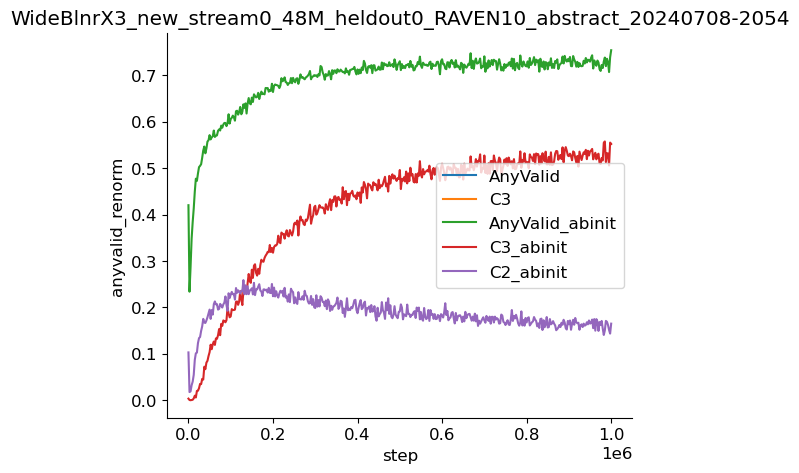

WideBlnrX3_new_stream1_6M_heldout0_RAVEN10_abstract_20240708-2054/tensorboard_logs


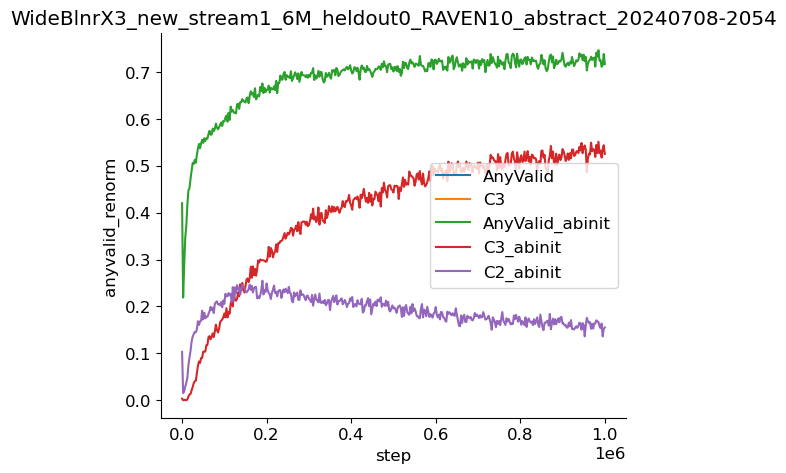

BigBlnrX3_new_stream0_16M_heldout0_RAVEN10_abstract_20240709-1249/tensorboard_logs


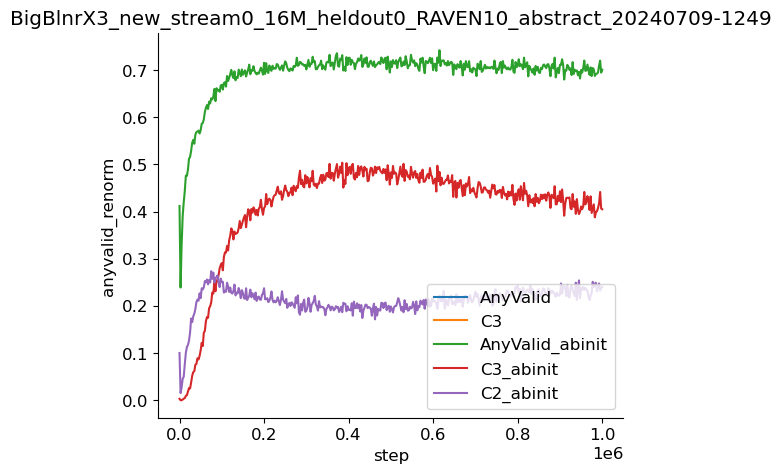

WideBlnrX3_new_stream4_8M_RAVEN10_abstract_20240705-1908/tensorboard_logs


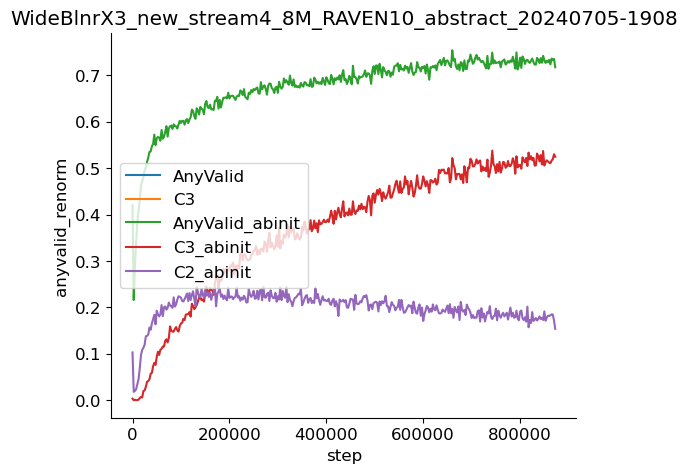

BigBlnrX3_new_stream1_6M_heldout0_RAVEN10_abstract_20240708-2052/tensorboard_logs


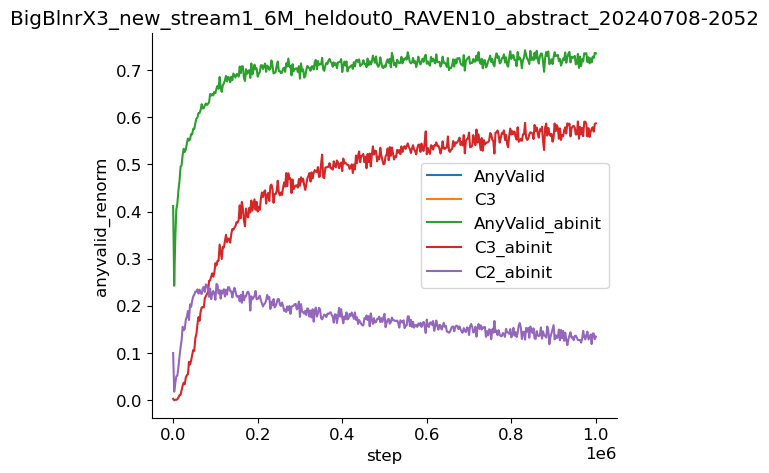

WideBlnrX3_new_stream1_6M_RAVEN10_abstract_20240705-1908/tensorboard_logs


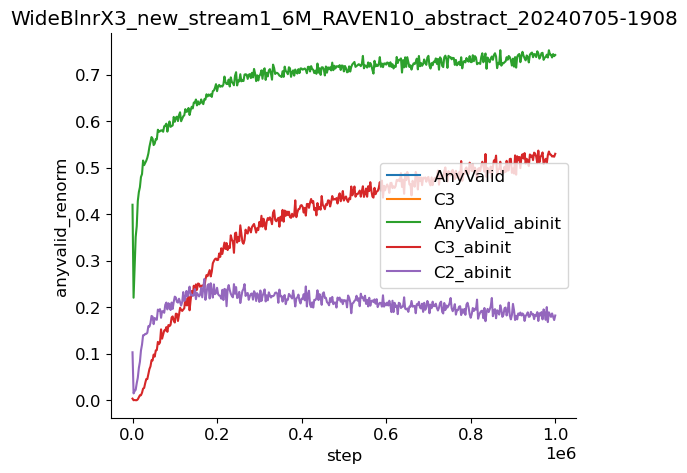

WideBlnrX3_new_stream16M_RAVEN10_abstract_20240705-0023/tensorboard_logs


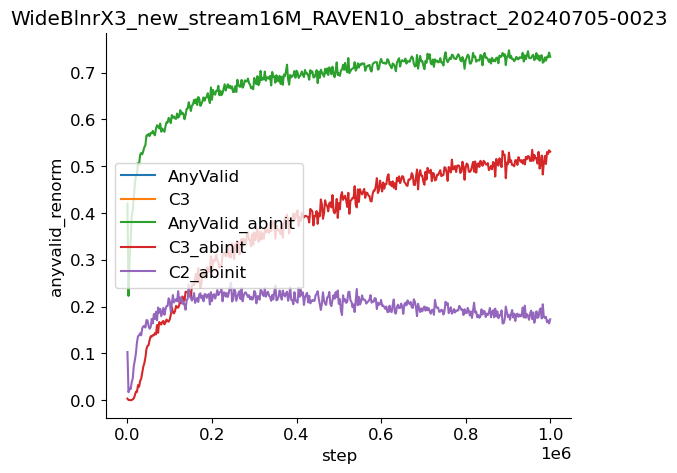

BigBlnrX3_new_stream4_8M_RAVEN10_abstract_20240705-1903/tensorboard_logs


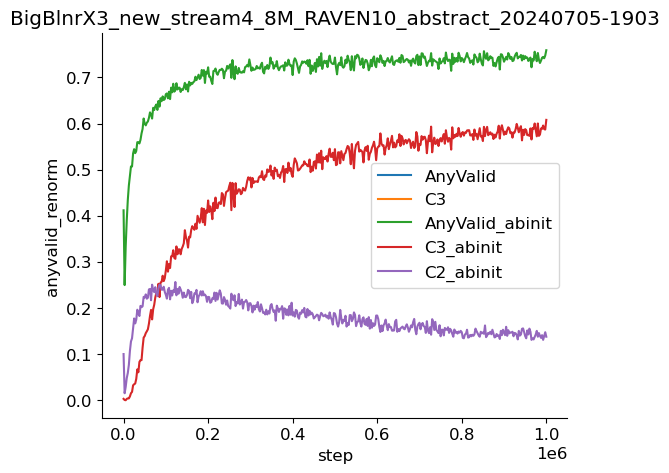

BigBlnrX3_new_stream16M_heldout0_RAVEN10_abstract_20240708-2052/tensorboard_logs


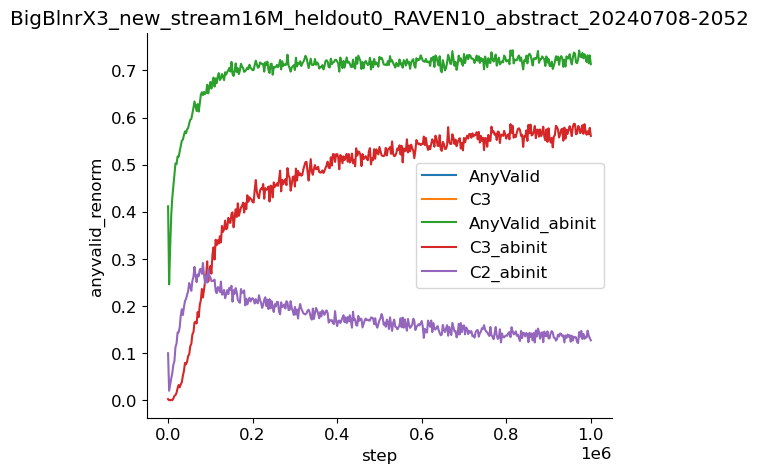

BigBlnrX3_new_stream4_8M_heldout0_RAVEN10_abstract_20240708-2052/tensorboard_logs


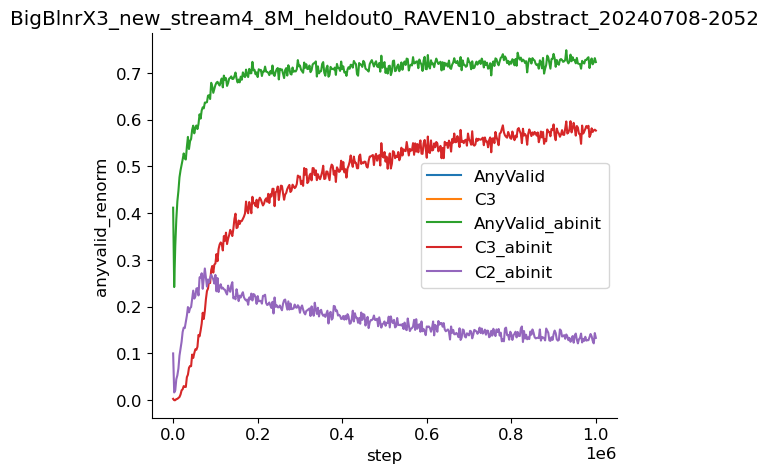

WideBlnrX3_new_stream4_8M_heldout0_RAVEN10_abstract_20240709-1249/tensorboard_logs


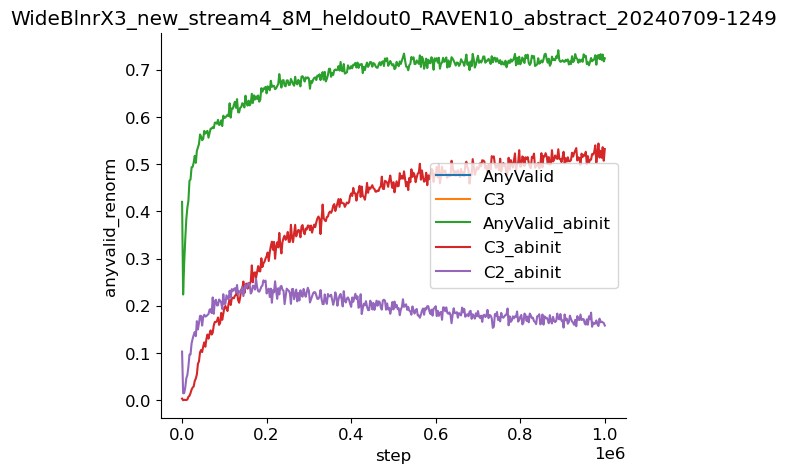

In [63]:
for expfullname in syndf_EDM.full_name:
    tb_record = tb_data_col_EDM[expfullname]
    expname = expfullname.split("/")[0]
    print(expfullname)
    # print(tb_record.keys())
    # print(tb_record['tag'].unique())    
    tb_anyvalid = tb_record[tb_record.tag=='Val/AnyValid']
    tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3
    figh = plt.figure(figsize=(6, 5))
    sns.lineplot(data=tb_anyvalid, x='step', y='anyvalid_renorm', label='AnyValid')
    sns.lineplot(data=tb_record[tb_record.tag=='Val/C3'], x='step', y='value', label='C3')
    # sns.lineplot(data=tb_record[tb_record.tag=='Val/AnyValid'], x='step', y='value', label='AnyValid')
    sns.lineplot(data=tb_record[tb_record.tag=='Rules/anyvalid'], x='step', y='value', label='AnyValid_abinit')
    sns.lineplot(data=tb_record[tb_record.tag=='Rules/c3'], x='step', y='value', label='C3_abinit')
    sns.lineplot(data=tb_record[tb_record.tag=='Rules/c2'], x='step', y='value', label='C2_abinit')
    plt.legend() # ['Val/C3', 'Val/C3_abinit', 'Val/C2_abinit', 'Val/AnyValid_abinit']
    plt.title(expname)
    saveallforms(EDMfigdir, f"{expname}_valid_consist_summary", figh)
    plt.show()
    # raise ValueError

### Individual rule learning dynamics

In [21]:
list(eval_col[0])

['c3_list', 'c2_list', 'rule_col', 'c3_cnt', 'c2_cnt', 'anyvalid_cnt', 'total']

In [26]:
epoch_list, rule_list_all, consistency_all = extract_rule_list_from_eval_col_Diffusion(eval_col, )
rule_cnt_mat, cons3_rule_cnt_mat, cons2_rule_cnt_mat = format_rule_list_to_mat(rule_list_all, consistency_all)
eval_sample_num = rule_list_all.shape[1]


diffusion model, just fetch ab init generation
(401, 2048, 3) (401, 2, 2048)


In [ ]:
for expfullname in syndf_EDM.full_name:
    tb_record = tb_data_col_EDM[expfullname]
    expname = expfullname.split("/tensorboard_logs")[0]
    prefix = "sample_rule_eval_" #"eval_step" if "stream" in expname else "eval_epoch"
    eval_col = sweep_collect_eval_data(expname, EDM_exproot, prefix=prefix)
    epoch_list, rule_list_all, consistency_all = extract_rule_list_from_eval_col_Diffusion(eval_col, )
    rule_cnt_mat, cons3_rule_cnt_mat, cons2_rule_cnt_mat = format_rule_list_to_mat(rule_list_all, consistency_all)
    eval_sample_num = rule_list_all.shape[1]
    print(expname)
    if "heldout0" in expname:
        heldout_id = [1, 16, 20, 34, 37]  
    else:
        heldout_id = []

    figh, axs = visualize_indiv_rule_dynam(epoch_list, rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                            titlestr=f"{expname}\nValid rule count separated by rule type")
    saveallforms(EDMfigdir, f"{expname}_indiv_rule_validity", figh)

    figh, axs = visualize_indiv_rule_dynam(epoch_list, cons3_rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                                        titlestr=f"{expname}\nConsistency 3 (blue) and 2 (orange) rule count", )
    figh, axs = visualize_indiv_rule_dynam(epoch_list, cons2_rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                                        titlestr=f"{expname}\nConsistency 3 (blue) and 2 (orange) rule count", axs=axs)
    saveallforms(EDMfigdir, f"{expname}_indiv_rule_consistency", figh)
    
    figh = visualize_train_heldout_rule(epoch_list, rule_cnt_mat, heldout_id, 
                                normalizer=eval_sample_num * 3, reflevel=1 / 40,
                                titlestr=f"{expname}\nValid rule fraction")
    saveallforms(EDMfigdir, f"{expname}_train_held_rule_validity", figh)

    figh = visualize_train_heldout_rule(epoch_list, cons3_rule_cnt_mat, heldout_id, 
                                normalizer=eval_sample_num, reflevel=1 / 40,
                                titlestr=f"{expname}\nC3 sample fraction")
    saveallforms(EDMfigdir, f"{expname}_train_held_rule_consistency", figh)

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/mini_edm/exps/WideBlnrX3_new_stream0_16M_heldout0_RAVEN10_abstract_20240708-2054/samples
example file: tensor_557500.pt


  0%|          | 0/401 [00:00<?, ?it/s]

TypeError: extract_rule_list_from_eval_col_Diffusion() got an unexpected keyword argument 'is_abinit'

## DiT

In [12]:
tb_data_col_DiT = extract_all_runs(DiT_exproot)

Extracted data from 096-RAVEN10_abstract-uncond-DiT_B_1-stream0_16M_20240711-0205/tensorboard_logs
Extracted data from 091-RAVEN10_abstract-uncond-DiT_B_1-stream16M_20240711-0205/tensorboard_logs
Extracted data from 085-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_20240711-0204/tensorboard_logs
Extracted data from 087-RAVEN10_abstract-uncond-DiT_S_1-stream16M_20240711-0204/tensorboard_logs
Extracted data from 090-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_heldout0_20240711-0204/tensorboard_logs
Extracted data from 095-RAVEN10_abstract-uncond-DiT_B_1-stream16M_heldout0_20240711-0205/tensorboard_logs
Extracted data from 084-RAVEN10_abstract-uncond-DiT_B_1-stream16M_20240711-0200/tensorboard_logs
Extracted data from 086-RAVEN10_abstract-uncond-DiT_S_1-stream1_6M_20240711-0204/tensorboard_logs
Extracted data from 083-RAVEN10_abstract-uncond-DiT_S_1-stream16M_20240711-0149/tensorboard_logs
Extracted data from 092-RAVEN10_abstract-uncond-DiT_B_1-stream1_6M_20240711-0205/tensorboard_logs
Extr

In [69]:
for key in tb_data_col_DiT.keys():
    print(key)
    if tb_data_col_DiT[key]["step"].max() < 999999:
        print(tb_data_col_DiT[key]["step"].max())
        print("unfinished run") 

096-RAVEN10_abstract-uncond-DiT_B_1-stream0_16M_20240711-0205/tensorboard_logs
091-RAVEN10_abstract-uncond-DiT_B_1-stream16M_20240711-0205/tensorboard_logs
085-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_20240711-0204/tensorboard_logs
087-RAVEN10_abstract-uncond-DiT_S_1-stream16M_20240711-0204/tensorboard_logs
090-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_heldout0_20240711-0204/tensorboard_logs
095-RAVEN10_abstract-uncond-DiT_B_1-stream16M_heldout0_20240711-0205/tensorboard_logs
084-RAVEN10_abstract-uncond-DiT_B_1-stream16M_20240711-0200/tensorboard_logs
8900
unfinished run
086-RAVEN10_abstract-uncond-DiT_S_1-stream1_6M_20240711-0204/tensorboard_logs
083-RAVEN10_abstract-uncond-DiT_S_1-stream16M_20240711-0149/tensorboard_logs
9500
unfinished run
092-RAVEN10_abstract-uncond-DiT_B_1-stream1_6M_20240711-0205/tensorboard_logs
089-RAVEN10_abstract-uncond-DiT_S_1-stream1_6M_heldout0_20240711-0204/tensorboard_logs
093-RAVEN10_abstract-uncond-DiT_B_1-stream1_6M_heldout0_20240711-0205/tensorb

In [13]:
simplify_runname = lambda x: x.replace("/tensorboard_logs", "").split("_2024")[0].replace("RAVEN10_abstract-", "")
syndf_DiT = extract_last_step_summary(tb_data_col_DiT, simplify_runname, ())
syndf_DiT

tag,Loss/average,Loss/batch,Rules/anyvalid,Rules/anyvalid_cnt,Rules/c2,Rules/c2_cnt,Rules/c3,Rules/c3_cnt,Speed/steps_per_sec,full_name,step,step/epoch
run_name,,,,,,,,,,,,
096-uncond-DiT_B_1-stream0_16M,0.093656,0.089743,0.756673,4649.0,0.130371,267.0,0.604004,1237.0,8.781941,096-RAVEN10_abstract-uncond-DiT_B_1-stream0_16M_20240711-0205/tensorboard_logs,1000000,1000000
091-uncond-DiT_B_1-stream16M,0.093849,0.094762,0.754069,4633.0,0.125000,256.0,0.603027,1235.0,8.272856,091-RAVEN10_abstract-uncond-DiT_B_1-stream16M_20240711-0205/tensorboard_logs,1000000,1000000
085-uncond-DiT_S_1-stream0_16M,0.094453,0.089580,0.737956,4534.0,0.111816,229.0,0.595703,1220.0,18.965296,085-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_20240711-0204/tensorboard_logs,1000000,1000000
087-uncond-DiT_S_1-stream16M,0.094620,0.098189,0.780762,4797.0,0.122559,251.0,0.633789,1298.0,16.748566,087-RAVEN10_abstract-uncond-DiT_S_1-stream16M_20240711-0204/tensorboard_logs,1000000,1000000
090-uncond-DiT_S_1-stream0_16M_heldout0,0.095534,0.094757,0.734701,4514.0,0.142090,291.0,0.571289,1170.0,18.949669,090-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_heldout0_20240711-0204/tensorboard_logs,1000000,1000000
095-uncond-DiT_B_1-stream16M_heldout0,0.096062,0.096317,0.756348,4647.0,0.141113,289.0,0.594727,1218.0,8.739494,095-RAVEN10_abstract-uncond-DiT_B_1-stream16M_heldout0_20240711-0205/tensorboard_logs,1000000,1000000
084-uncond-DiT_B_1-stream16M,0.112006,0.116013,0.487793,2997.0,0.060547,124.0,0.000000,0.0,8.792282,084-RAVEN10_abstract-uncond-DiT_B_1-stream16M_20240711-0200/tensorboard_logs,8900,7500
086-uncond-DiT_S_1-stream1_6M,0.094237,0.098248,0.792806,4871.0,0.117676,241.0,0.650391,1332.0,18.855453,086-RAVEN10_abstract-uncond-DiT_S_1-stream1_6M_20240711-0204/tensorboard_logs,1000000,1000000
083-uncond-DiT_S_1-stream16M,0.112773,0.121929,0.486003,2986.0,0.062988,129.0,0.000488,1.0,19.033159,083-RAVEN10_abstract-uncond-DiT_S_1-stream16M_20240711-0149/tensorboard_logs,9500,7500


In [14]:
simplify_runname = lambda x: x.replace("/tensorboard_logs", "").split("_2024")[0].replace("RAVEN10_abstract-", "")
excluded_runs = [
    "084-RAVEN10_abstract-uncond-DiT_B_1-stream16M_20240711-0200/tensorboard_logs",
    "083-RAVEN10_abstract-uncond-DiT_S_1-stream16M_20240711-0149/tensorboard_logs",
]
syndf_DiT = extract_last_step_summary(tb_data_col_DiT, simplify_runname, excluded_runs)

Excluding 084-RAVEN10_abstract-uncond-DiT_B_1-stream16M_20240711-0200/tensorboard_logs
Excluding 083-RAVEN10_abstract-uncond-DiT_S_1-stream16M_20240711-0149/tensorboard_logs


In [15]:
syndf_DiT.to_csv(join(tabdir, "DiT_raven_tensorboard_data.csv"))
pkl.dump(tb_data_col_DiT, open(join(tabdir, "DiT_raven_tensorboard_raw_data.pkl"), "wb"))

### Synopsis of models

In [16]:
syndf_DiT = pd.read_csv(join(tabdir, "DiT_raven_tensorboard_data.csv"), index_col=0)
tb_data_col_DiT = pkl.load(open(join(tabdir, "DiT_raven_tensorboard_raw_data.pkl"), "rb"))

In [19]:
syndf_DiT["dataset_size"] = syndf_DiT.index.map(extract_and_convert)
syndf_DiT["heldout"] = syndf_DiT.index.map(lambda x: "_heldout0" in x)
syndf_DiT["scale"] = syndf_DiT.index.map(lambda x: "DiT_B_1" if "DiT_B_1" in x else "DiT_S_1" if "DiT_S_1" in x else None)

In [20]:
syndf_DiT

,Loss/average,Loss/batch,Rules/anyvalid,Rules/anyvalid_cnt,Rules/c2,Rules/c2_cnt,Rules/c3,Rules/c3_cnt,Speed/steps_per_sec,full_name,step,step/epoch,dataset_size,heldout,scale
run_name,,,,,,,,,,,,,,,
096-uncond-DiT_B_1-stream0_16M,0.093656,0.089743,0.756673,4649.0,0.130371,267.0,0.604004,1237.0,8.781941,096-RAVEN10_abstract-uncond-DiT_B_1-stream0_16M_20240711-0205/tensorboard_logs,1000000,1000000,0.16,False,DiT_B_1
091-uncond-DiT_B_1-stream16M,0.093849,0.094762,0.754069,4633.0,0.125000,256.0,0.603027,1235.0,8.272856,091-RAVEN10_abstract-uncond-DiT_B_1-stream16M_20240711-0205/tensorboard_logs,1000000,1000000,16.00,False,DiT_B_1
085-uncond-DiT_S_1-stream0_16M,0.094453,0.089580,0.737956,4534.0,0.111816,229.0,0.595703,1220.0,18.965296,085-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_20240711-0204/tensorboard_logs,1000000,1000000,0.16,False,DiT_S_1
087-uncond-DiT_S_1-stream16M,0.094620,0.098189,0.780762,4797.0,0.122559,251.0,0.633789,1298.0,16.748566,087-RAVEN10_abstract-uncond-DiT_S_1-stream16M_20240711-0204/tensorboard_logs,1000000,1000000,16.00,False,DiT_S_1
090-uncond-DiT_S_1-stream0_16M_heldout0,0.095534,0.094757,0.734701,4514.0,0.142090,291.0,0.571289,1170.0,18.949669,090-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_heldout0_20240711-0204/tensorboard_logs,1000000,1000000,0.16,True,DiT_S_1
095-uncond-DiT_B_1-stream16M_heldout0,0.096062,0.096317,0.756348,4647.0,0.141113,289.0,0.594727,1218.0,8.739494,095-RAVEN10_abstract-uncond-DiT_B_1-stream16M_heldout0_20240711-0205/tensorboard_logs,1000000,1000000,16.00,True,DiT_B_1
086-uncond-DiT_S_1-stream1_6M,0.094237,0.098248,0.792806,4871.0,0.117676,241.0,0.650391,1332.0,18.855453,086-RAVEN10_abstract-uncond-DiT_S_1-stream1_6M_20240711-0204/tensorboard_logs,1000000,1000000,1.60,False,DiT_S_1
092-uncond-DiT_B_1-stream1_6M,0.094446,0.092289,0.771810,4742.0,0.107422,220.0,0.643066,1317.0,8.720461,092-RAVEN10_abstract-uncond-DiT_B_1-stream1_6M_20240711-0205/tensorboard_logs,1000000,1000000,1.60,False,DiT_B_1
089-uncond-DiT_S_1-stream1_6M_heldout0,0.096174,0.095929,0.765462,4703.0,0.125977,258.0,0.608398,1246.0,19.268356,089-RAVEN10_abstract-uncond-DiT_S_1-stream1_6M_heldout0_20240711-0204/tensorboard_logs,1000000,1000000,1.60,True,DiT_S_1


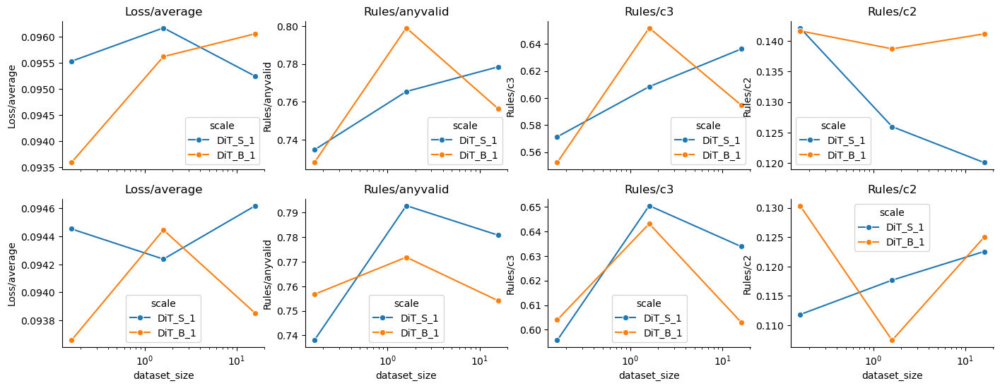

In [27]:
syndf_DiT_sorted = syndf_DiT.sort_values(by=["heldout", "scale", "dataset_size", ], ascending=[True, False, True, ])
fig, axs = plt.subplots(2, 4, figsize=(17, 6), sharex=True)
for ax, metric in zip(axs[0,:], ["Loss/average", "Rules/anyvalid", "Rules/c3", "Rules/c2",]):
    # sns.barplot(data=syndf_DiT_sorted[syndf_DiT_sorted.heldout==True], x="scale", y=metric, hue="dataset_size", ax=ax)
    sns.lineplot(data=syndf_DiT[syndf_DiT.heldout==True], x="dataset_size", y=metric, hue="scale", ax=ax, marker="o", hue_order=["DiT_S_1", "DiT_B_1"])
    ax.set_title(metric)
    ax.set_xscale('log')
for ax, metric in zip(axs[1,:], ["Loss/average", "Rules/anyvalid", "Rules/c3", "Rules/c2",]):
    # sns.barplot(data=syndf_DiT_sorted[syndf_DiT_sorted.heldout==False], x="scale", y=metric, hue="dataset_size", ax=ax)
    sns.lineplot(data=syndf_DiT[syndf_DiT.heldout==False], x="dataset_size", y=metric, hue="scale", ax=ax, marker="o", hue_order=["DiT_S_1", "DiT_B_1"])
    ax.set_title(metric)
    ax.set_xscale('log')
plt.show()

### General Learning Dynamics

096-RAVEN10_abstract-uncond-DiT_B_1-stream0_16M_20240711-0205/tensorboard_logs


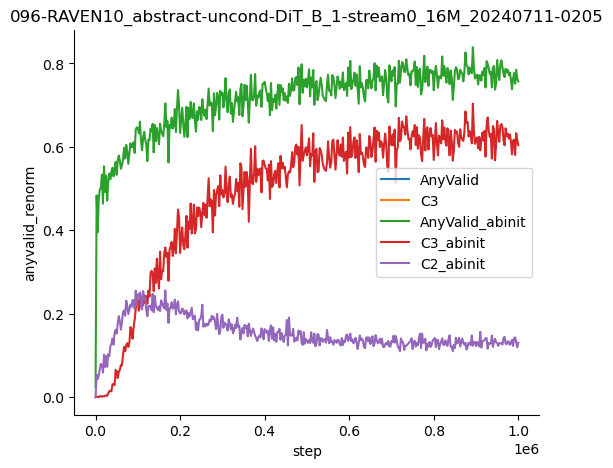

091-RAVEN10_abstract-uncond-DiT_B_1-stream16M_20240711-0205/tensorboard_logs


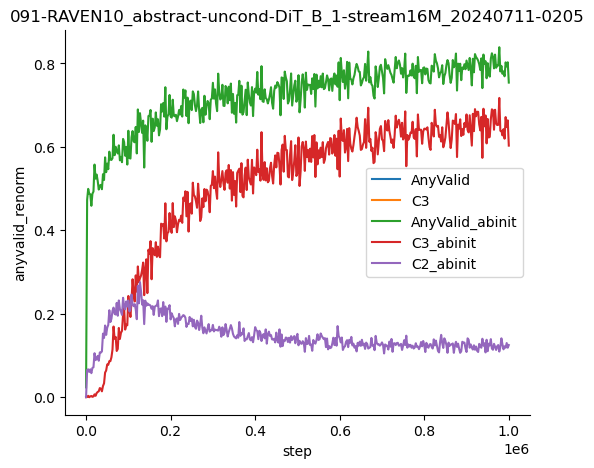

085-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_20240711-0204/tensorboard_logs


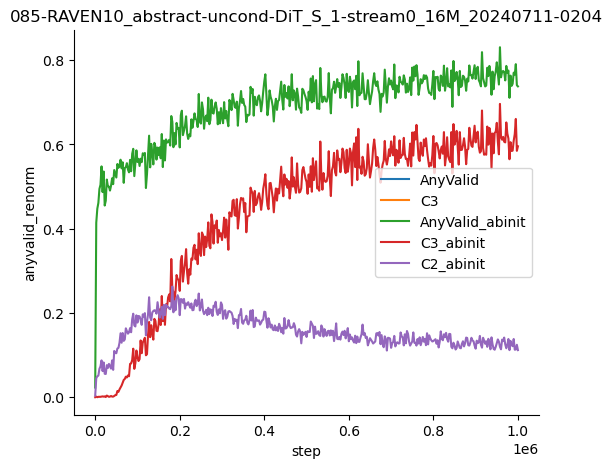

087-RAVEN10_abstract-uncond-DiT_S_1-stream16M_20240711-0204/tensorboard_logs


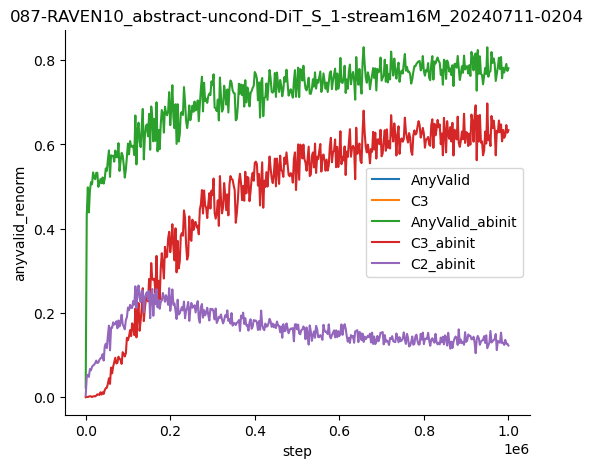

090-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_heldout0_20240711-0204/tensorboard_logs


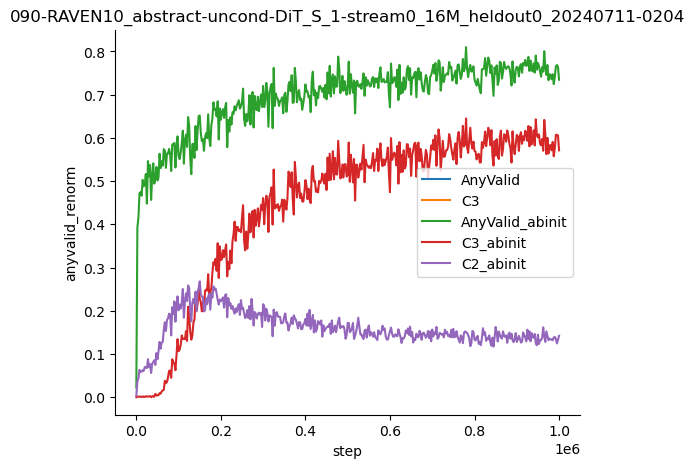

095-RAVEN10_abstract-uncond-DiT_B_1-stream16M_heldout0_20240711-0205/tensorboard_logs


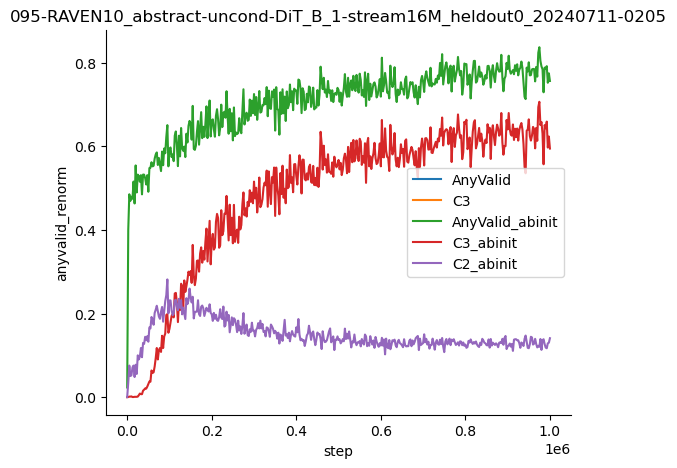

086-RAVEN10_abstract-uncond-DiT_S_1-stream1_6M_20240711-0204/tensorboard_logs


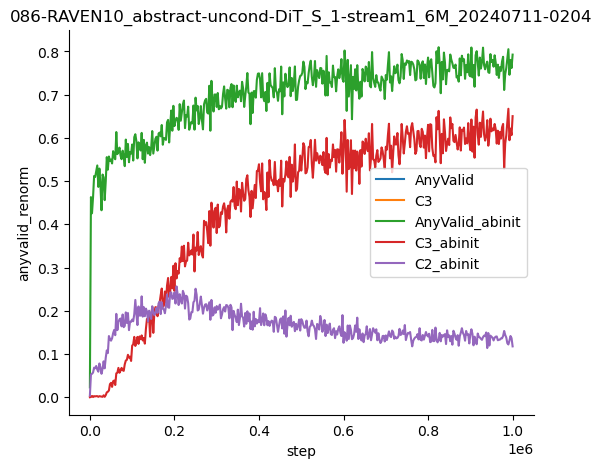

092-RAVEN10_abstract-uncond-DiT_B_1-stream1_6M_20240711-0205/tensorboard_logs


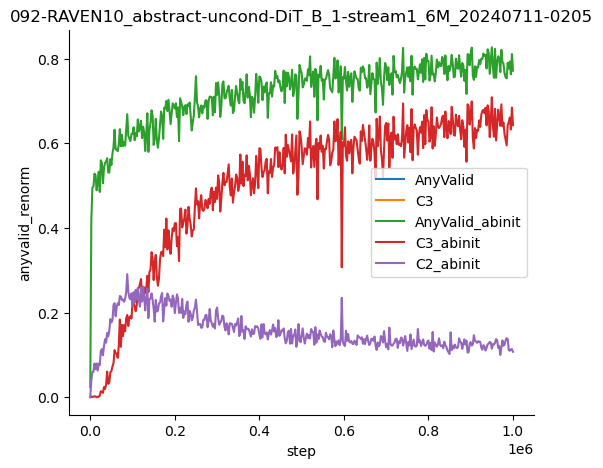

089-RAVEN10_abstract-uncond-DiT_S_1-stream1_6M_heldout0_20240711-0204/tensorboard_logs


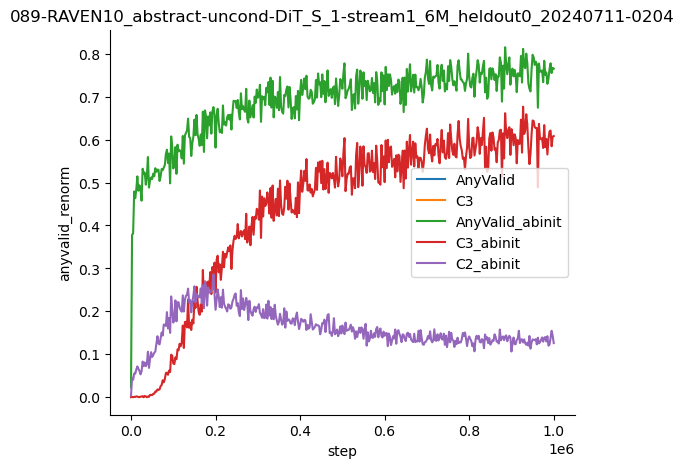

093-RAVEN10_abstract-uncond-DiT_B_1-stream1_6M_heldout0_20240711-0205/tensorboard_logs


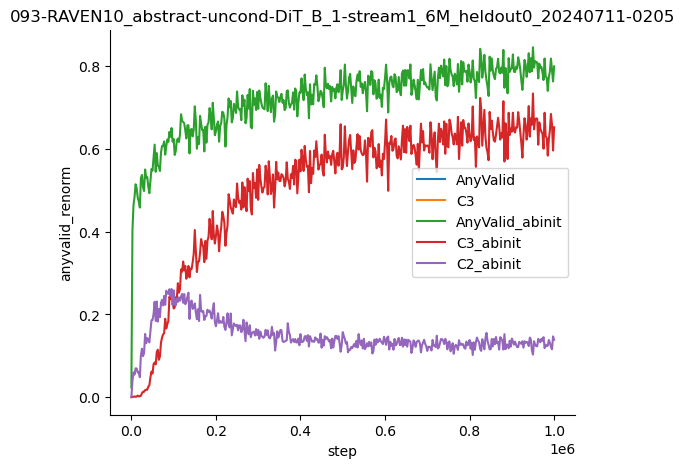

088-RAVEN10_abstract-uncond-DiT_S_1-stream16M_heldout0_20240711-0204/tensorboard_logs


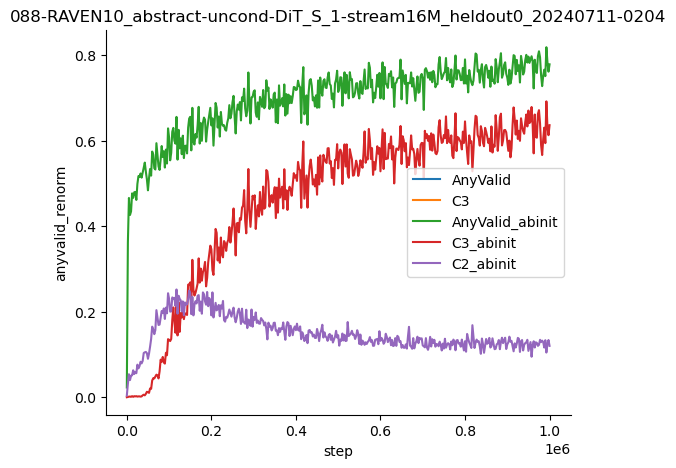

094-RAVEN10_abstract-uncond-DiT_B_1-stream0_16M_heldout0_20240711-0205/tensorboard_logs


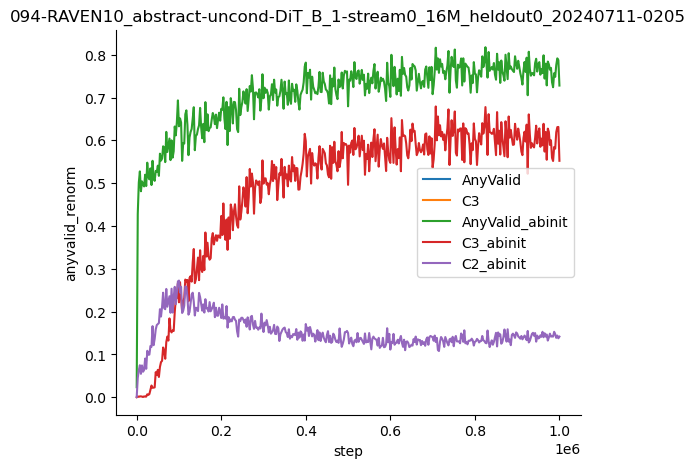

In [28]:
for expfullname in syndf_DiT.full_name:
    tb_record = tb_data_col_DiT[expfullname]
    expname = expfullname.split("/")[0]
    print(expfullname)
    # print(tb_record.keys())
    # print(tb_record['tag'].unique())    
    tb_anyvalid = tb_record[tb_record.tag=='Val/AnyValid']
    tb_anyvalid["anyvalid_renorm"] = (tb_anyvalid["value"] - 2/3) * 3
    figh = plt.figure(figsize=(6, 5))
    sns.lineplot(data=tb_anyvalid, x='step', y='anyvalid_renorm', label='AnyValid')
    sns.lineplot(data=tb_record[tb_record.tag=='Val/C3'], x='step', y='value', label='C3')
    # sns.lineplot(data=tb_record[tb_record.tag=='Val/AnyValid'], x='step', y='value', label='AnyValid')
    sns.lineplot(data=tb_record[tb_record.tag=='Rules/anyvalid'], x='step', y='value', label='AnyValid_abinit')
    sns.lineplot(data=tb_record[tb_record.tag=='Rules/c3'], x='step', y='value', label='C3_abinit')
    sns.lineplot(data=tb_record[tb_record.tag=='Rules/c2'], x='step', y='value', label='C2_abinit')
    plt.legend() # ['Val/C3', 'Val/C3_abinit', 'Val/C2_abinit', 'Val/AnyValid_abinit']
    plt.title(expname)
    saveallforms(DiTfigdir, f"{expname}_valid_consist_summary", figh)
    plt.show()
    # raise ValueError

### Load individual epochs and plot rule learning dynamics 

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiT/results/096-RAVEN10_abstract-uncond-DiT_B_1-stream0_16M_20240711-0205/samples
example file: 0155000.pt


  0%|          | 0/401 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(401, 2048, 3) (401, 2, 2048)
096-RAVEN10_abstract-uncond-DiT_B_1-stream0_16M_20240711-0205


/tmp/ipykernel_1068753/939804267.py:16: RuntimeWarning: Mean of empty slice.
  plt.plot(epoch_list, plot_mat[:, heldout_mask].mean(axis=1), color='black', linewidth=2)
/n/home12/binxuwang/.conda/envs/torch2/lib/python3.10/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


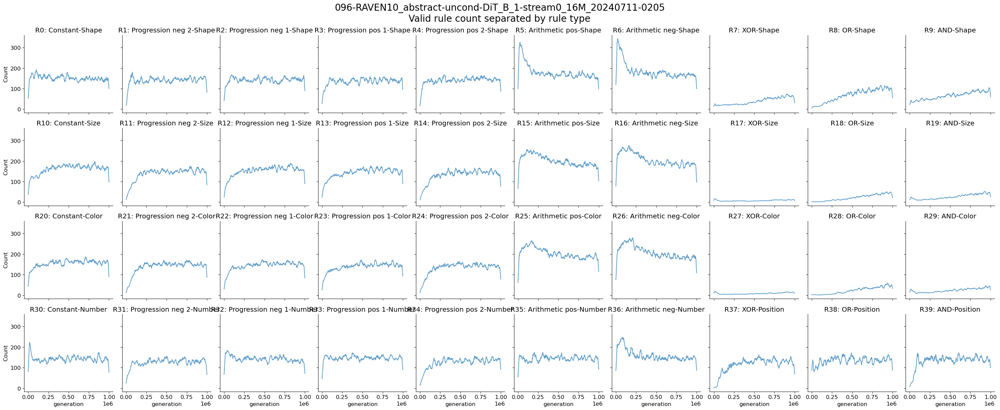

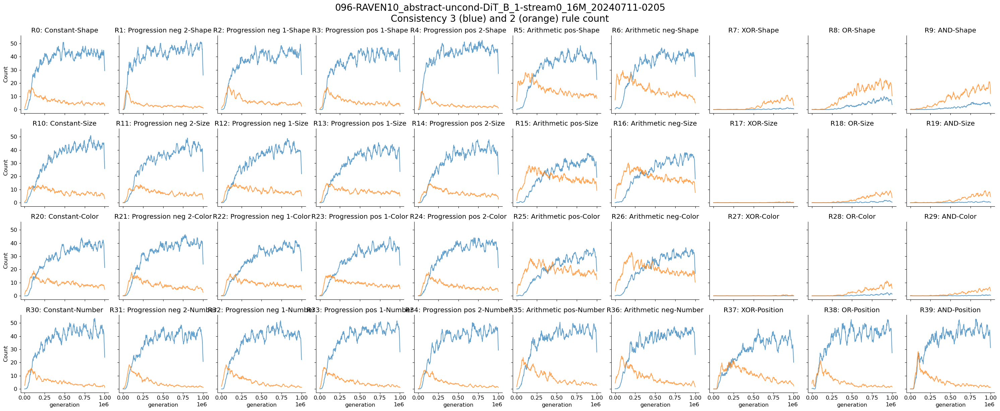

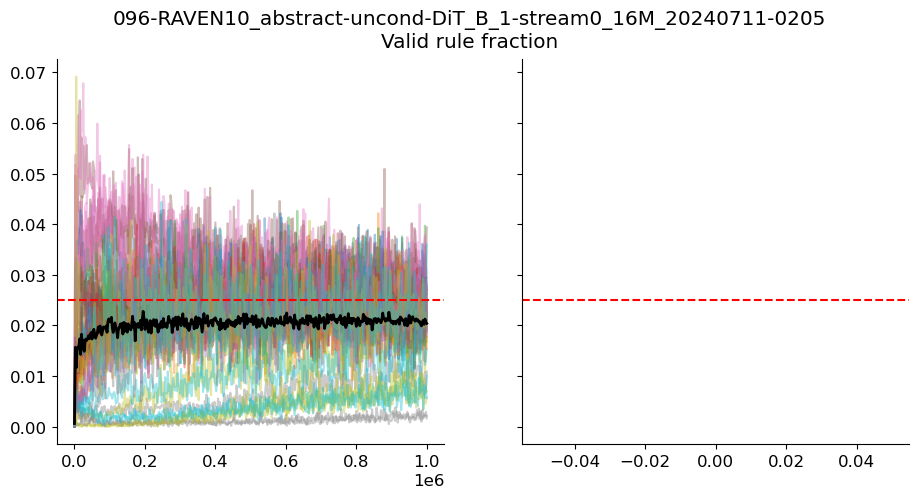

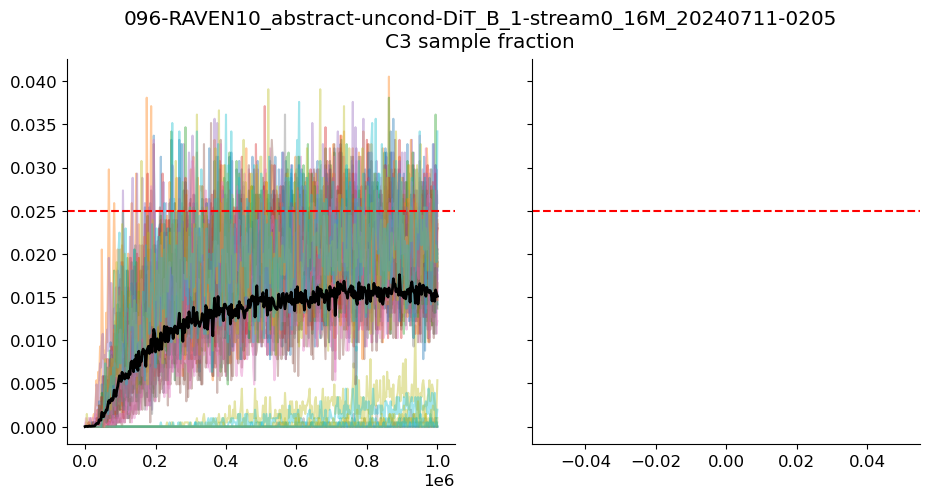

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiT/results/091-RAVEN10_abstract-uncond-DiT_B_1-stream16M_20240711-0205/samples
example file: 0155000.pt


  0%|          | 0/401 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(401, 2048, 3) (401, 2, 2048)
091-RAVEN10_abstract-uncond-DiT_B_1-stream16M_20240711-0205


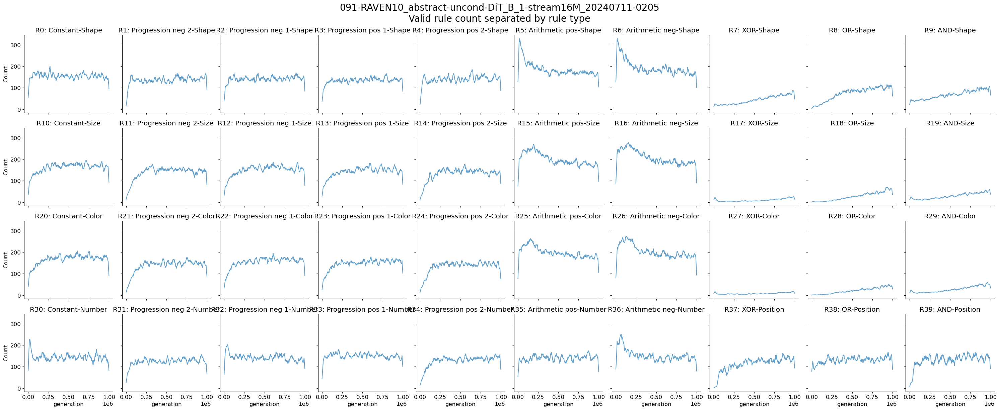

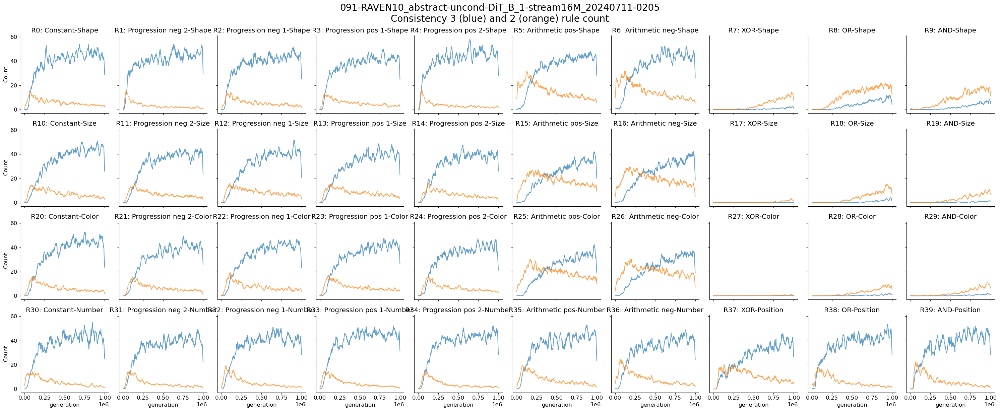

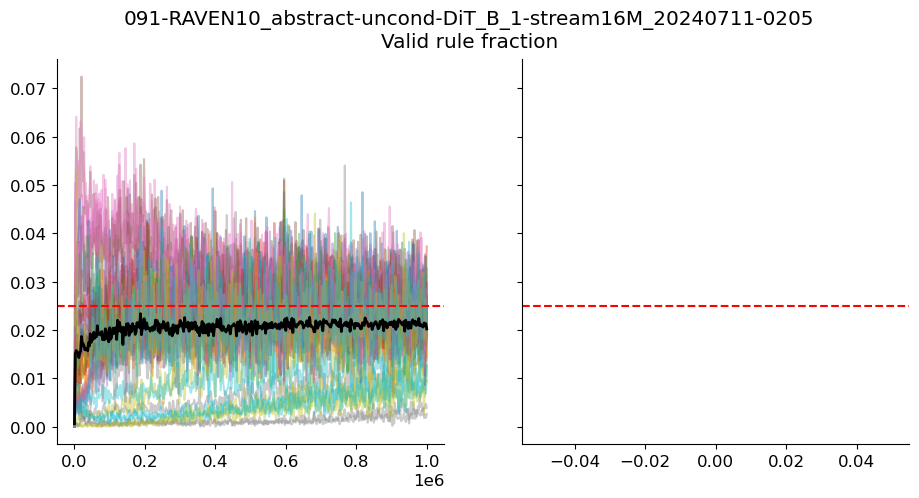

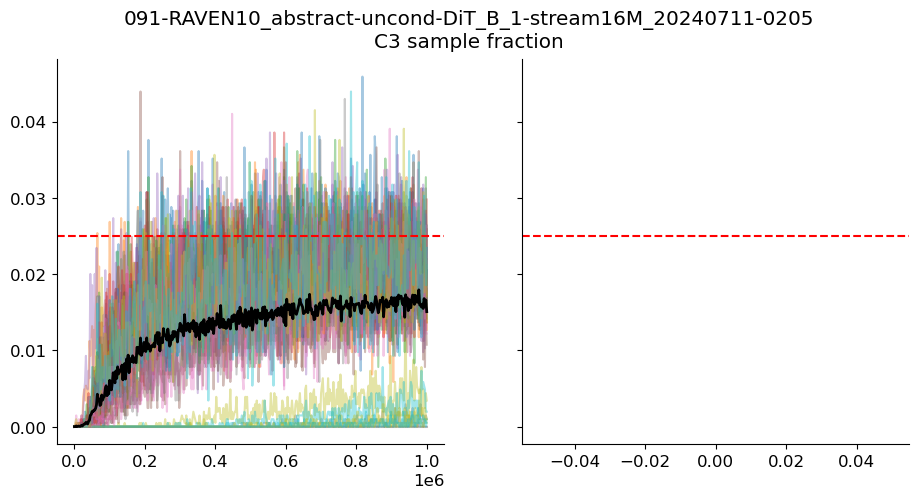

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiT/results/085-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_20240711-0204/samples
example file: 0155000.pt


  0%|          | 0/401 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(401, 2048, 3) (401, 2, 2048)
085-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_20240711-0204


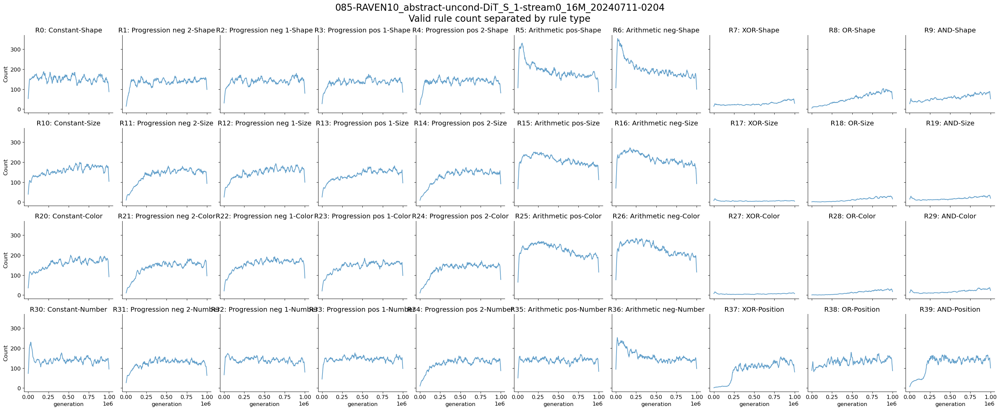

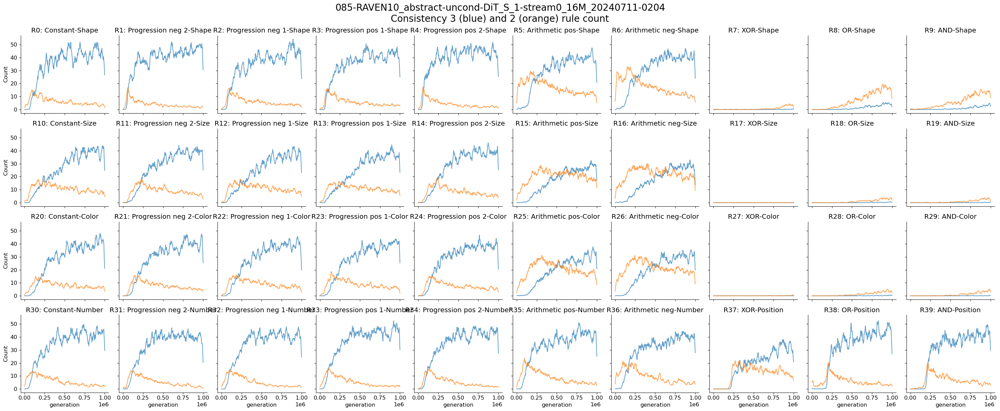

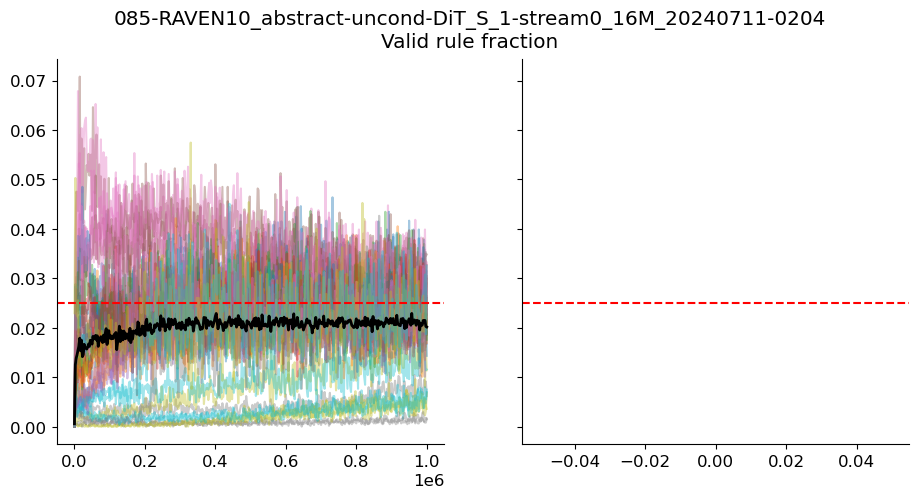

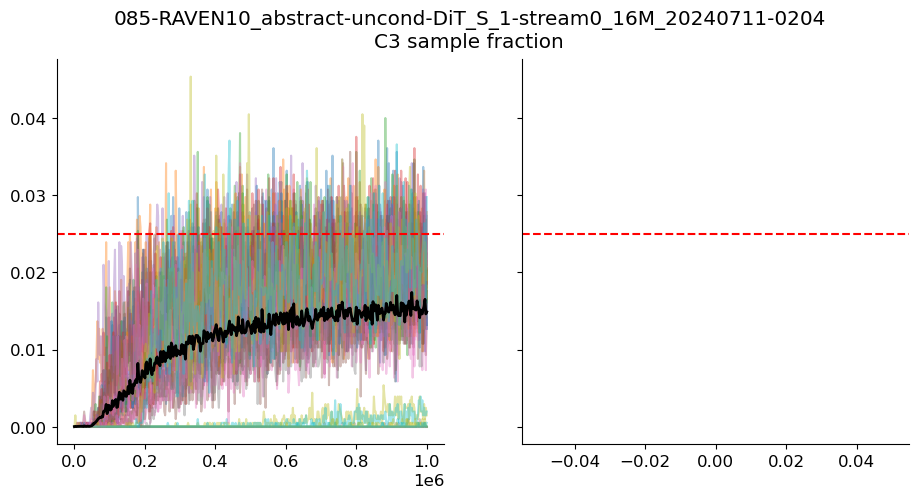

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiT/results/087-RAVEN10_abstract-uncond-DiT_S_1-stream16M_20240711-0204/samples
example file: 0155000.pt


  0%|          | 0/401 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(401, 2048, 3) (401, 2, 2048)
087-RAVEN10_abstract-uncond-DiT_S_1-stream16M_20240711-0204


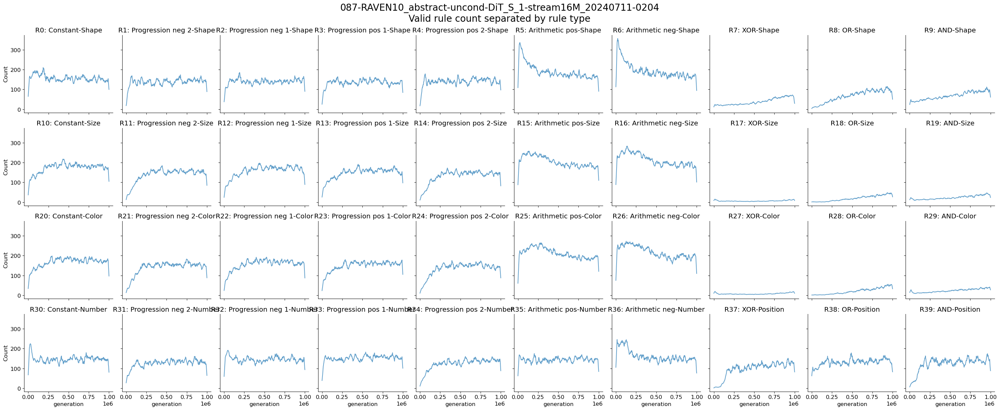

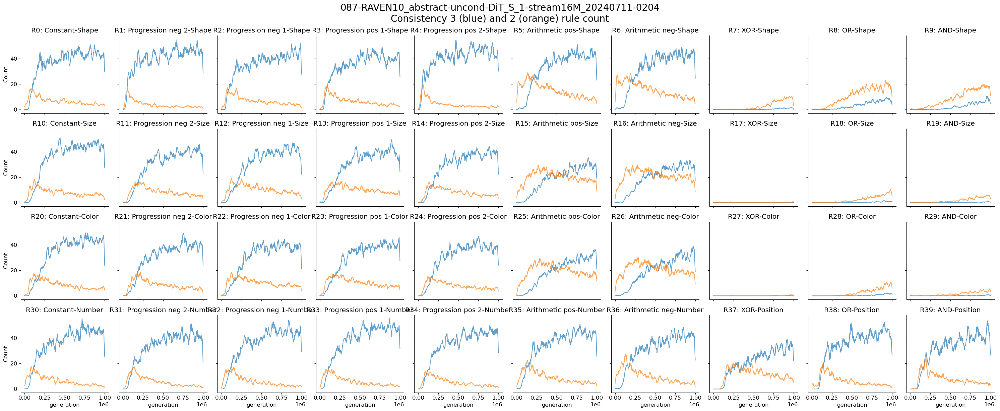

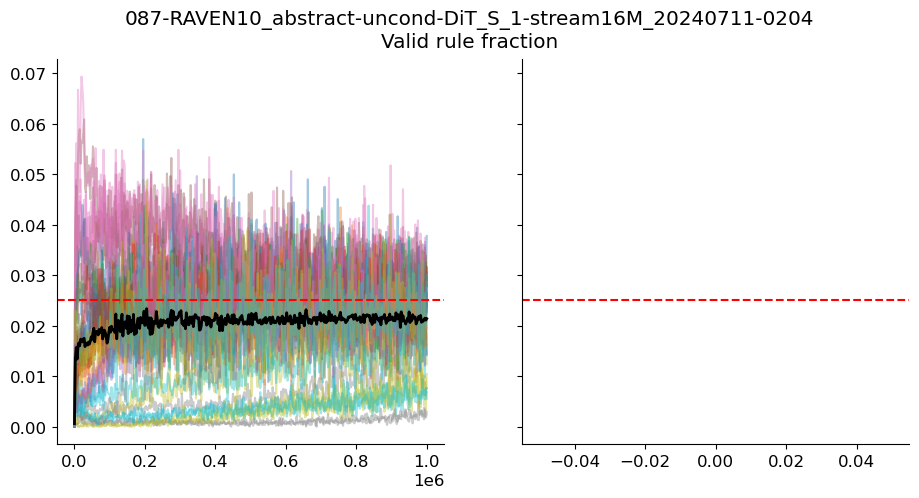

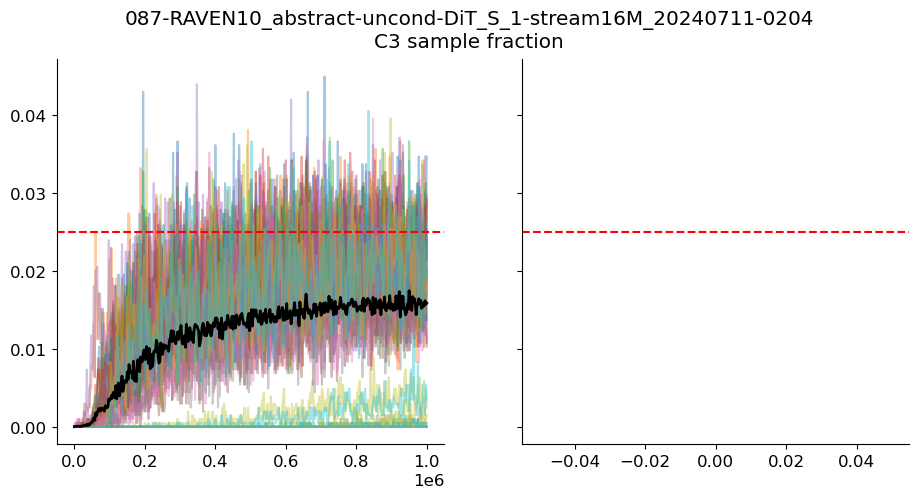

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiT/results/090-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_heldout0_20240711-0204/samples
example file: 0155000.pt


  0%|          | 0/401 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(401, 2048, 3) (401, 2, 2048)
090-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_heldout0_20240711-0204


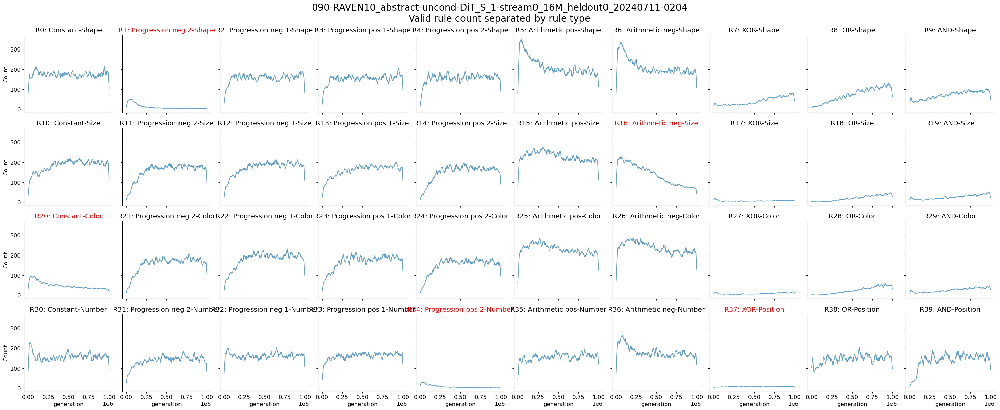

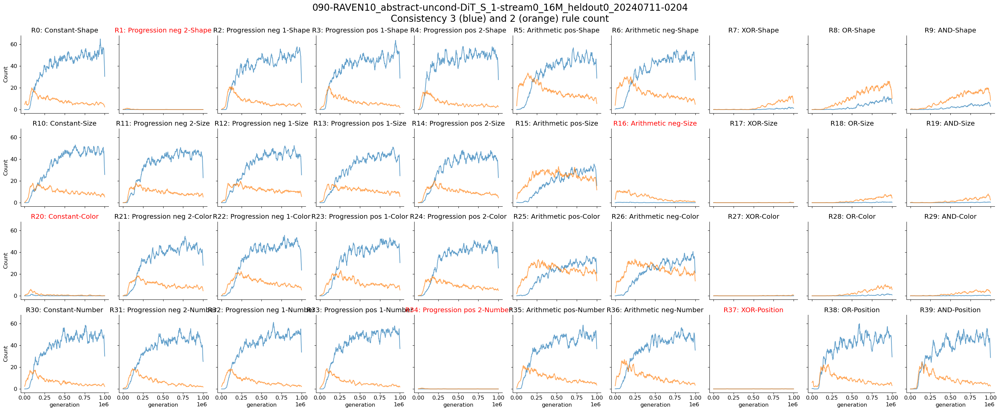

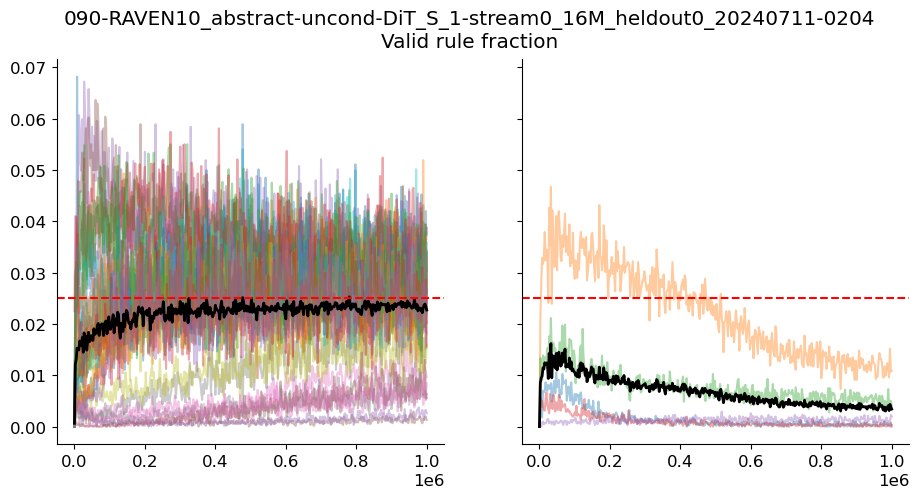

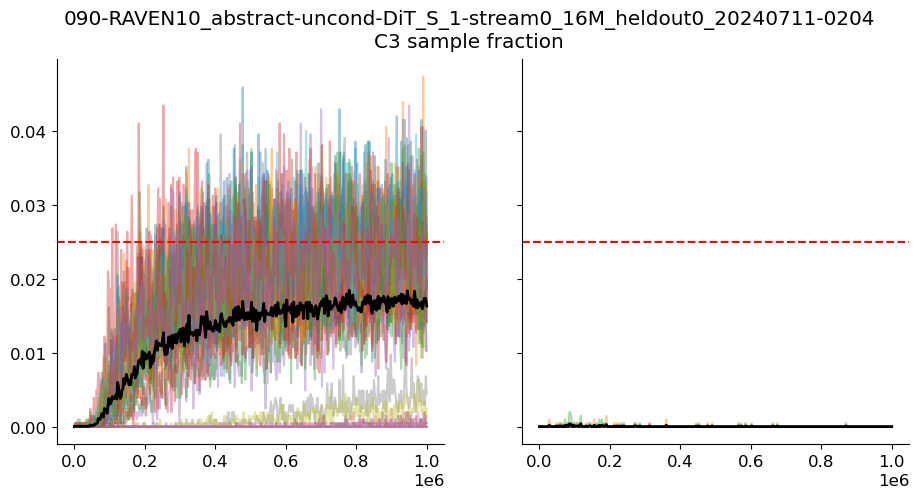

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiT/results/095-RAVEN10_abstract-uncond-DiT_B_1-stream16M_heldout0_20240711-0205/samples
example file: 0155000.pt


  0%|          | 0/401 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(401, 2048, 3) (401, 2, 2048)
095-RAVEN10_abstract-uncond-DiT_B_1-stream16M_heldout0_20240711-0205


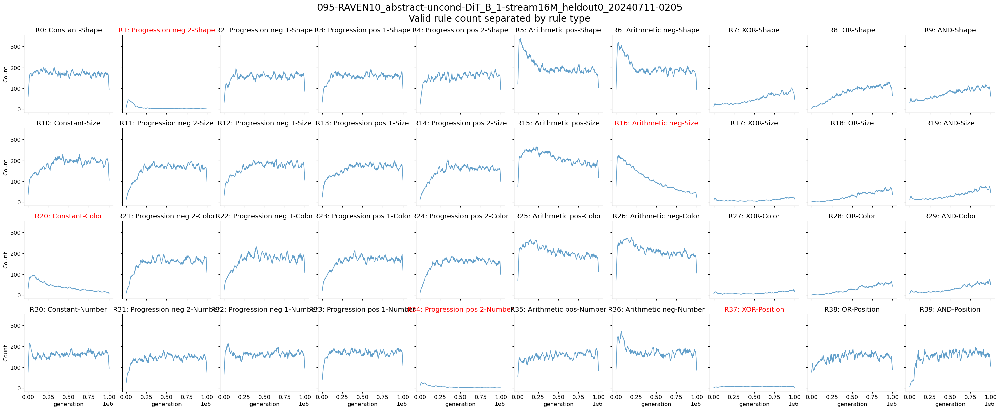

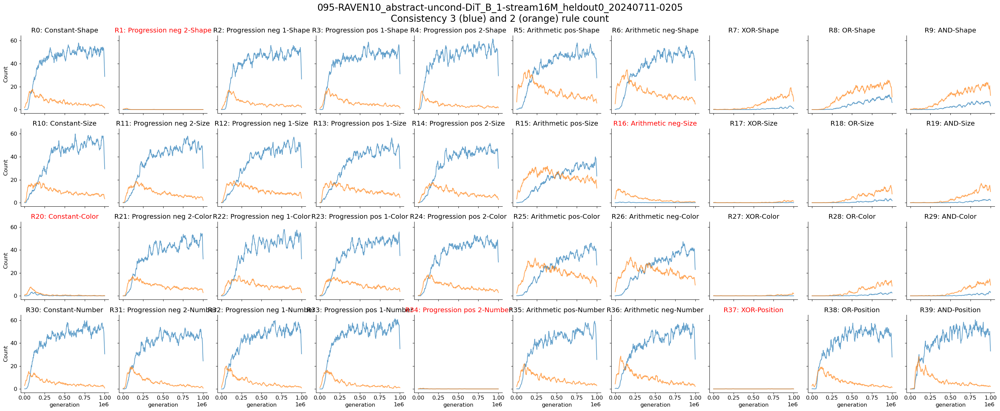

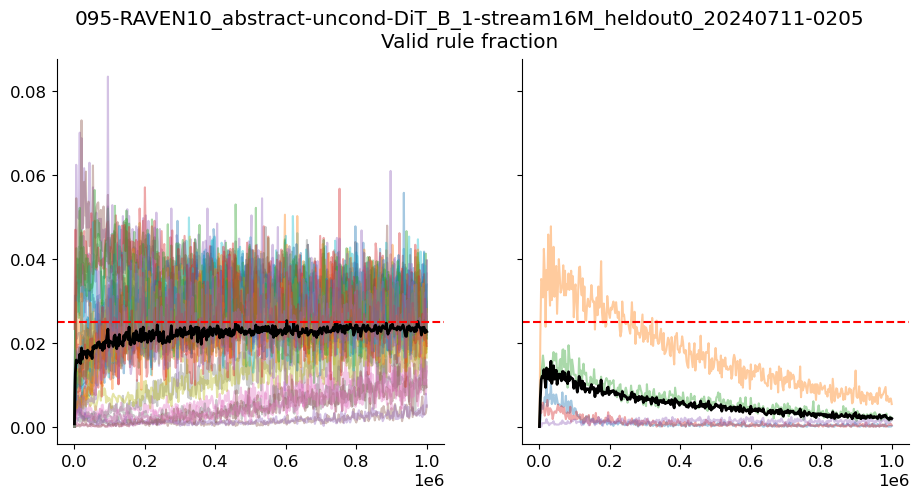

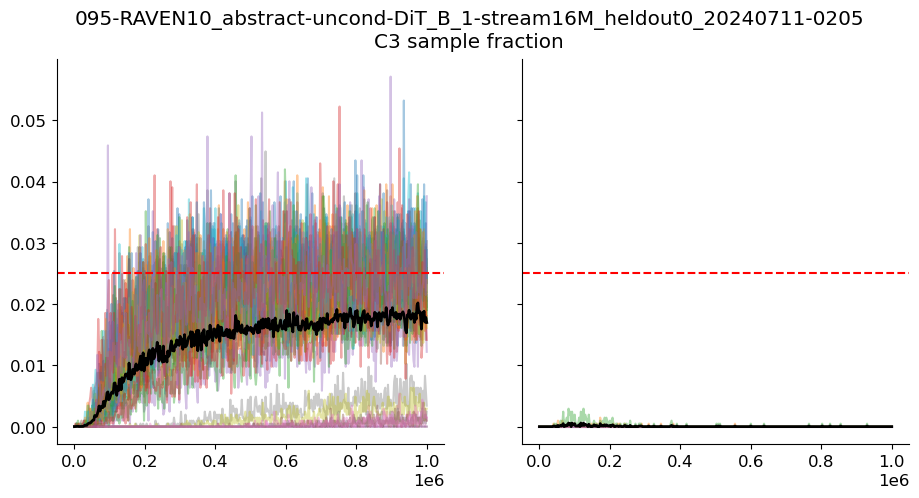

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiT/results/086-RAVEN10_abstract-uncond-DiT_S_1-stream1_6M_20240711-0204/samples
example file: 0155000.pt


  0%|          | 0/401 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(401, 2048, 3) (401, 2, 2048)
086-RAVEN10_abstract-uncond-DiT_S_1-stream1_6M_20240711-0204


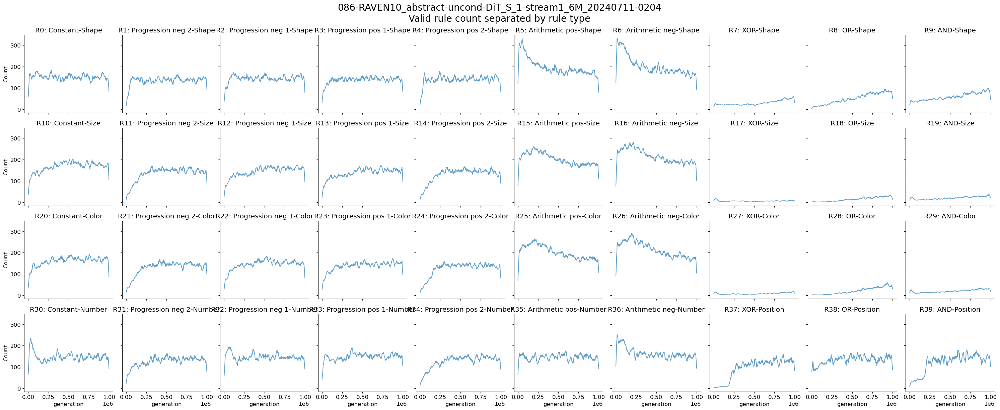

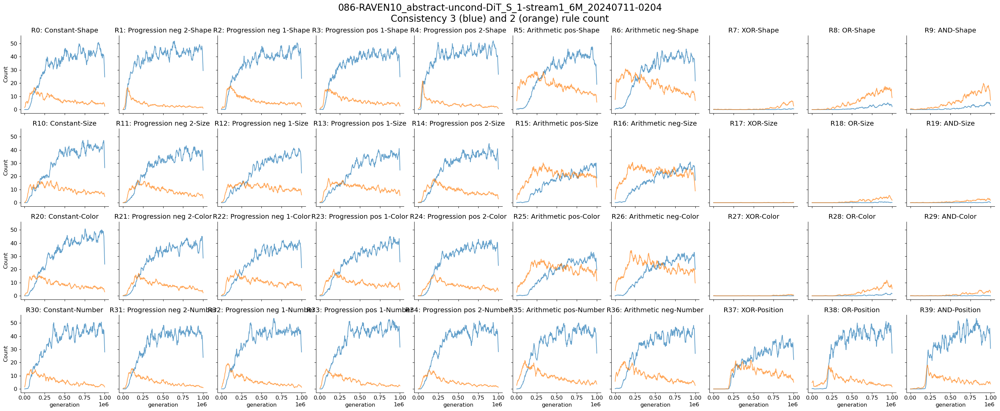

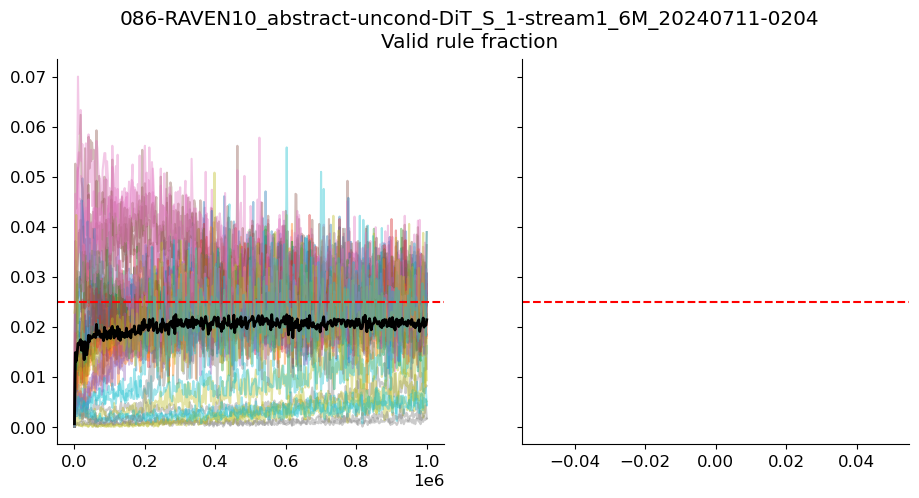

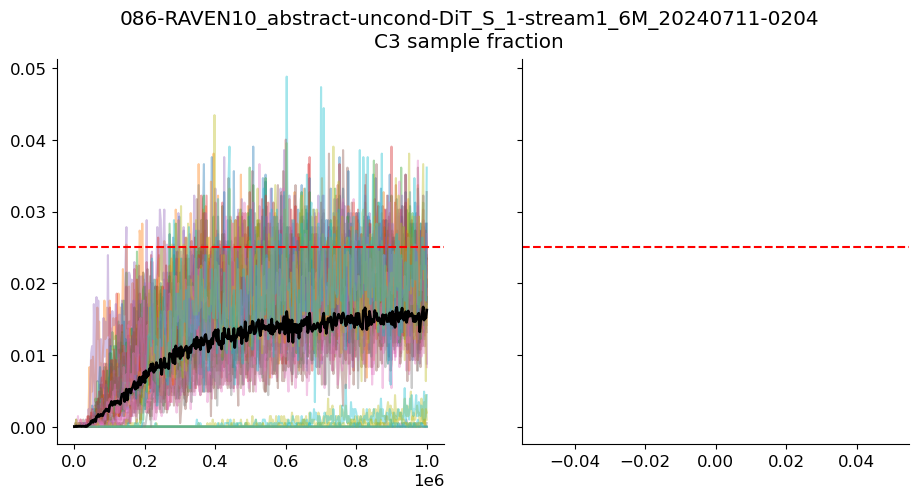

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiT/results/092-RAVEN10_abstract-uncond-DiT_B_1-stream1_6M_20240711-0205/samples
example file: 0155000.pt


  0%|          | 0/401 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(401, 2048, 3) (401, 2, 2048)
092-RAVEN10_abstract-uncond-DiT_B_1-stream1_6M_20240711-0205


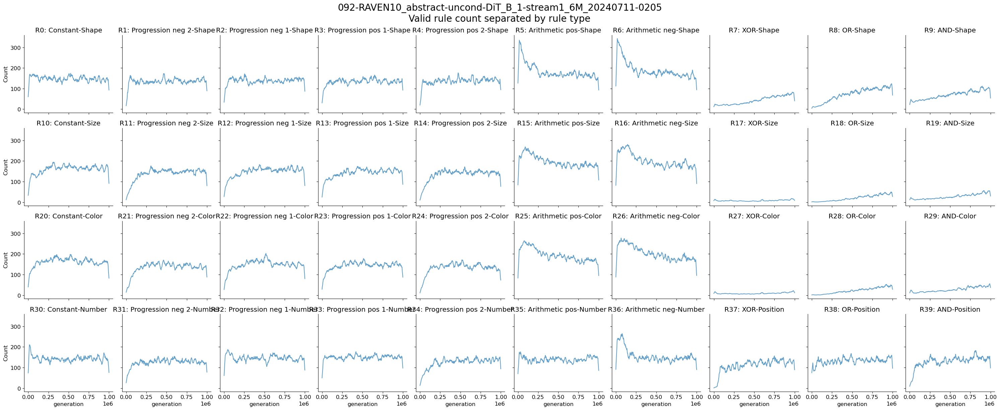

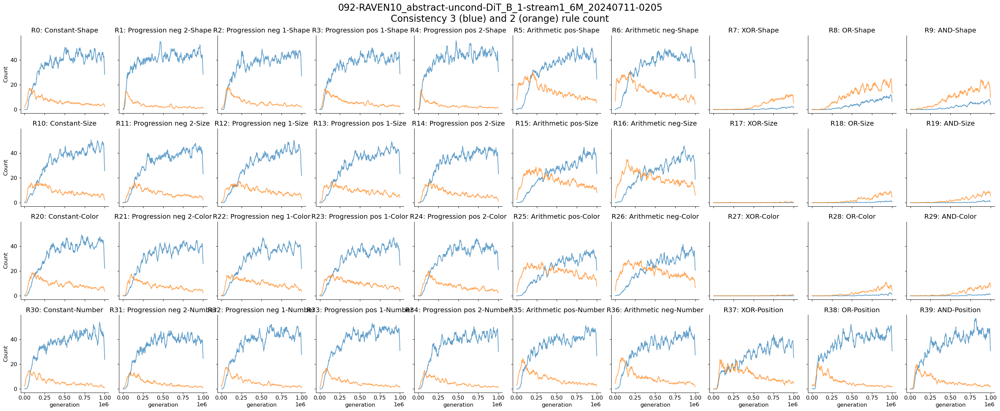

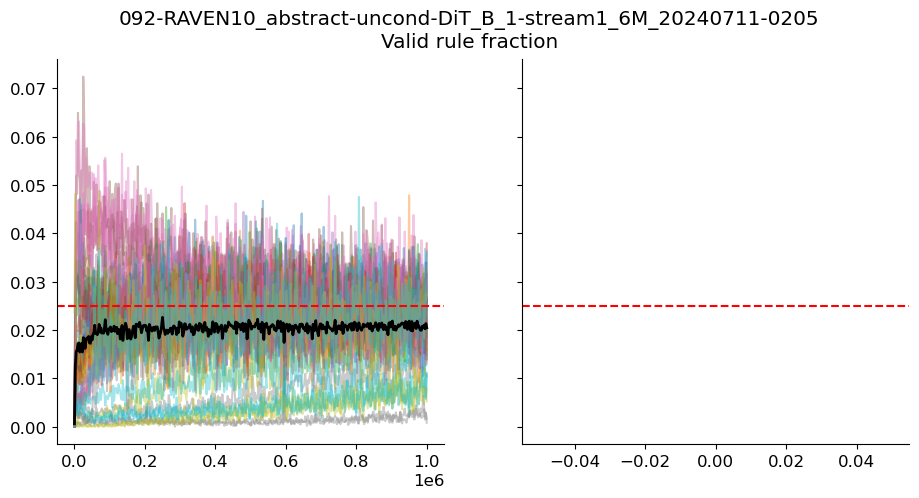

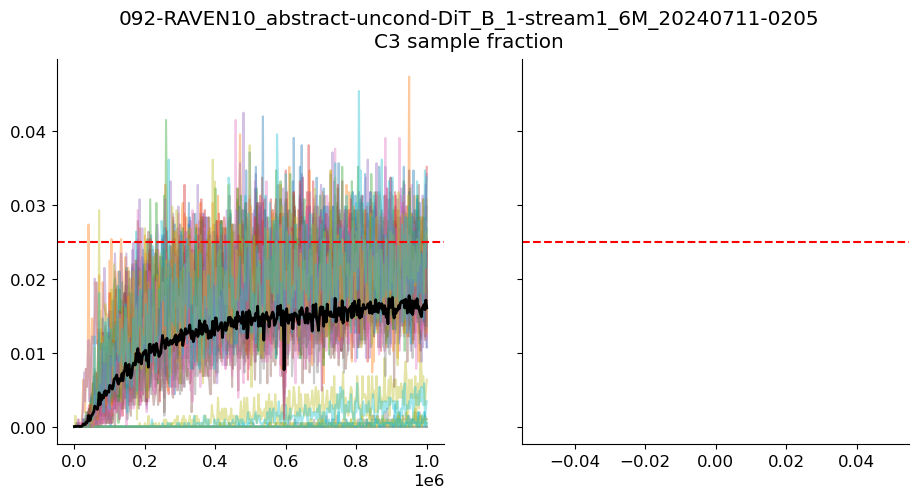

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiT/results/089-RAVEN10_abstract-uncond-DiT_S_1-stream1_6M_heldout0_20240711-0204/samples
example file: 0155000.pt


  0%|          | 0/401 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(401, 2048, 3) (401, 2, 2048)
089-RAVEN10_abstract-uncond-DiT_S_1-stream1_6M_heldout0_20240711-0204


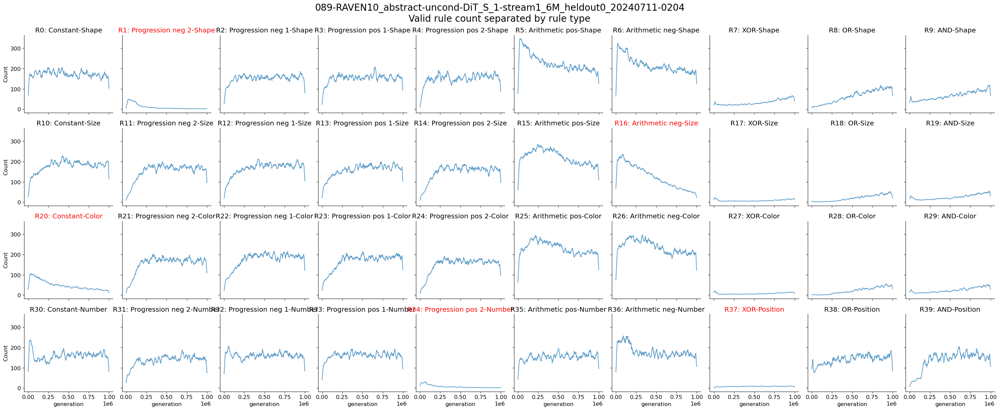

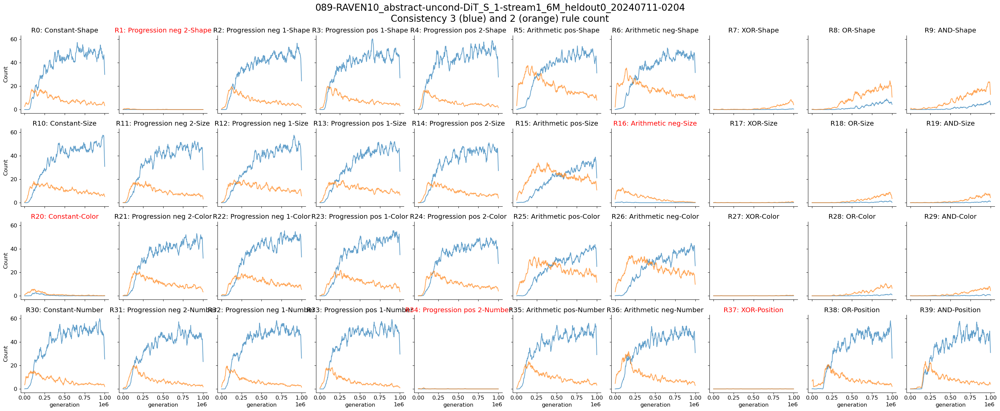

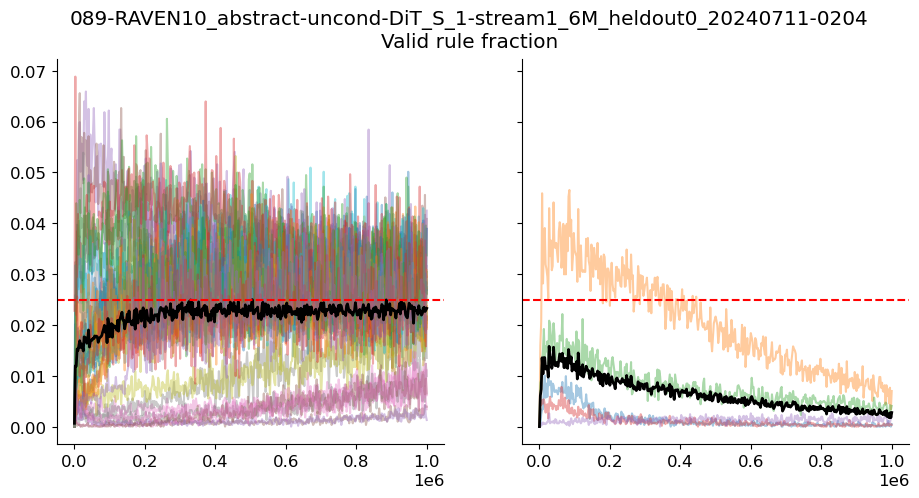

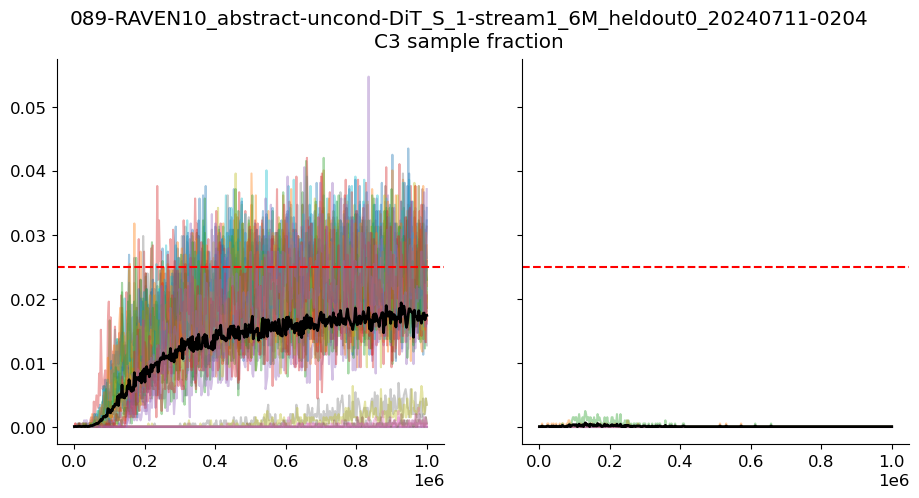

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiT/results/093-RAVEN10_abstract-uncond-DiT_B_1-stream1_6M_heldout0_20240711-0205/samples
example file: 0155000.pt


  0%|          | 0/401 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(401, 2048, 3) (401, 2, 2048)
093-RAVEN10_abstract-uncond-DiT_B_1-stream1_6M_heldout0_20240711-0205


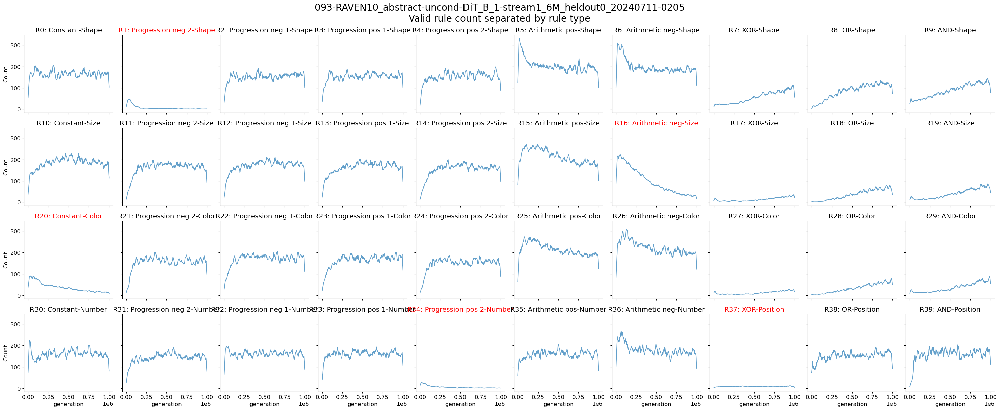

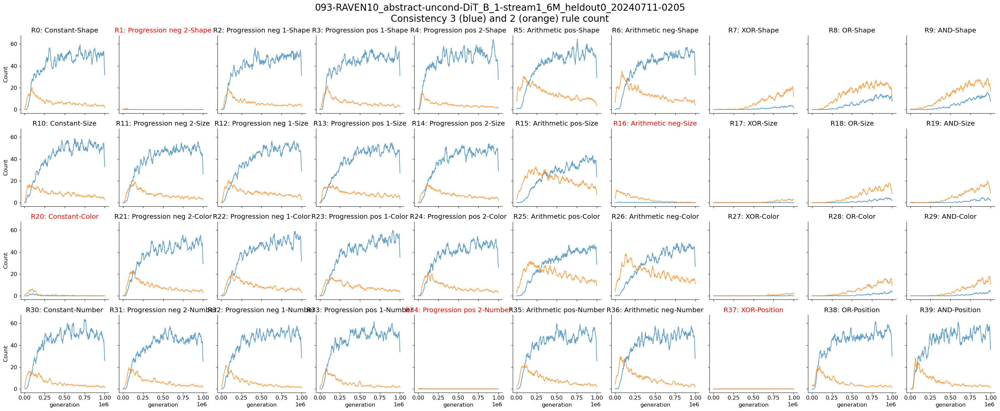

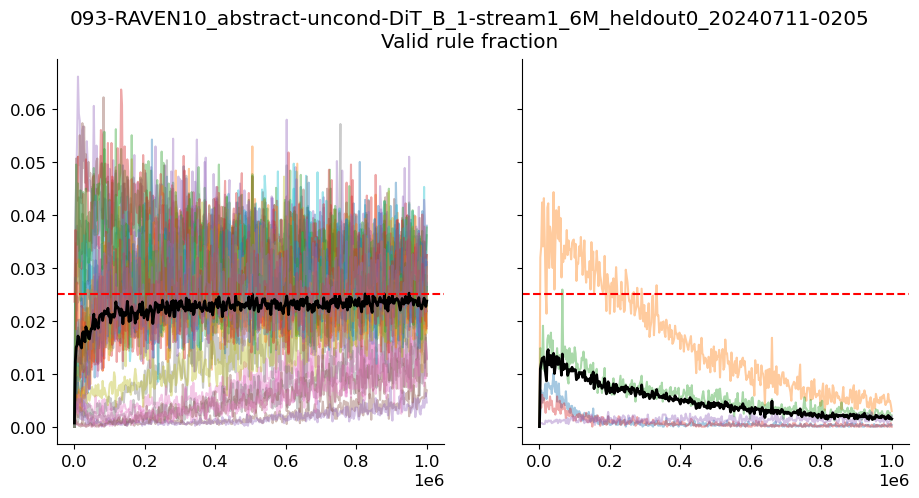

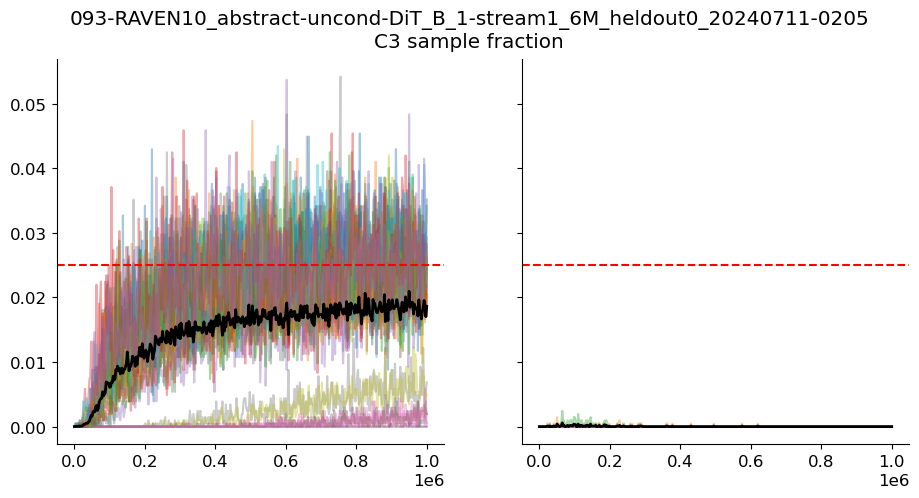

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiT/results/088-RAVEN10_abstract-uncond-DiT_S_1-stream16M_heldout0_20240711-0204/samples
example file: 0155000.pt


  0%|          | 0/401 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(401, 2048, 3) (401, 2, 2048)
088-RAVEN10_abstract-uncond-DiT_S_1-stream16M_heldout0_20240711-0204


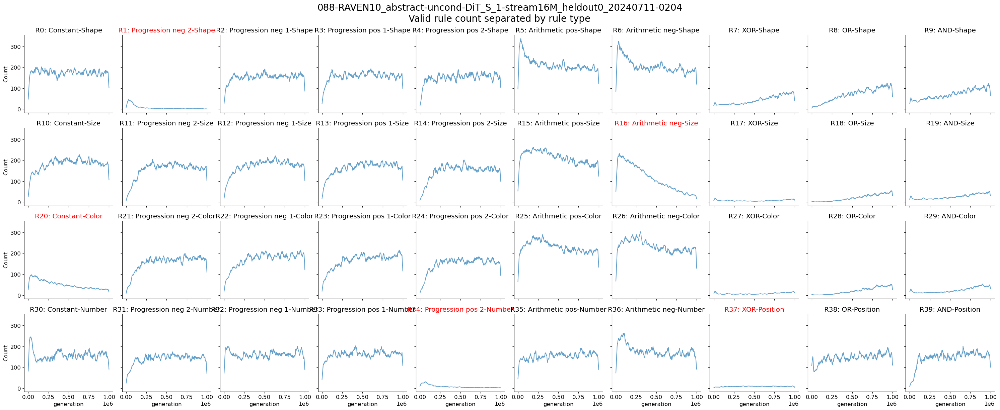

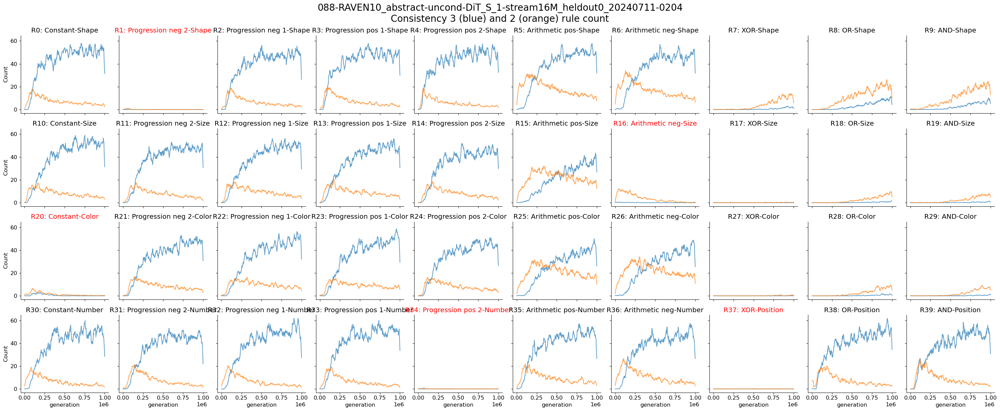

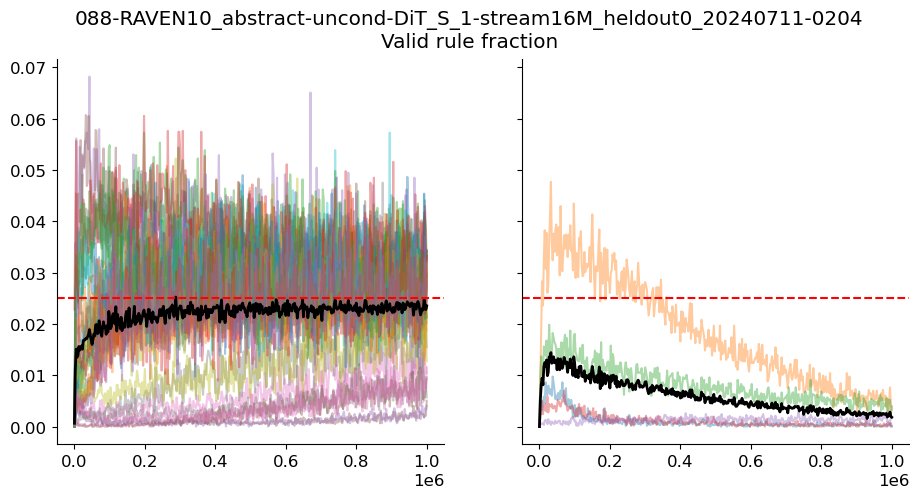

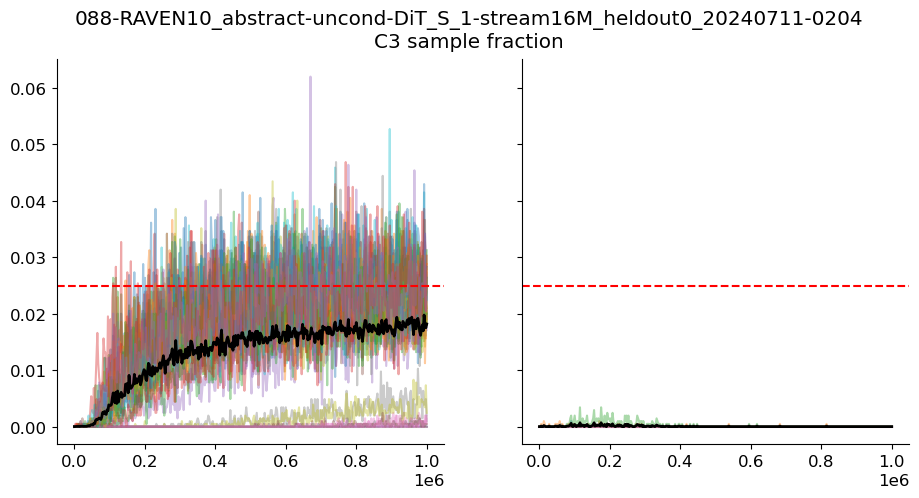

Extracted data from /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiT/results/094-RAVEN10_abstract-uncond-DiT_B_1-stream0_16M_heldout0_20240711-0205/samples
example file: 0155000.pt


  0%|          | 0/401 [00:00<?, ?it/s]

diffusion model, just fetch ab init generation
(401, 2048, 3) (401, 2, 2048)
094-RAVEN10_abstract-uncond-DiT_B_1-stream0_16M_heldout0_20240711-0205


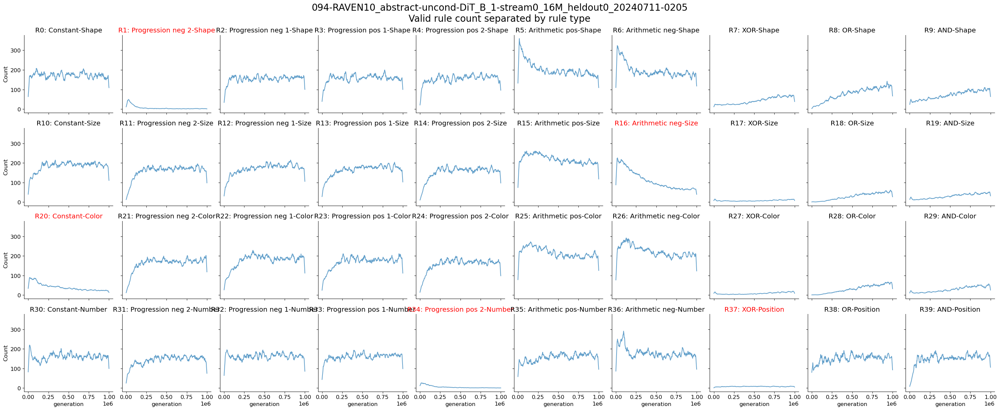

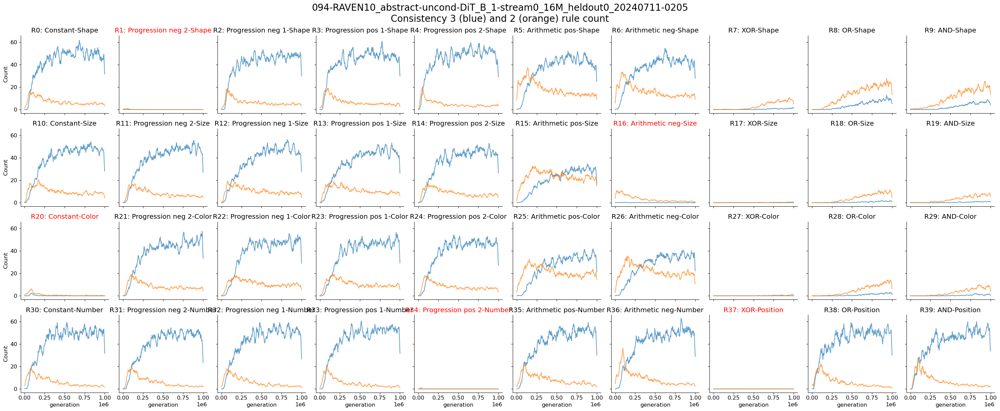

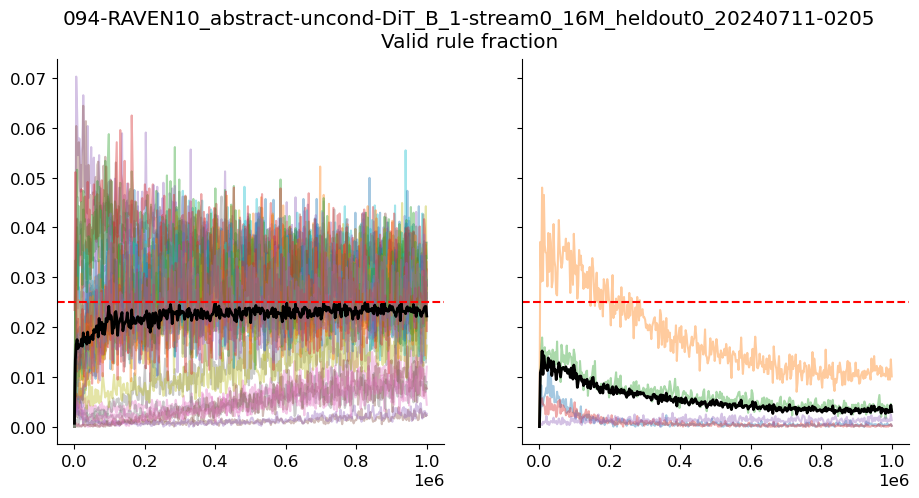

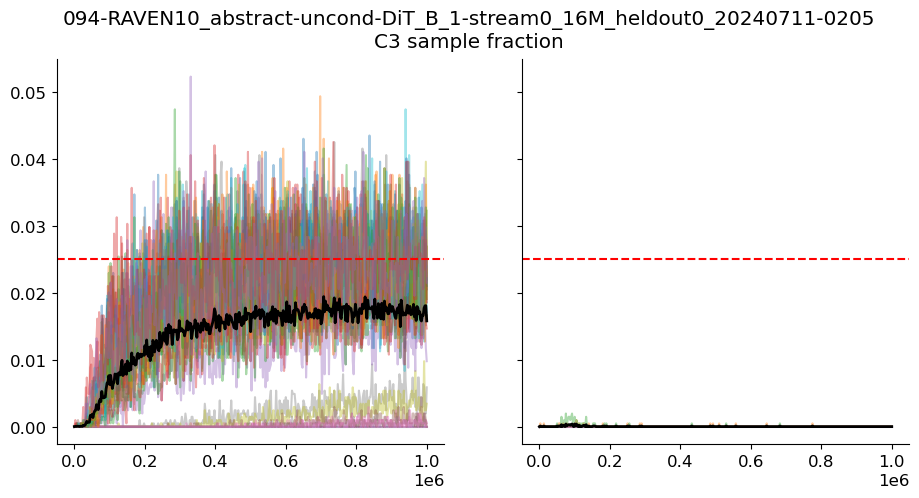

In [29]:
for expfullname in syndf_DiT.full_name:
    tb_record = tb_data_col_DiT[expfullname]
    expname = expfullname.split("/tensorboard_logs")[0]
    prefix = "sample_rule_eval_" #"eval_step" if "stream" in expname else "eval_epoch"
    eval_col = sweep_collect_eval_data(expname, DiT_exproot, prefix=prefix)
    epoch_list, rule_list_all, consistency_all = extract_rule_list_from_eval_col_Diffusion(eval_col, )
    rule_cnt_mat, cons3_rule_cnt_mat, cons2_rule_cnt_mat = format_rule_list_to_mat(rule_list_all, consistency_all)
    eval_sample_num = rule_list_all.shape[1]
    print(expname)
    if "heldout0" in expname:
        heldout_id = [1, 16, 20, 34, 37]  
    else:
        heldout_id = []

    figh, axs = visualize_indiv_rule_dynam(epoch_list, rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                            titlestr=f"{expname}\nValid rule count separated by rule type")
    saveallforms(DiTfigdir, f"{expname}_indiv_rule_validity", figh)

    figh, axs = visualize_indiv_rule_dynam(epoch_list, cons3_rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                                        titlestr=f"{expname}\nConsistency 3 (blue) and 2 (orange) rule count", )
    figh, axs = visualize_indiv_rule_dynam(epoch_list, cons2_rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                                        titlestr=f"{expname}\nConsistency 3 (blue) and 2 (orange) rule count", axs=axs)
    saveallforms(DiTfigdir, f"{expname}_indiv_rule_consistency", figh)
    
    figh = visualize_train_heldout_rule(epoch_list, rule_cnt_mat, heldout_id, 
                                normalizer=eval_sample_num * 3, reflevel=1 / 40,
                                titlestr=f"{expname}\nValid rule fraction")
    saveallforms(DiTfigdir, f"{expname}_train_held_rule_validity", figh)

    figh = visualize_train_heldout_rule(epoch_list, cons3_rule_cnt_mat, heldout_id, 
                                normalizer=eval_sample_num, reflevel=1 / 40,
                                titlestr=f"{expname}\nC3 sample fraction")
    saveallforms(DiTfigdir, f"{expname}_train_held_rule_consistency", figh)

In [107]:
import torch
for expname in [
    "094-RAVEN10_abstract-uncond-DiT_B_1-stream0_16M_heldout0_20240711-0205", 
    "093-RAVEN10_abstract-uncond-DiT_B_1-stream1_6M_heldout0_20240711-0205", 
    "095-RAVEN10_abstract-uncond-DiT_B_1-stream16M_heldout0_20240711-0205", 
    "090-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_heldout0_20240711-0204", 
    "089-RAVEN10_abstract-uncond-DiT_S_1-stream1_6M_heldout0_20240711-0204", 
    "088-RAVEN10_abstract-uncond-DiT_S_1-stream16M_heldout0_20240711-0204", 
    "085-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_20240711-0204", 
    "086-RAVEN10_abstract-uncond-DiT_S_1-stream1_6M_20240711-0204", 
    # "083-RAVEN10_abstract-uncond-DiT_S_1-stream16M_20240711-0149", 
    "087-RAVEN10_abstract-uncond-DiT_S_1-stream16M_20240711-0204", 
    "096-RAVEN10_abstract-uncond-DiT_B_1-stream0_16M_20240711-0205", 
    "092-RAVEN10_abstract-uncond-DiT_B_1-stream1_6M_20240711-0205", 
    # "084-RAVEN10_abstract-uncond-DiT_B_1-stream16M_20240711-0200", 
    "091-RAVEN10_abstract-uncond-DiT_B_1-stream16M_20240711-0205", ]:
    assert os.path.exists(join(DiT_exproot, expname, "tensorboard_logs")), expname  
    # for files with names like 'sample_rule_eval_995000.pt' find the one with largest number
    epoch_num = max([int(f.split("sample_rule_eval_")[-1].split(".pt")[0]) for f in os.listdir(join(DiT_exproot, expname,'samples'))])
    print(epoch_num)
    samples_eval = torch.load(join(DiT_exproot, expname, 'samples', f"sample_rule_eval_{epoch_num}.pt"))

1000000
1000000
1000000
1000000
1000000
1000000
1000000
1000000
1000000
1000000
1000000
1000000


In [133]:
import torch
from tqdm import tqdm, trange
# for expname in [
#     "094-RAVEN10_abstract-uncond-DiT_B_1-stream0_16M_heldout0_20240711-0205", 
#     "093-RAVEN10_abstract-uncond-DiT_B_1-stream1_6M_heldout0_20240711-0205", 
#     "095-RAVEN10_abstract-uncond-DiT_B_1-stream16M_heldout0_20240711-0205", 
#     "090-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_heldout0_20240711-0204", 
#     "089-RAVEN10_abstract-uncond-DiT_S_1-stream1_6M_heldout0_20240711-0204", 
#     "088-RAVEN10_abstract-uncond-DiT_S_1-stream16M_heldout0_20240711-0204", 
#     "085-RAVEN10_abstract-uncond-DiT_S_1-stream0_16M_20240711-0204", 
#     "086-RAVEN10_abstract-uncond-DiT_S_1-stream1_6M_20240711-0204", 
#     # "083-RAVEN10_abstract-uncond-DiT_S_1-stream16M_20240711-0149", 
#     "087-RAVEN10_abstract-uncond-DiT_S_1-stream16M_20240711-0204", 
#     "096-RAVEN10_abstract-uncond-DiT_B_1-stream0_16M_20240711-0205", 
#     "092-RAVEN10_abstract-uncond-DiT_B_1-stream1_6M_20240711-0205", 
#     # "084-RAVEN10_abstract-uncond-DiT_B_1-stream16M_20240711-0200", 
#     "091-RAVEN10_abstract-uncond-DiT_B_1-stream16M_20240711-0205", ]:
expname = "091-RAVEN10_abstract-uncond-DiT_B_1-stream16M_20240711-0205"
expname = "095-RAVEN10_abstract-uncond-DiT_B_1-stream16M_heldout0_20240711-0205"
assert os.path.exists(join(DiT_exproot, expname, "tensorboard_logs")), expname  
# for files with names like 'sample_rule_eval_995000.pt' find the one with largest number
epoch_nums = sorted([int(f.split("sample_rule_eval_")[-1].split(".pt")[0]) for f in os.listdir(join(DiT_exproot, expname,'samples'))])
eval_col = {}
for epoch_num in tqdm(epoch_nums):
    samples_eval = torch.load(join(DiT_exproot, expname, 'samples', f"sample_rule_eval_{epoch_num}.pt"))
    eval_col[epoch_num] = samples_eval

1000000


100%|██████████| 802/802 [00:39<00:00, 20.22it/s]


In [116]:
list(eval_col[1])

['c3_list', 'c2_list', 'rule_col', 'c3_cnt', 'c2_cnt', 'anyvalid_cnt', 'total']

In [141]:
epoch_list = list(eval_col.keys())
rule_list_all = []
consistency_all = []
for epoch in eval_col.keys():
    rule_list_all.append(eval_col[epoch]["rule_col"])
    consistency_all.append((eval_col[epoch]["c3_list"], eval_col[epoch]["c2_list"]))
rule_list_all = np.array(rule_list_all, dtype=object)
consistency_all = np.array(consistency_all, dtype=object)
print(rule_list_all.shape, consistency_all.shape)


(401, 2048, 3) (401, 2, 2048)


100%|██████████| 401/401 [00:00<00:00, 28777.76it/s]


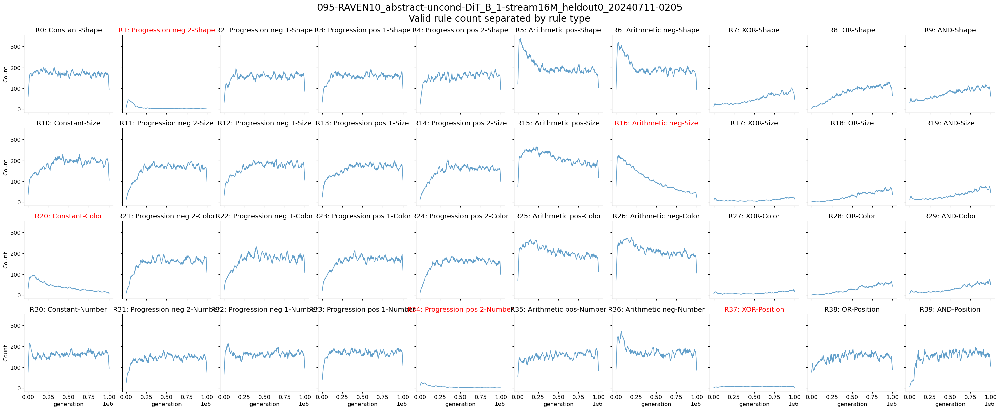

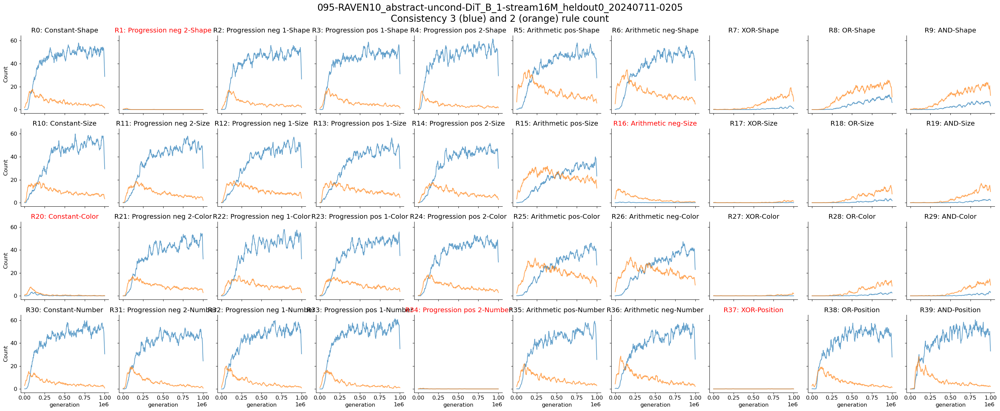

In [142]:
# each element in the rule rule_pool_all is a list of rules for all the samples in the corresponding generation
rule_pool_all = []
for i in trange(len(epoch_list)):
    rule_pool = np.concatenate(list(rule_list_all[i,:,:].flatten())).astype(int)
    rule_pool_all.append(rule_pool)
# plot the number of rules == rule_i for each generation
rule_cnt_mat = np.zeros((len(epoch_list), 40))
for i in trange(len(epoch_list)):
    rule_pool = rule_pool_all[i]
    rule_uniq, counts = np.unique(rule_pool, return_counts=True)
    rule_cnt_mat[i, rule_uniq] = counts

cons3_rule_pool_all = []
cons2_rule_pool_all = []
for i in trange(len(epoch_list)):
    rule_pool = np.concatenate(list(consistency_all[i,0,:].flatten())).astype(int)
    cons3_rule_pool_all.append(rule_pool)
    rule_pool = np.concatenate(list(consistency_all[i,1,:].flatten())).astype(int)
    cons2_rule_pool_all.append(rule_pool)

cons3_rule_cnt_mat = np.zeros((len(epoch_list), 40))
cons2_rule_cnt_mat = np.zeros((len(epoch_list), 40))
for i in trange(len(epoch_list)):
    rule_pool = cons3_rule_pool_all[i]
    rule_uniq, counts = np.unique(rule_pool, return_counts=True)
    cons3_rule_cnt_mat[i, rule_uniq] = counts
    rule_pool = cons2_rule_pool_all[i]
    rule_uniq, counts = np.unique(rule_pool, return_counts=True)
    cons2_rule_cnt_mat[i, rule_uniq] = counts
    
if "heldout0" in expname:
    heldout_id = [1, 16, 20, 34, 37]  
else:
    heldout_id = []
figdir = "/n/home12/binxuwang/Github/DiffusionReasoning/Figures_newrule"
figh, axs = visualize_indiv_rule_dynam(epoch_list, rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                        titlestr=f"{expname}\nValid rule count separated by rule type")
saveallforms(figdir, f"{expname}_indiv_rule_validity", figh)


figh, axs = visualize_indiv_rule_dynam(epoch_list, cons3_rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                                       titlestr=f"{expname}\nConsistency 3 (blue) and 2 (orange) rule count", )
figh, axs = visualize_indiv_rule_dynam(epoch_list, cons2_rule_cnt_mat, conv_wid=10, heldout_id=heldout_id,
                                       titlestr=f"{expname}\nConsistency 3 (blue) and 2 (orange) rule count", axs=axs)
saveallforms(figdir, f"{expname}_indiv_rule_consistency", figh)


In [111]:
len([int(f.split("sample_rule_eval_")[-1].split(".pt")[0]) for f in os.listdir(join(DiT_exproot, expname,'samples'))])

802

## Scratch

In [ ]:
import os
import pandas as pd
from os.path import join
import pickle as pkl
from tensorboard.backend.event_processing.event_accumulator import EventAccumulator

def extract_tensorboard_data_from_run(logdir):
    event_files = [os.path.join(logdir, f) for f in os.listdir(logdir) if 'tfevents' in f]
    
    data = []

    for event_file in event_files:
        event_acc = EventAccumulator(event_file)
        event_acc.Reload()

        tags = event_acc.Tags()['scalars']
        for tag in tags:
            scalar_events = event_acc.Scalars(tag)
            for event in scalar_events:
                data.append({
                    'wall_time': event.wall_time,
                    'step': event.step,
                    'tag': tag,
                    'value': event.value
                })

    return pd.DataFrame(data)

def extract_all_runs(root_logdir):
    run_dataframes = {}
    for root, dirs, files in os.walk(root_logdir):
        for subdir in dirs:
            run_path = os.path.join(root, subdir)
            if os.path.isdir(run_path):
                df = extract_tensorboard_data_from_run(run_path)
                if not df.empty:
                    relative_path = os.path.relpath(run_path, root_logdir)
                    run_dataframes[relative_path] = df
                    print(f"Extracted data from {relative_path}")
    return run_dataframes


def extract_last_step_summary(tb_data_col, simplify_runname=None, exclude_runs=()):
    # Create an empty dataframe
    result_df = []
    # Iterate over the runs in tb_data_col
    for run_name, run_data in tb_data_col.items():
        if run_name in exclude_runs:
            print(f"Excluding {run_name}")
            continue
        # Get the last step for each tag
        last_step_data = run_data.groupby('tag')['step'].max().reset_index()
        # Extract the value at the last step for each tag
        last_step_values = run_data.merge(last_step_data, on=['tag', 'step'], how='inner')
        if simplify_runname is not None:
            last_step_values["run_name"] = simplify_runname(run_name) 
        else:
            last_step_values["run_name"] = run_name
        # Transposing the data, using the tags as columns
        last_step_values = last_step_values.pivot(index='run_name', columns='tag', values='value')
        # Append the extracted values to the result dataframe
        result_df.append(last_step_values)
    result_df = pd.concat(result_df)
    return result_df
# Set the directory where your TensorBoard logs are located
# log_directory = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/GPT2_raven"
# Set the path to save the CSV file
# output_csv = "tensorboard_data.csv"

# Extract the data
# df = extract_tensorboard_data_from_run(log_directory)
# Save the data to a CSV file
# save_dataframe_to_csv(df, output_csv)
# print(f"TensorBoard data saved to {output_csv}")

In [ ]:
from tensorboard.backend.event_processing.event_accumulator import EventAccumulator
def extract_tensorboard_data_from_run_all(logdir, tag_part="scalars"):
    event_files = [os.path.join(logdir, f) for f in os.listdir(logdir) if 'tfevents' in f]
    
    data = []

    for event_file in event_files:
        event_acc = EventAccumulator(event_file)
        event_acc.Reload()

        tags = event_acc.Tags()[tag_part]
        print(tags)
        for tag in tags:
            scalar_events = event_acc.Histograms(tag)
            for event in scalar_events:
                data.append({
                    'wall_time': event.wall_time,
                    'step': event.step,
                    'tag': tag,
                    'value': event.value
                })

    return pd.DataFrame(data)


def extract_all_runs_all(root_logdir, tag_part="scalars"):
    run_dataframes = {}
    for root, dirs, files in os.walk(root_logdir):
        for subdir in dirs:
            run_path = os.path.join(root, subdir)
            if os.path.isdir(run_path):
                df = extract_tensorboard_data_from_run_all(run_path, tag_part)
                if not df.empty:
                    relative_path = os.path.relpath(run_path, root_logdir)
                    run_dataframes[relative_path] = df
                    print(f"Extracted data from {relative_path}")
    return run_dataframes

In [ ]:
def extract_last_step_summary(tb_data_col, simplify_runname=None, exclude_runs=()):
    # Create an empty dataframe
    result_df = []
    # Iterate over the runs in tb_data_col
    for run_name, run_data in tb_data_col.items():
        if run_name in exclude_runs:
            print(f"Excluding {run_name}")
            continue
        # Get the last step for each tag
        last_step_data = run_data.groupby('tag')['step'].max().reset_index()
        maxstep = last_step_data["step"].max() #TODO, this may have issue, some experiments use epoch some use gradient step
        minstep = last_step_data["step"].min()
        # Extract the value at the last step for each tag
        last_step_values = run_data.merge(last_step_data, on=['tag', 'step'], how='inner')
        if simplify_runname is not None:
            last_step_values["run_name"] = simplify_runname(run_name) 
        else:
            last_step_values["run_name"] = run_name
        # print(last_step_values)
        # print(last_step_data)
        # Transposing the data, using the tags as columns
        last_step_values = last_step_values.pivot(index='run_name', columns='tag', values='value')
        # print(last_step_values)
        # Append the extracted values to the result dataframe
        last_step_values["full_name"] = run_name#.replace("/tensorboard_logs", "")
        last_step_values["step"] = maxstep
        last_step_values["step/epoch"] = minstep
        # raise NotImplementedError
        # last_step_values["step"] = 
        result_df.append(last_step_values)
    result_df = pd.concat(result_df)
    return result_df